# Cell cycle analysis
In this notebook we want to compare if and how the Nuc/Cyt model compared with the original veloVI model solely trained on either snRNA or scRNA data infers RNA velocity and if the model is able to identify cell cycles. We further train one model on scRNA data which estimates the abundance within the whole cell of the snRNA-seq data.
In this notebook we use the integrated data of the trained `scVI` model to estimate abundances and for calculations where we require a neighbor graph.

At the end of the notebook we also compare the inferred velocities of different models and calculate the Pearson correlation of Model_1 vs. Model_2 between common cells.


**Requires:**
- `sn_sc_rna_scvi.h5ad`

   (Notebook: `/notebooks/integration_imputation/scvi_gex_integration.ipynb`)
- `pancreas_multiome/processed/gex_e14.5.h5ad`

   (Notebook: `/notebooks/data_preprocessing/sn_rna_preprocess_pancreas.ipynb`)
- `pancreas_sc/processed/gex_e14.5.h5ad`

   (Notebook: `/notebooks/data_preprocessing/sc_rna_preprocess_pancreas.ipynb`)

**Output:**
This notebook will output different plots if `SAVE_FIGURES=TRUE`

## Library imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys

import cellrank as cr
import joypy
import mplscience
import torch
from velovi import VELOVI

import numpy as np
import pandas as pd
from scipy.stats import pearsonr
from sklearn.preprocessing import MinMaxScaler

import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc
import scvelo as scv
from scvelo.inference import fit_velovi
from scvelo.plotting.simulation import compute_dynamics

sys.path.append("../..")
from paths import FIG_DIR, PROJECT_DIR  # isort: skip  # noqa: E402

/vol/storage/miniconda3/envs/conda_env_robin/lib/python3.9/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/vol/storage/miniconda3/envs/conda_env_robin/lib/python3.9/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (
/vol/storage/miniconda3/envs/conda_env_robin/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-

## Function Defintions

In [3]:
def get_transit_probs_counts_cycle(adatas: list, model_names: list, normalize=True):
    """Returns pandas df with probabilities from cell cycle transition probabilities.

    Parameters
    ----------
    adatas
        List of Annotated data
    model_names
        List of model names
    normalize
        Whether to divide the counts by total number of cells (s.t. multimodal (sn+sc) is on same scale as single-modal)
    """
    probs_dfs = pd.DataFrame()
    count_dfs = pd.DataFrame()
    for bdata, model_name in zip(adatas, model_names):
        transition_matrix = bdata.obsp["T_fwd"]

        ad_obs = bdata.obs.reset_index()
        g1_idx = ad_obs[ad_obs["phase"] == "G1"].index
        s_idx = ad_obs[ad_obs["phase"] == "S"].index
        g2m_idx = ad_obs[ad_obs["phase"] == "G2M"].index

        ## SUM
        cell_to_g1 = transition_matrix[:, g1_idx].sum(1).A1
        cell_to_s = transition_matrix[:, s_idx].sum(1).A1
        cell_to_g2m = transition_matrix[:, g2m_idx].sum(1).A1

        transit_probs = np.hstack(
            [np.expand_dims(cell_to_g1, axis=1), np.expand_dims(cell_to_s, axis=1), np.expand_dims(cell_to_g2m, axis=1)]
        )
        transit_probs_argmax = np.argmax(transit_probs, axis=1)

        # define probability df for each from to phase
        # G1 -->
        probs_df = pd.DataFrame()
        phase_from = transit_probs[g1_idx]
        probs = np.concatenate([phase_from[:, 0], phase_from[:, 1], phase_from[:, 2]])
        probs_df["Probability"] = probs
        probs_df["Target phase"] = (
            ["G1"] * phase_from.shape[0] + ["S"] * phase_from.shape[0] + ["G2M"] * phase_from.shape[0]
        )
        probs_df["Phase from"] = "G1"
        probs_df["Model"] = model_name
        probs_dfs = pd.concat([probs_dfs, probs_df])
        # S -->
        probs_df = pd.DataFrame()
        phase_from = transit_probs[s_idx]
        probs = np.concatenate([phase_from[:, 0], phase_from[:, 1], phase_from[:, 2]])
        probs_df["Probability"] = probs
        probs_df["Target phase"] = (
            ["G1"] * phase_from.shape[0] + ["S"] * phase_from.shape[0] + ["G2M"] * phase_from.shape[0]
        )
        probs_df["Phase from"] = "S"
        probs_df["Model"] = model_name
        probs_dfs = pd.concat([probs_dfs, probs_df])
        # G2M -->
        probs_df = pd.DataFrame()
        phase_from = transit_probs[g2m_idx]
        probs = np.concatenate([phase_from[:, 0], phase_from[:, 1], phase_from[:, 2]])
        probs_df["Probability"] = probs
        probs_df["Target phase"] = (
            ["G1"] * phase_from.shape[0] + ["S"] * phase_from.shape[0] + ["G2M"] * phase_from.shape[0]
        )
        probs_df["Phase from"] = "G2M"
        probs_df["Model"] = model_name
        probs_dfs = pd.concat([probs_dfs, probs_df])

        # Now same procedure for cell counts
        g1_to = transit_probs_argmax[g1_idx]
        s_to = transit_probs_argmax[s_idx]
        g2m_to = transit_probs_argmax[g2m_idx]

        g1_to_g1 = np.count_nonzero(g1_to == 0)
        g1_to_s = np.count_nonzero(g1_to == 1)
        g1_to_g2m = np.count_nonzero(g1_to == 2)

        s_to_g1 = np.count_nonzero(s_to == 0)
        s_to_s = np.count_nonzero(s_to == 1)
        s_to_g2m = np.count_nonzero(s_to == 2)

        g2m_to_g1 = np.count_nonzero(g2m_to == 0)
        g2m_to_s = np.count_nonzero(g2m_to == 1)
        g2m_to_g2m = np.count_nonzero(g2m_to == 2)

        # define counts df for each from to phase
        # G1 -->
        count_df = pd.DataFrame()
        count_df["Cells"] = [g1_to_g1, g1_to_s, g1_to_g2m]
        count_df["Target phase"] = ["G1", "S", "G2M"]
        count_df["Phase from"] = "G1"
        count_df["Model"] = model_name
        if normalize:
            count_df["Cells"] = count_df["Cells"] / len(g1_idx)
        count_dfs = pd.concat([count_dfs, count_df])
        # S -->
        count_df = pd.DataFrame()
        count_df["Cells"] = [s_to_g1, s_to_s, s_to_g2m]
        count_df["Target phase"] = ["G1", "S", "G2M"]
        count_df["Phase from"] = "S"
        count_df["Model"] = model_name
        if normalize:
            count_df["Cells"] = count_df["Cells"] / len(s_idx)
        count_dfs = pd.concat([count_dfs, count_df])
        # G2M -->
        count_df = pd.DataFrame()
        count_df["Cells"] = [g2m_to_g1, g2m_to_s, g2m_to_g2m]
        count_df["Target phase"] = ["G1", "S", "G2M"]
        count_df["Phase from"] = "G2M"
        count_df["Model"] = model_name
        if normalize:
            count_df["Cells"] = count_df["Cells"] / len(g2m_idx)

        count_dfs = pd.concat([count_dfs, count_df])

    return probs_dfs, count_dfs

In [4]:
def plot_dynamics_(adata, gene, color, ax):
    """Plots inferred dynamics for original RNA velo model.

    Parameters
    ----------
    adata
        Annotated data
    gene
        Name of gene
    color
        Color for plotting dynamics
    ax
        Axis
    """
    with mplscience.style_context():
        _, unspliced, spliced = compute_dynamics(adata, basis=gene, extrapolate=True, sort=True)
        ax.plot(spliced, unspliced, color=color, linewidth=2)

        spliced_steady_state = np.linspace(np.min(spliced), np.max(spliced))
        unspliced_steady_state = adata.var.loc[gene, "fit_gamma"] / adata.var.loc[gene, "fit_beta"] * (
            spliced_steady_state - np.min(spliced_steady_state)
        ) + np.min(unspliced)
        ax.plot(spliced_steady_state, unspliced_steady_state, color=color, linestyle="--", linewidth=2)


def fit_velovi_(bdata):
    """Training function for original veloVI model for scRNA or snRNA data.

    Parameters
    ----------
    bdata
        Annotated data
    """
    VELOVI.setup_anndata(bdata, spliced_layer="Ms", unspliced_layer="Mu")

    vae = VELOVI(bdata)
    vae.train(max_epochs=500)

    latent_time = vae.get_latent_time(n_samples=25)
    velocities = vae.get_velocity(n_samples=25, velo_statistic="mean")

    t = latent_time
    scaling = 20 / t.max(0)

    bdata.layers["velocities_velovi"] = velocities / scaling
    bdata.layers["latent_time_velovi"] = latent_time

    bdata.var["fit_alpha"] = vae.get_rates()["alpha"] / scaling
    bdata.var["fit_beta"] = vae.get_rates()["beta"] / scaling
    bdata.var["fit_gamma"] = vae.get_rates()["gamma"] / scaling
    bdata.var["fit_t_"] = (
        torch.nn.functional.softplus(vae.module.switch_time_unconstr).detach().cpu().numpy()
    ) * scaling
    bdata.layers["fit_t"] = latent_time.values * np.expand_dims(scaling, axis=0)
    bdata.var["fit_scaling"] = scaling

    return vae, bdata

## General settings

In [5]:
SAVE_FIGURES = True

sns.reset_defaults()
sns.reset_orig()
scv.settings.set_figure_params("scvelo", dpi_save=200, dpi=80, transparent=True, fontsize=20, color_map="viridis")

celltype_colors = {
    "Alpha": "#1f78b4",
    "Beta": "#b2df8a",
    "Delta": "#6a3d9a",
    "Ductal": "#8fbc8f",
    "Epsilon": "#cab2d6",
    "Ngn3 high EP": "#fdbf6f",
    "Ngn3 low EP": "#f4a460",
    "Pre-endocrine": "#ff7f00",
}

phase_colors = {
    "G1": "#1f78b4",
    "G2M": "#b2df8a",
    "S": "#6a3d9a",
}

## Read and preprocess multi-modal Data


In [8]:
adata = sc.read(PROJECT_DIR / "pancreas_sc_multiome" / "sn_sc_rna_scglue.h5ad")

## Preprocess snRNA, scRNA data for later comparison

In [7]:
adata_sc = sc.read(PROJECT_DIR / "pancreas_sc" / "processed" / "gex_e14.5.h5ad")
adata_sn = sc.read(PROJECT_DIR / "pancreas_multiome" / "processed" / "gex_e14.5.h5ad")

# extract highly variable genes and normalize count data
scv.pp.filter_and_normalize(adata_sc, min_counts=20, n_top_genes=2000)
scv.pp.filter_and_normalize(adata_sn, min_counts=20, n_top_genes=2000)

# calculate neighbor graphs
scv.pp.neighbors(adata_sn)
scv.pp.neighbors(adata_sc)

# snRNA
scv.pp.moments(
    adata_sn,
    use_rep="X_pca",
)

scaler = MinMaxScaler()
adata_sn.layers["Mu"] = scaler.fit_transform(adata_sn.layers["Mu"])

scaler = MinMaxScaler()
adata_sn.layers["Ms"] = scaler.fit_transform(adata_sn.layers["Ms"])

## scRNA
scv.pp.moments(
    adata_sc,
    use_rep="X_pca",
)

scaler = MinMaxScaler()
adata_sc.layers["Mu"] = scaler.fit_transform(adata_sc.layers["Mu"])

scaler = MinMaxScaler()
adata_sc.layers["Ms"] = scaler.fit_transform(adata_sc.layers["Ms"])

scv.tl.umap(adata_sc)
scv.tl.umap(adata_sn)

Filtered out 3151 genes that are detected 20 counts (spliced).
Normalized count data: spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
Filtered out 1353 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    ['Ms', 'Mu'] moments of un/spliced abundances (adata.layers)
computing moments based on connectivities
    finished (0:00:00) --> added 
    ['Ms', 'Mu'] moments of un/spliced abundances (adata.layers)


## Fit veloVI Nucleus/ Cytosol Model
Note that we decrease the lr compared to original veloVI, as we might run into NaN issues when inferring mean, var for latent representation

In [9]:
vae_sn_sc, adata = fit_velovi(
    adata, max_epochs=500, unspliced_layer_nuc="Mu_nuc", spliced_layer_nuc="Ms_nuc", spliced_layer_cyt="Ms_cyt", lr=5e-3
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 500/500: 100%|████| 500/500 [17:25<00:00,  2.06s/it, v_num=1, train_loss_step=-1.36e+4, train_loss_epoch=-1.33e+4]

`Trainer.fit` stopped: `max_epochs=500` reached.


Epoch 500/500: 100%|████| 500/500 [17:25<00:00,  2.09s/it, v_num=1, train_loss_step=-1.36e+4, train_loss_epoch=-1.33e+4]


#### Plot losses

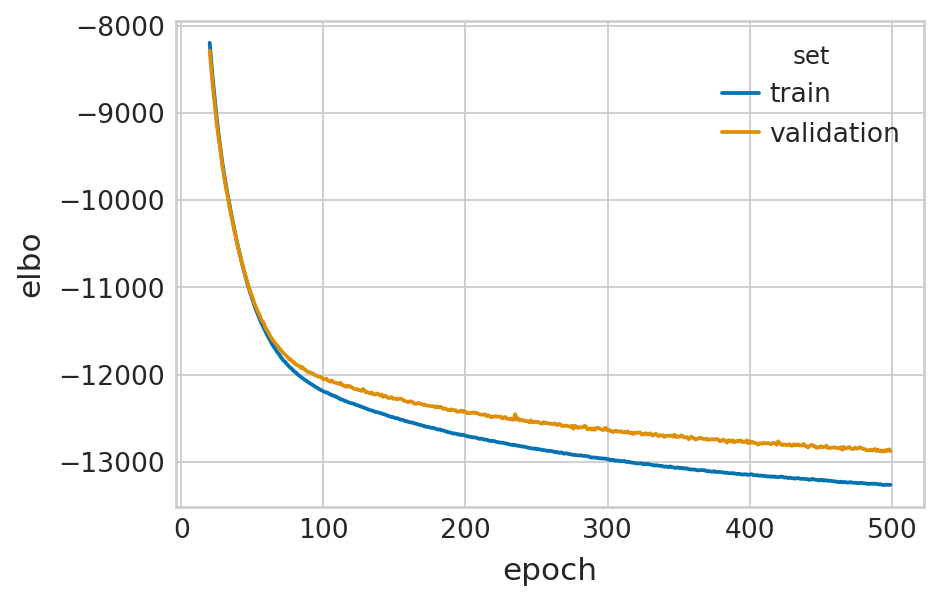

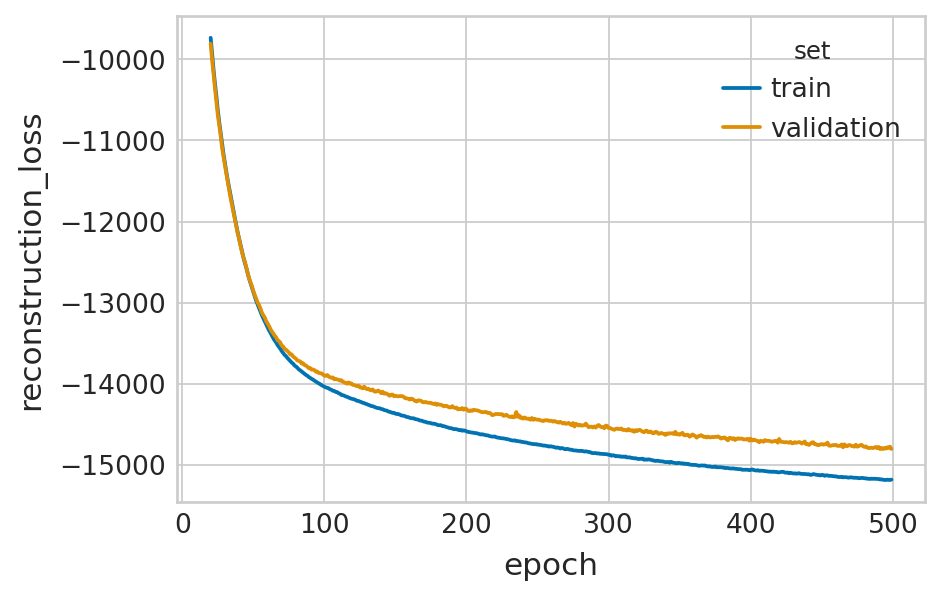

In [10]:
df = vae_sn_sc.history["elbo_train"].iloc[20:].reset_index().rename(columns={"elbo_train": "elbo"})
df["set"] = "train"

_df = vae_sn_sc.history["elbo_validation"].iloc[20:].reset_index().rename(columns={"elbo_validation": "elbo"})
_df["set"] = "validation"

df = pd.concat([df, _df], axis=0).reset_index(drop=True)

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.lineplot(data=df, x="epoch", y="elbo", hue="set", palette=["#0173B2", "#DE8F05"], ax=ax)
    plt.show()

df = (
    vae_sn_sc.history["reconstruction_loss_train"]
    .iloc[20:]
    .reset_index()
    .rename(columns={"reconstruction_loss_train": "reconstruction_loss"})
)
df["set"] = "train"

_df = (
    vae_sn_sc.history["reconstruction_loss_validation"]
    .iloc[20:]
    .reset_index()
    .rename(columns={"reconstruction_loss_validation": "reconstruction_loss"})
)
_df["set"] = "validation"

df = pd.concat([df, _df], axis=0).reset_index(drop=True)

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.lineplot(data=df, x="epoch", y="reconstruction_loss", hue="set", palette=["#0173B2", "#DE8F05"], ax=ax)
    plt.show()

## Fit original veloVI model on scRNA-seq data!

In [11]:
vae_sc, adata_sc = fit_velovi_(adata_sc)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 500/500: 100%|████| 500/500 [06:15<00:00,  1.32it/s, v_num=1, train_loss_step=-1.01e+4, train_loss_epoch=-1.02e+4]

`Trainer.fit` stopped: `max_epochs=500` reached.


Epoch 500/500: 100%|████| 500/500 [06:15<00:00,  1.33it/s, v_num=1, train_loss_step=-1.01e+4, train_loss_epoch=-1.02e+4]


#### Plot losses

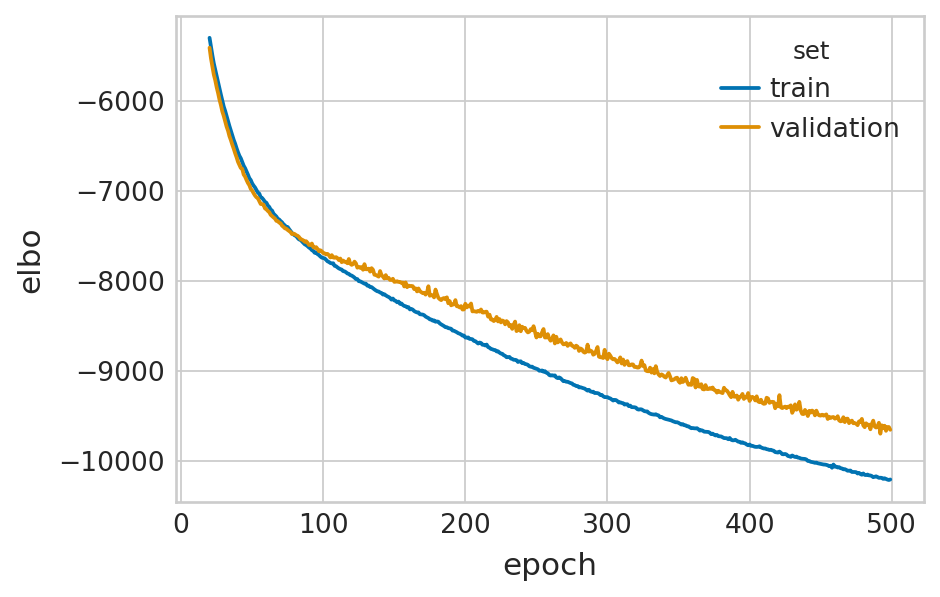

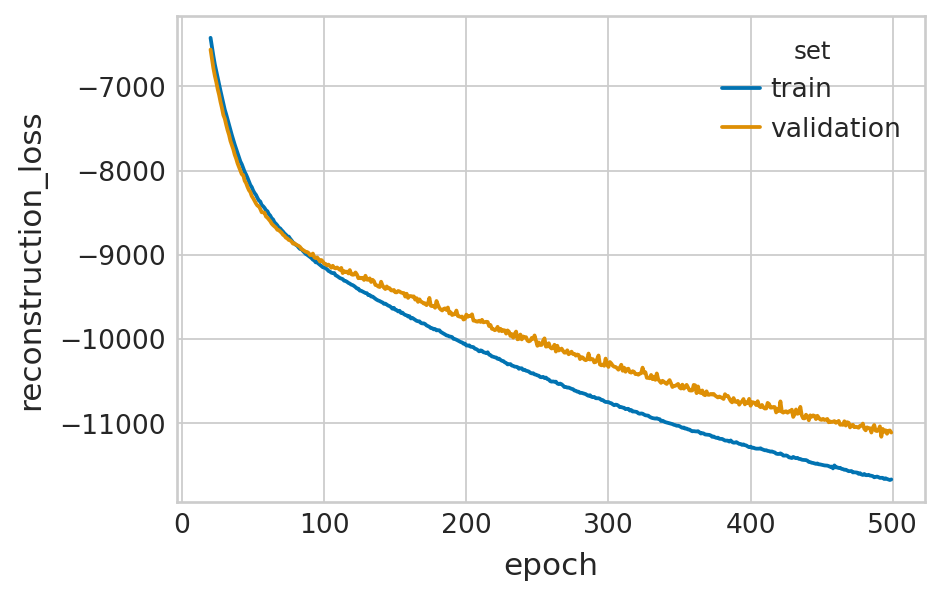

In [12]:
df = vae_sc.history["elbo_train"].iloc[20:].reset_index().rename(columns={"elbo_train": "elbo"})
df["set"] = "train"

_df = vae_sc.history["elbo_validation"].iloc[20:].reset_index().rename(columns={"elbo_validation": "elbo"})
_df["set"] = "validation"

df = pd.concat([df, _df], axis=0).reset_index(drop=True)

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.lineplot(data=df, x="epoch", y="elbo", hue="set", palette=["#0173B2", "#DE8F05"], ax=ax)
    plt.show()

df = (
    vae_sc.history["reconstruction_loss_train"]
    .iloc[20:]
    .reset_index()
    .rename(columns={"reconstruction_loss_train": "reconstruction_loss"})
)
df["set"] = "train"

_df = (
    vae_sc.history["reconstruction_loss_validation"]
    .iloc[20:]
    .reset_index()
    .rename(columns={"reconstruction_loss_validation": "reconstruction_loss"})
)
_df["set"] = "validation"

df = pd.concat([df, _df], axis=0).reset_index(drop=True)

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.lineplot(data=df, x="epoch", y="reconstruction_loss", hue="set", palette=["#0173B2", "#DE8F05"], ax=ax)
    plt.show()

## Fit original veloVI model just on snRNA-seq data

In [13]:
vae_sn, adata_sn = fit_velovi_(adata_sn)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 500/500: 100%|████| 500/500 [07:47<00:00,  1.08it/s, v_num=1, train_loss_step=-6.74e+3, train_loss_epoch=-6.72e+3]

`Trainer.fit` stopped: `max_epochs=500` reached.


Epoch 500/500: 100%|████| 500/500 [07:47<00:00,  1.07it/s, v_num=1, train_loss_step=-6.74e+3, train_loss_epoch=-6.72e+3]


#### Plot losses

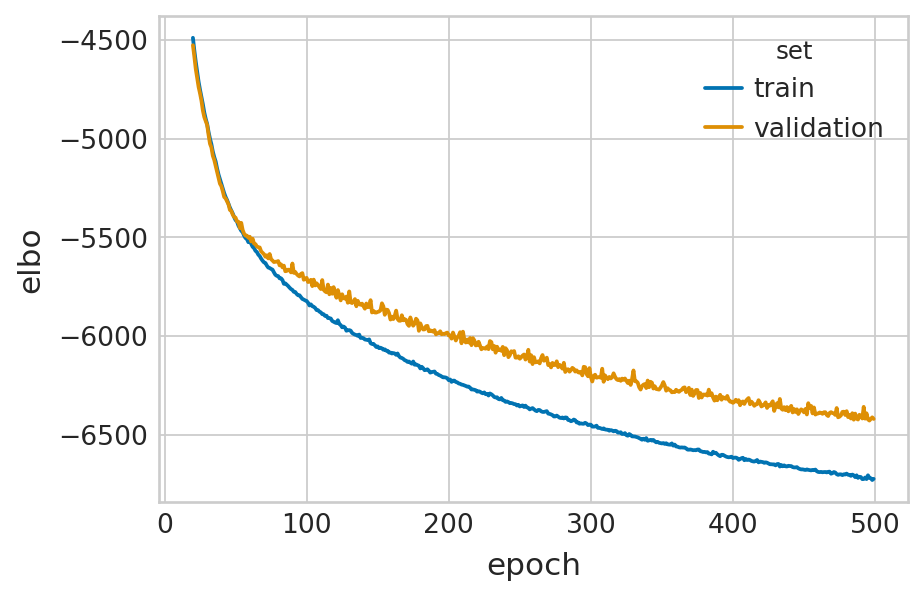

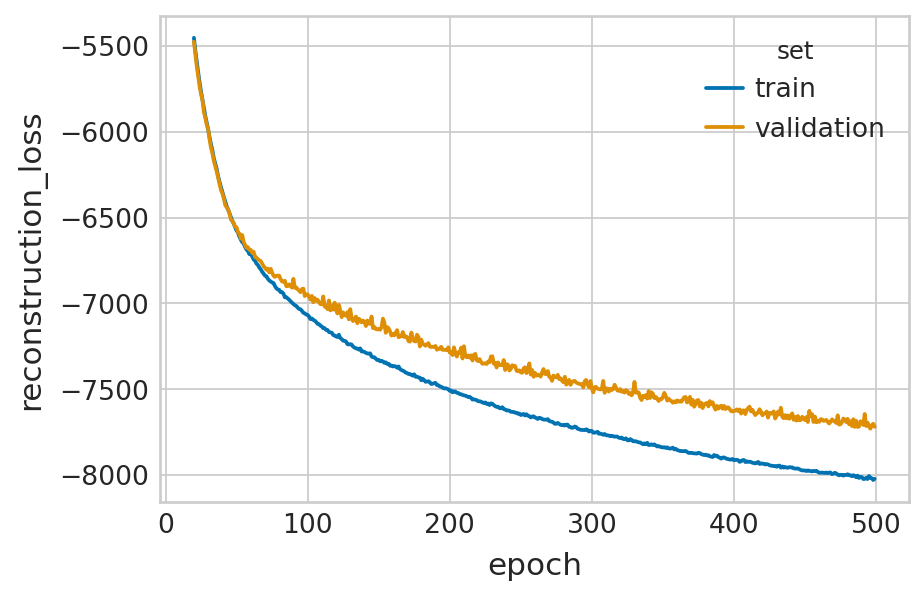

In [14]:
df = vae_sn.history["elbo_train"].iloc[20:].reset_index().rename(columns={"elbo_train": "elbo"})
df["set"] = "train"

_df = vae_sn.history["elbo_validation"].iloc[20:].reset_index().rename(columns={"elbo_validation": "elbo"})
_df["set"] = "validation"

df = pd.concat([df, _df], axis=0).reset_index(drop=True)

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.lineplot(data=df, x="epoch", y="elbo", hue="set", palette=["#0173B2", "#DE8F05"], ax=ax)
    plt.show()

df = (
    vae_sn.history["reconstruction_loss_train"]
    .iloc[20:]
    .reset_index()
    .rename(columns={"reconstruction_loss_train": "reconstruction_loss"})
)
df["set"] = "train"

_df = (
    vae_sn.history["reconstruction_loss_validation"]
    .iloc[20:]
    .reset_index()
    .rename(columns={"reconstruction_loss_validation": "reconstruction_loss"})
)
_df["set"] = "validation"

df = pd.concat([df, _df], axis=0).reset_index(drop=True)

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(6, 4))
    sns.lineplot(data=df, x="epoch", y="reconstruction_loss", hue="set", palette=["#0173B2", "#DE8F05"], ax=ax)
    plt.show()

## Get permutation scores
We use permutation scores to compare the different models on cell-cycle genes

In [15]:
perm_scores, permuted_adata = vae_sn_sc.get_permutation_scores(labels_key="celltype")
perm_scores_sc, permuted_adata_sc = vae_sc.get_permutation_scores(labels_key="celltype")
perm_scores_sn, permuted_adata_sn = vae_sn.get_permutation_scores(labels_key="celltype")

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             


In [16]:
# Define colors for celltype and cell cycle phases
adata.uns["celltype_colors"] = celltype_colors
adata_sc.uns["celltype_colors"] = celltype_colors
adata_sn.uns["celltype_colors"] = celltype_colors

adata_sc.uns["phase_colors"] = phase_colors
adata.uns["phase_colors"] = phase_colors
adata_sn.uns["phase_colors"] = phase_colors

In [20]:
def compute_confidence(adata, vkey="velocities_velovi"):
    """Computes the velocity confidence of model.

    Parameters
    ----------
    adata
        Annotated data
    vkey
        adata.layers[vkey] should contain inferred velocities
    """
    # scv.tl.velocity_graph(adata, vkey=vkey, n_jobs=8)
    scv.tl.velocity_confidence(adata, vkey=vkey)

    g_df = pd.DataFrame()
    g_df["Velocity confidence"] = adata.obs[f"{vkey}_confidence"].to_numpy().ravel()

    return g_df

## Calculate velocities for all velo modes

In [17]:
velocities = vae_sn_sc.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="spliced_cyt")
adata.layers["velocities_velovi_s_cyt"] = velocities
velocities = vae_sn_sc.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="spliced_nuc")
adata.layers["velocities_velovi_s_nuc"] = velocities
velocities = vae_sn_sc.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="spliced_sum")
adata.layers["velocities_velovi_s_sum"] = velocities
velocities = vae_sn_sc.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="unspliced_nuc")
adata.layers["velocities_velovi_u_nuc"] = velocities

velocities = vae_sc.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="spliced")
adata_sc.layers["velocities_velovi"] = velocities
velocities = vae_sc.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="unspliced")
adata_sc.layers["velocities_velovi_u"] = velocities


velocities = vae_sn.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="spliced")
adata_sn.layers["velocities_velovi"] = velocities
velocities = vae_sn.get_velocity(n_samples=25, velo_statistic="mean", velo_mode="unspliced")
adata_sn.layers["velocities_velovi_u"] = velocities

## Velocity graph

In [18]:
adata.layers["Ms_sum"] = adata.layers["Ms_nuc"] + adata.layers["Ms_cyt"]
scv.tl.velocity_graph(adata, vkey="velocities_velovi_s_cyt", n_jobs=3, xkey="Ms_cyt")
scv.tl.velocity_graph(adata, vkey="velocities_velovi_s_nuc", n_jobs=3, xkey="Ms_nuc")
scv.tl.velocity_graph(adata, vkey="velocities_velovi_s_sum", n_jobs=3, xkey="Ms_sum")
scv.tl.velocity_graph(adata_sc, vkey="velocities_velovi", n_jobs=3)
scv.tl.velocity_graph(adata_sn, vkey="velocities_velovi", n_jobs=3)

computing velocity graph (using 3/14 cores)


  0%|          | 0/13139 [00:00<?, ?cells/s]

/vol/storage/miniconda3/envs/conda_env_robin/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/vol/storage/miniconda3/envs/conda_env_robin/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/vol/storage/miniconda3/envs/conda_env_robin/lib/pyt

    finished (0:02:29) --> added 
    'velocities_velovi_s_cyt_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity graph (using 3/14 cores)


  0%|          | 0/13139 [00:00<?, ?cells/s]

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



    finished (0:02:30) --> added 
    'velocities_velovi_s_nuc_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity graph (using 3/14 cores)


  0%|          | 0/13139 [00:00<?, ?cells/s]

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



    finished (0:02:20) --> added 
    'velocities_velovi_s_sum_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity graph (using 3/14 cores)


  0%|          | 0/5934 [00:00<?, ?cells/s]

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



    finished (0:00:51) --> added 
    'velocities_velovi_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity graph (using 3/14 cores)


  0%|          | 0/7212 [00:00<?, ?cells/s]

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



    finished (0:01:07) --> added 
    'velocities_velovi_graph', sparse matrix with cosine correlations (adata.uns)


## Calculation of S- and G2M scores
`scv.tl.score_genes_cell_cycle()` also assigns a phase to each cell. This is done by considering `adata.X` - but as `adata.X` for our multimodal AnnData objects (e.g. adata, adata_integrated) are on different scales per protocol, we will validate just on scRNA and snRNA AnnDatas respectivley and add this information to integrated AnnDatas.

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


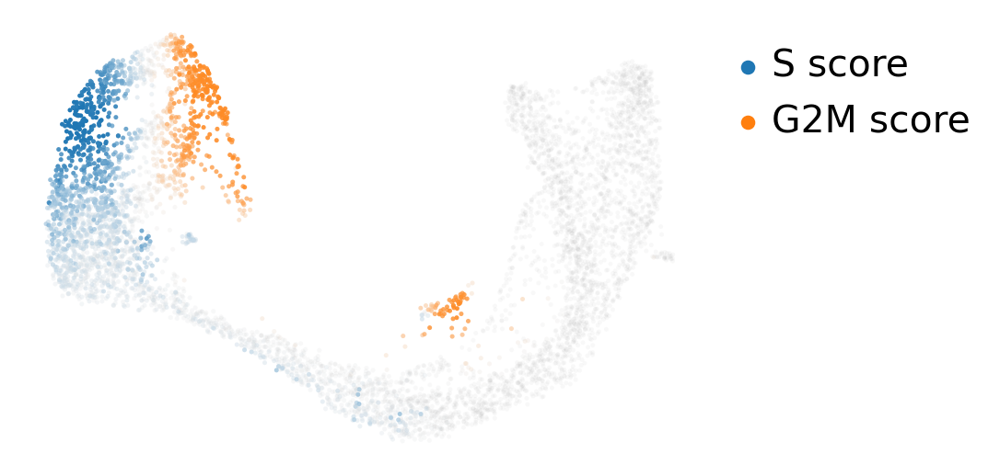

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


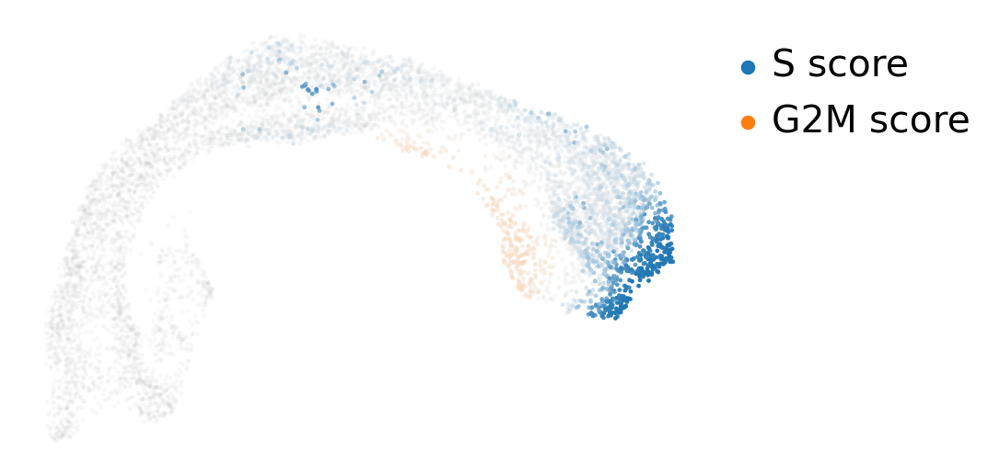

In [19]:
scv.tl.score_genes_cell_cycle(adata_sc)
scv.pl.scatter(adata_sc, color_gradients=["S_score", "G2M_score"], smooth=True, perc=[5, 95])
scv.tl.score_genes_cell_cycle(adata_sn)
scv.pl.scatter(adata_sn, color_gradients=["S_score", "G2M_score"], smooth=True, perc=[5, 95])


# get common cell names
sc_cells = list(set(adata_sc.obs_names).intersection(set(adata.obs_names)))
sn_cells = list(set(adata_sn.obs_names).intersection(set(adata.obs_names)))

# add 'S_score' and 'G2M_score' and 'phase'
adata.obs["S_score"] = 0
adata.obs["G2M_score"] = 0
adata.obs["phase"] = "XY"
# add sc data
adata.obs.loc[sc_cells, "S_score"] = adata_sc.obs.loc[sc_cells, "S_score"]
adata.obs.loc[sc_cells, "G2M_score"] = adata_sc.obs.loc[sc_cells, "G2M_score"]
adata.obs.loc[sc_cells, "phase"] = adata_sc.obs.loc[sc_cells, "phase"]
# add sn data
adata.obs.loc[sn_cells, "S_score"] = adata_sn.obs.loc[sn_cells, "S_score"]
adata.obs.loc[sn_cells, "G2M_score"] = adata_sn.obs.loc[sn_cells, "G2M_score"]
adata.obs.loc[sn_cells, "phase"] = adata_sn.obs.loc[sn_cells, "phase"]

## Plot s-score, g2m scores for all cells contained in `adata`

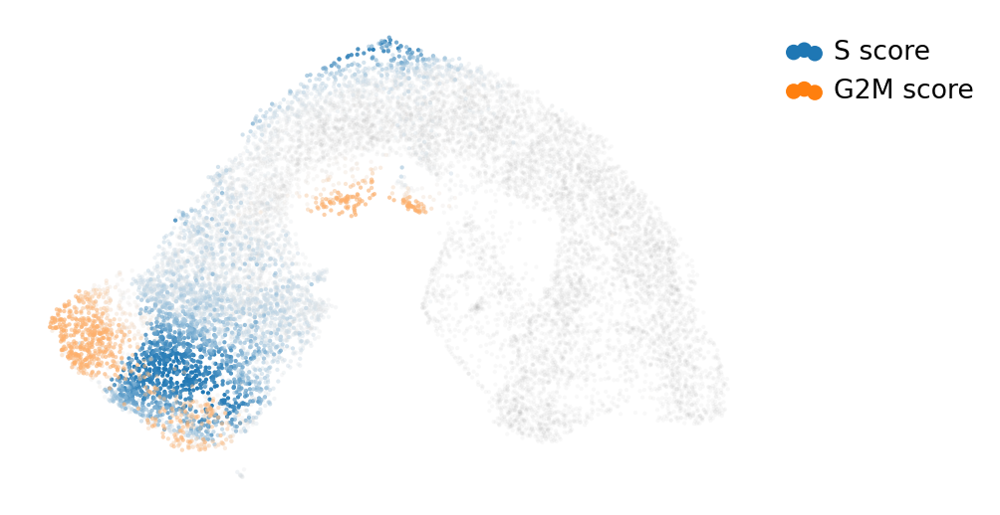

In [40]:
with mplscience.style_context():
    fig, ax = plt.subplots(figsize=(6, 4))
    scv.pl.scatter(adata, color_gradients=["S_score", "G2M_score"], smooth=True, perc=[5, 95], ax=ax)
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "g2m_s_score_umap.svg", format="svg", transparent=True, bbox_inches="tight")

## Plot Velo Embedding for all 4 models

computing velocity embedding
    finished (0:00:02) --> added
    'velocities_velovi_s_nuc_umap', embedded velocity vectors (adata.obsm)


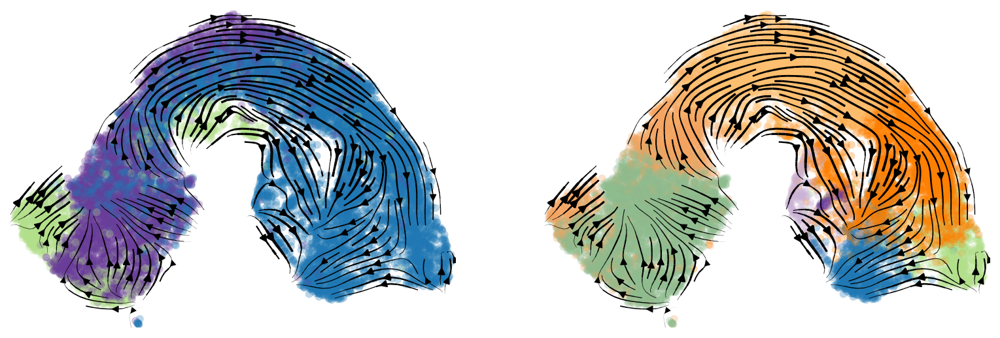

In [20]:
scv.pl.velocity_embedding_stream(
    adata, vkey="velocities_velovi_s_nuc", color=["phase", "celltype"], cmap="viridis", legend_loc=False, title=""
)
plt.show()

computing velocity embedding
    finished (0:00:02) --> added
    'velocities_velovi_s_cyt_umap', embedded velocity vectors (adata.obsm)


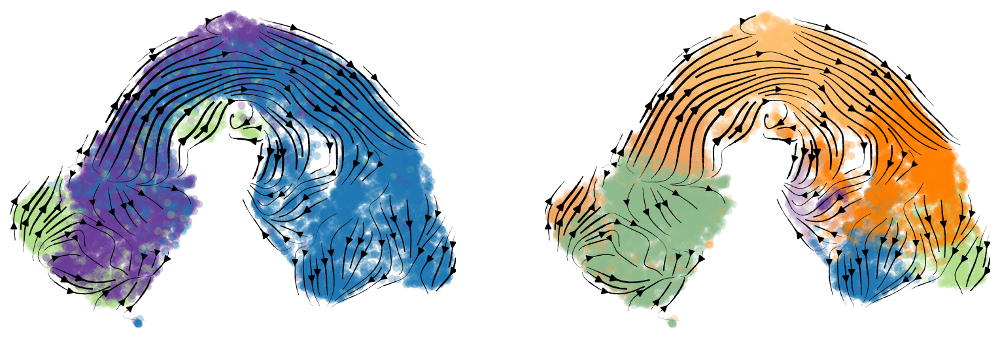

In [21]:
scv.pl.velocity_embedding_stream(
    adata, vkey="velocities_velovi_s_cyt", color=["phase", "celltype"], cmap="viridis", legend_loc=False, title=""
)
plt.show()

computing velocity embedding
    finished (0:00:02) --> added
    'velocities_velovi_s_sum_umap', embedded velocity vectors (adata.obsm)


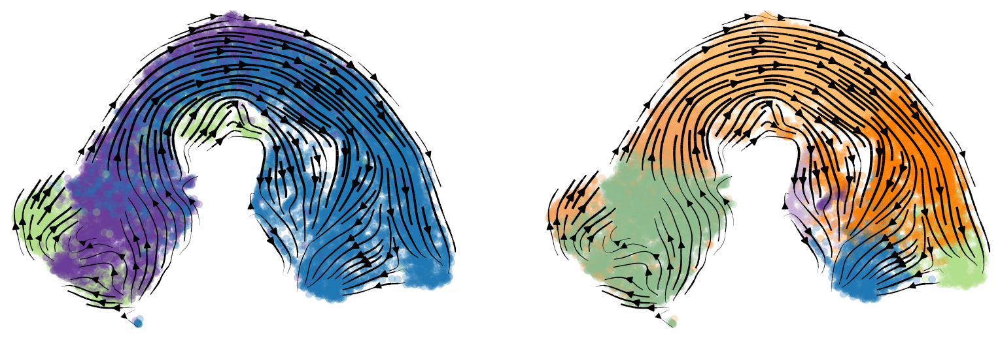

In [22]:
scv.pl.velocity_embedding_stream(
    adata, vkey="velocities_velovi_s_sum", color=["phase", "celltype"], cmap="viridis", legend_loc=False, title=""
)
plt.show()

## sc embeddings

computing velocity embedding
    finished (0:00:01) --> added
    'velocities_velovi_umap', embedded velocity vectors (adata.obsm)


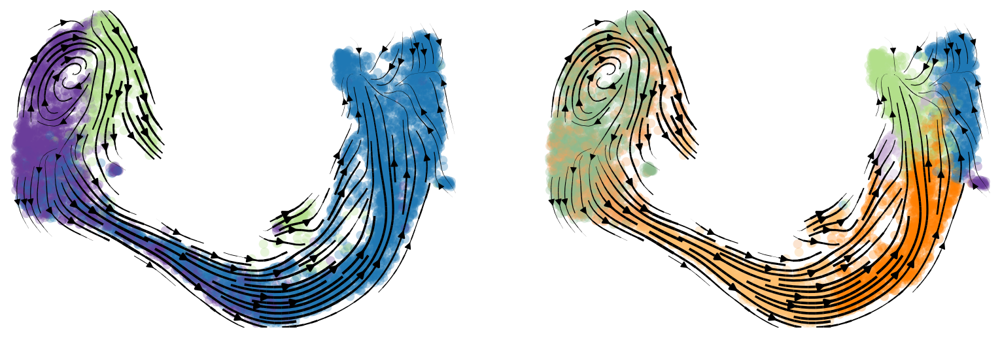

In [23]:
scv.tl.umap(adata_sc)
scv.pl.velocity_embedding_stream(
    adata_sc, vkey="velocities_velovi", color=["phase", "celltype"], cmap="viridis", legend_loc=False, title=""
)
plt.show()

## sn embeddings

computing velocity embedding
    finished (0:00:01) --> added
    'velocities_velovi_umap', embedded velocity vectors (adata.obsm)


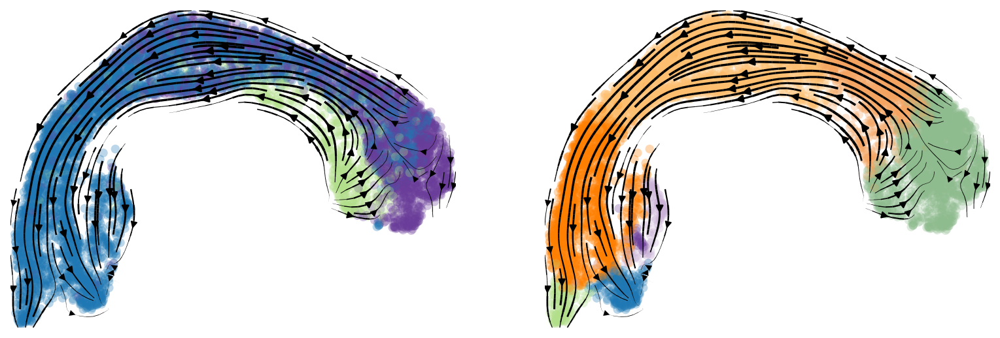

In [24]:
scv.tl.umap(adata_sn)
scv.pl.velocity_embedding_stream(
    adata_sn, vkey="velocities_velovi", color=["phase", "celltype"], cmap="viridis", legend_loc=False, title=""
)
plt.show()

## Now we want to investigate cell-cycle genes
As a first step we get cell-cycle genes found in all adatas, as defined in Tirosh et al, 2015 (https://doi.org/10.1126/science.aad0501)

In [26]:
# Again some functions require Mu and Ms to be present, which we flexibly set by our needs
adata.layers["Mu"] = adata.layers["Mu_nuc"]
adata.layers["Ms"] = adata.layers["Ms_nuc"]

In [27]:
s_genes_sn_sc, g2m_genes_sn_sc = scv.utils.get_phase_marker_genes(adata)
s_genes_sn, g2m_genes_sn = scv.utils.get_phase_marker_genes(adata_sn)
s_genes_sc, g2m_genes_sc = scv.utils.get_phase_marker_genes(adata_sc)

g2m_all = list(
    set(g2m_genes_sn_sc).intersection(g2m_genes_sn).intersection(g2m_genes_sc)
)  # .intersection(g2m_genes_integrated))
s_genes_all = list(
    set(s_genes_sn_sc).intersection(s_genes_sn).intersection(s_genes_sc)
)  # .intersection(s_genes_integrated))

#### 1. Plot phase portraits of all models colored by cell-cycle phase
One conclusion is that velocity on snRNA data doesn't work as well as on scRNA data as the phase portraits are not as "complete" as for the other models

In [28]:
# define velocities_velovi_s_nuc_u, velocities_velovi_s_cyt_u for plotting purposes
adata.layers["velocities_velovi_s_cyt_u"] = adata.layers["velocities_velovi_u_nuc"].copy()
adata.layers["velocities_velovi_s_nuc_u"] = adata.layers["velocities_velovi_u_nuc"].copy()

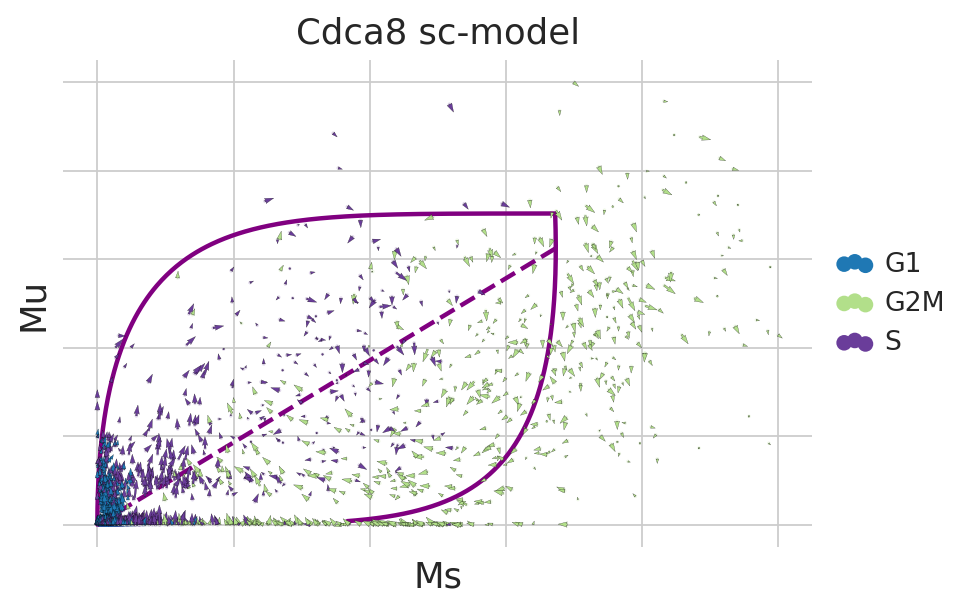

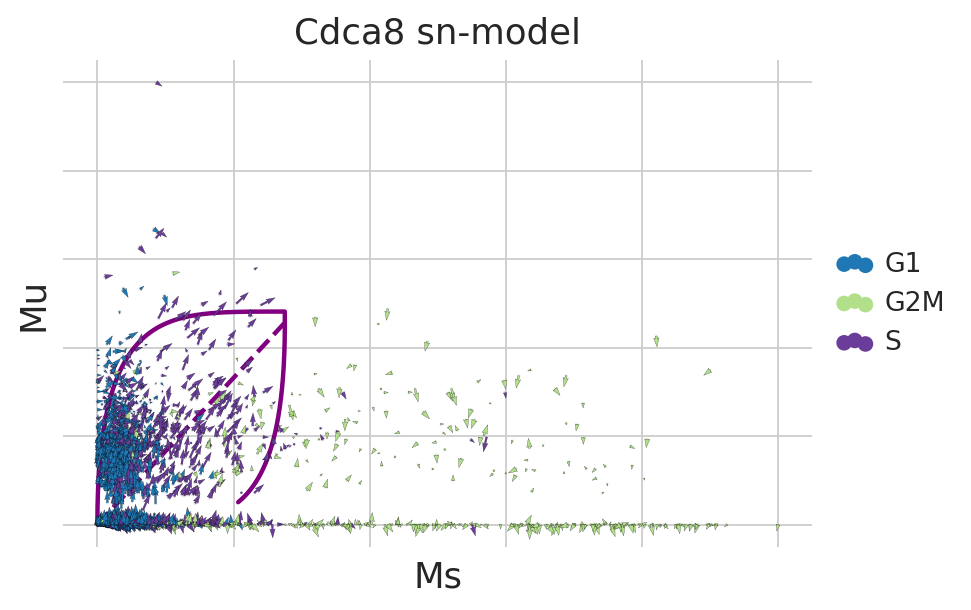

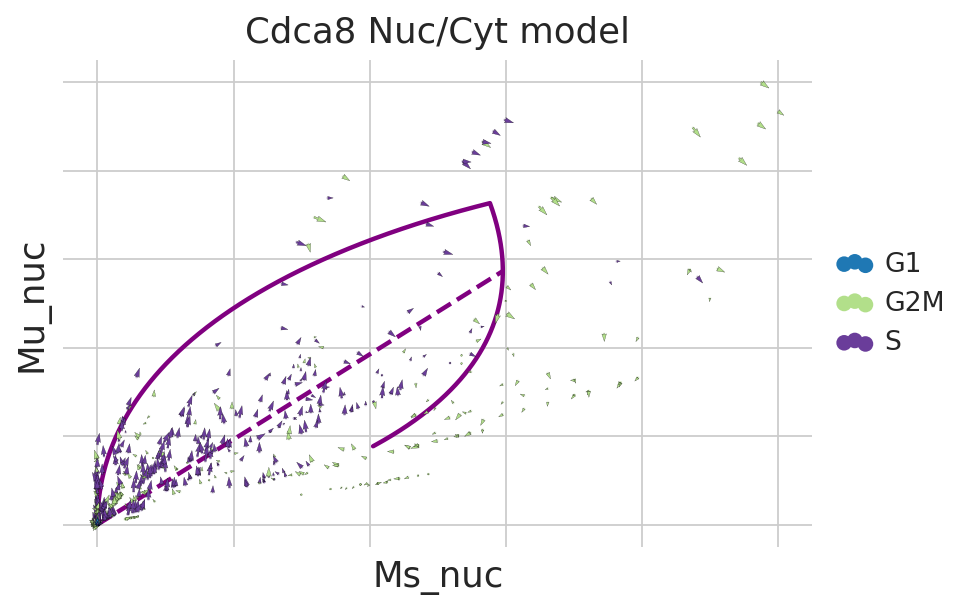

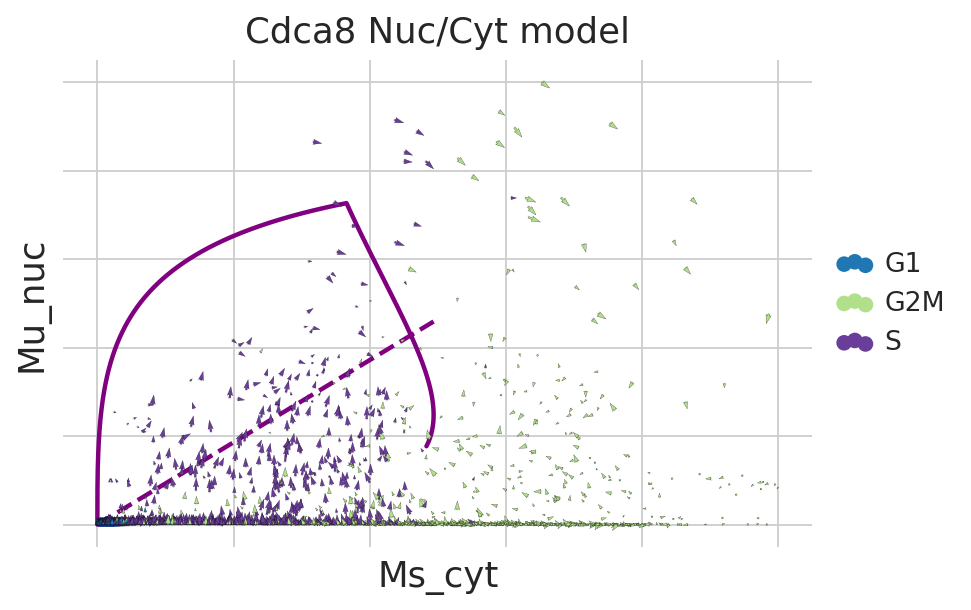

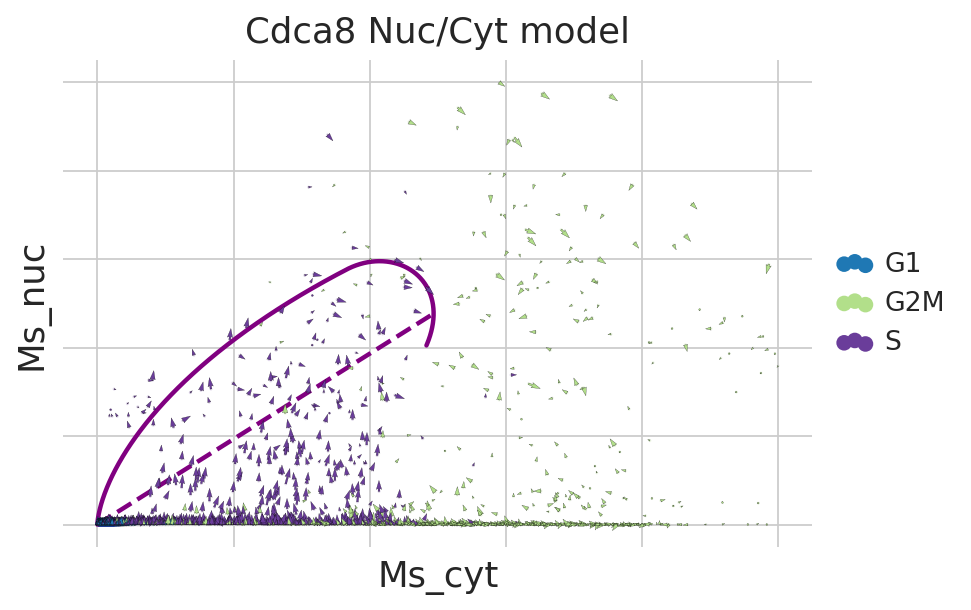

...

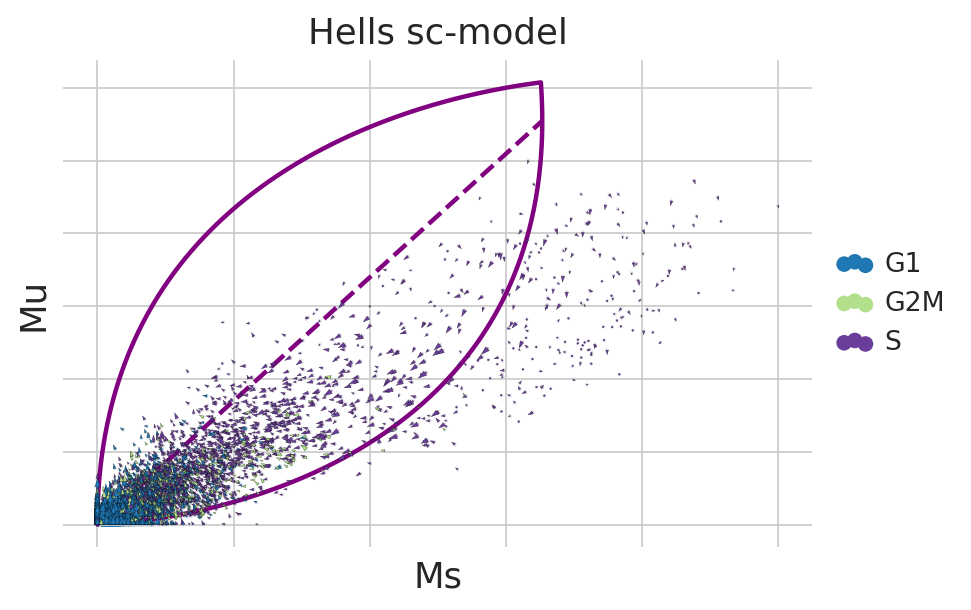

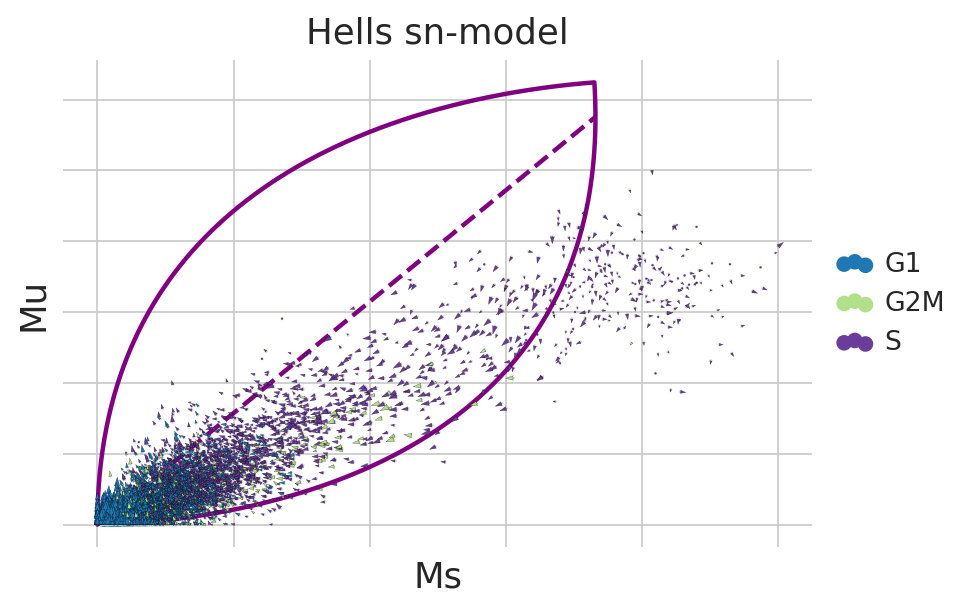

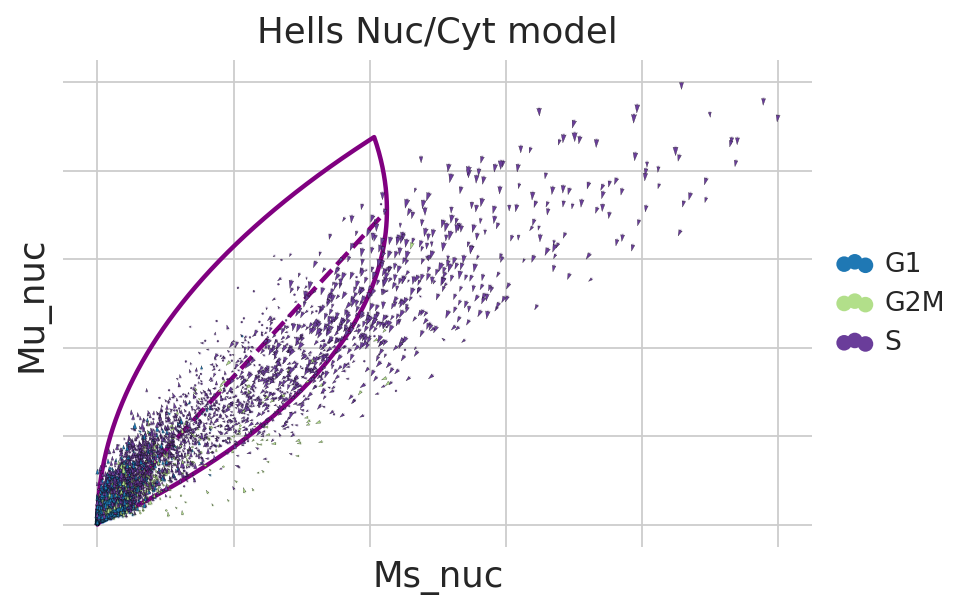

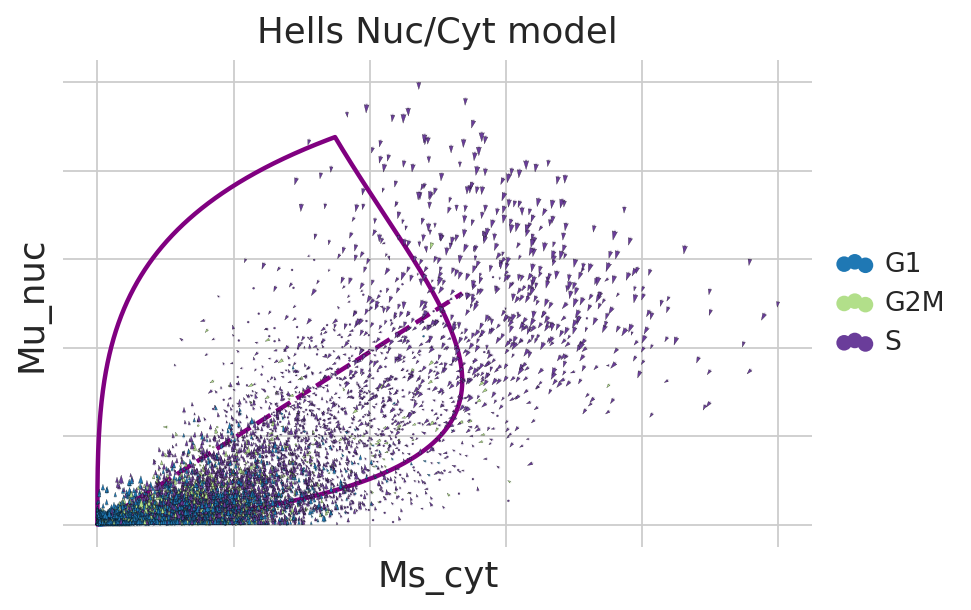

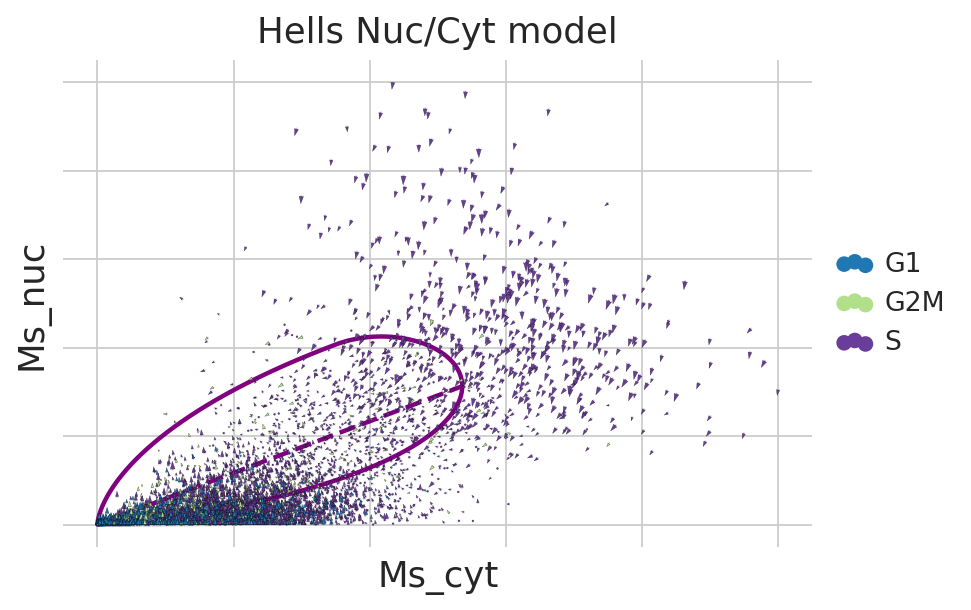

In [29]:
for gene in g2m_all + s_genes_all:
    # scRNA data
    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))

        ax = scv.pl.velocity_embedding(
            adata_sc,
            vkey="velocities_velovi",
            basis=gene,
            fontsize=16,
            frameon=False,
            color="phase",
            legend_loc="right margin",
            show=False,
            title=f"{gene} sc-model",
            ax=ax,
        )
        plot_dynamics_(adata_sc, gene, "purple", ax)
        ax.set_xlabel("Ms")
        ax.set_ylabel("Mu")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"{gene}_sc.svg", format="svg", transparent=True, bbox_inches="tight")

    # snRNA data
    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))

        ax = scv.pl.velocity_embedding(
            adata_sn,
            vkey="velocities_velovi",
            basis=gene,
            fontsize=16,
            frameon=False,
            color="phase",
            legend_loc="right margin",
            show=False,
            title=f"{gene} sn-model",
            ax=ax,
        )
        plot_dynamics_(adata_sn, gene, "purple", ax)
        ax.set_xlabel("Ms")
        ax.set_ylabel("Mu")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"{gene}_sn.svg", format="svg", transparent=True, bbox_inches="tight")

    # Nuc cyt model
    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))

        adata.layers["Mu"] = adata.layers["Mu_nuc"]
        adata.layers["Ms"] = adata.layers["Ms_nuc"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_nuc",
            basis=gene,
            fontsize=16,
            frameon=False,
            color="phase",
            legend_loc="right margin",
            show=False,
            title=f"{gene} Nuc/Cyt model",
            ax=ax,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_nuc", "Mu_nuc")
        ax.set_xlabel("Ms_nuc")
        ax.set_ylabel("Mu_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"{gene}_u_nuc_s_nuc.svg", format="svg", transparent=True, bbox_inches="tight")

    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))

        adata.layers["Mu"] = adata.layers["Mu_nuc"]
        adata.layers["Ms"] = adata.layers["Ms_cyt"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_nuc",
            basis=gene,
            fontsize=16,
            frameon=False,
            color="phase",
            legend_loc="right margin",
            show=False,
            title=f"{gene} Nuc/Cyt model",
            ax=ax,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_cyt", "Mu_nuc")
        ax.set_xlabel("Ms_cyt")
        ax.set_ylabel("Mu_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"{gene}_u_nuc_s_cyt.svg", format="svg", transparent=True, bbox_inches="tight")

    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))

        adata.layers["Mu"] = adata.layers["Ms_nuc"]
        adata.layers["Ms"] = adata.layers["Ms_cyt"]
        ax = scv.pl.velocity_embedding(
            adata,
            vkey="velocities_velovi_s_nuc",
            basis=gene,
            fontsize=16,
            frameon=False,
            color="phase",
            legend_loc="right margin",
            show=False,
            title=f"{gene} Nuc/Cyt model",
            ax=ax,
        )
        scv.pl.plot_nuc_cyt_dynamics(adata, gene, "purple", ax, "Ms_cyt", "Ms_nuc")
        ax.set_xlabel("Ms_cyt")
        ax.set_ylabel("Ms_nuc")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"{gene}_s_nuc_s_cyt.svg", format="svg", transparent=True, bbox_inches="tight")

## Plot sc vs. sn benchmark (colored by cell cycle phase)

Cdca8


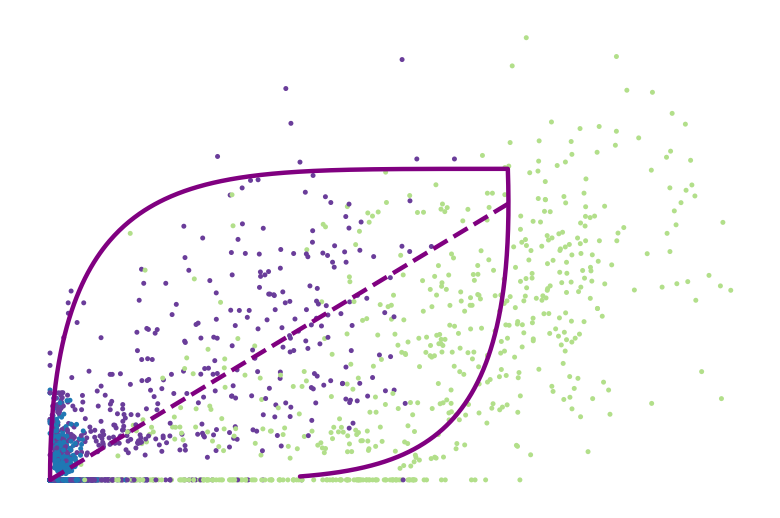

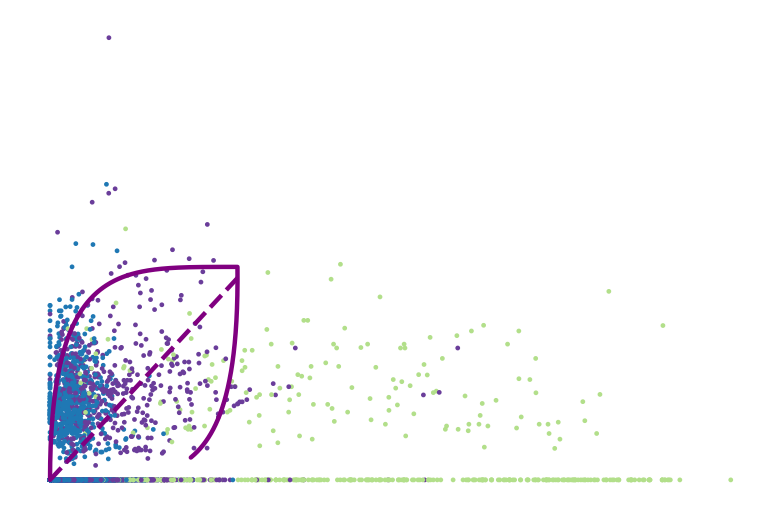

Cenpa


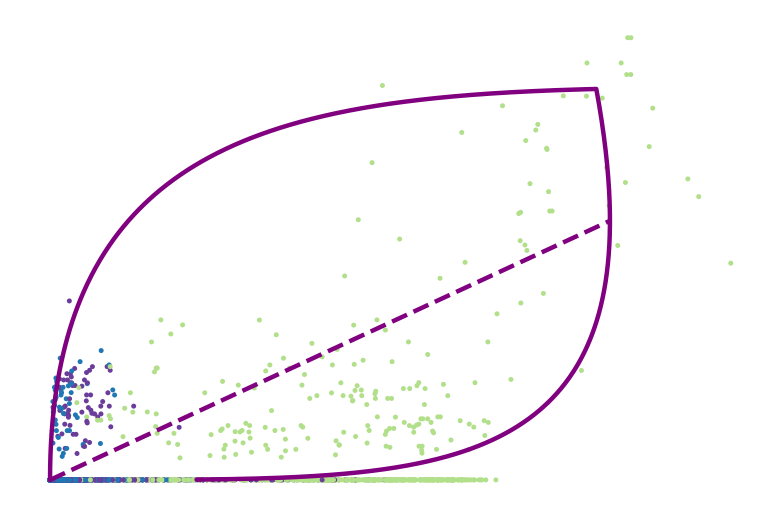

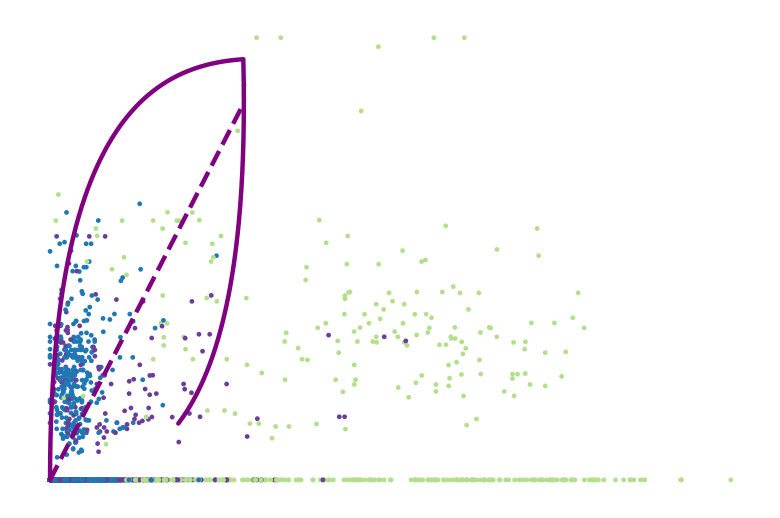

Ube2c


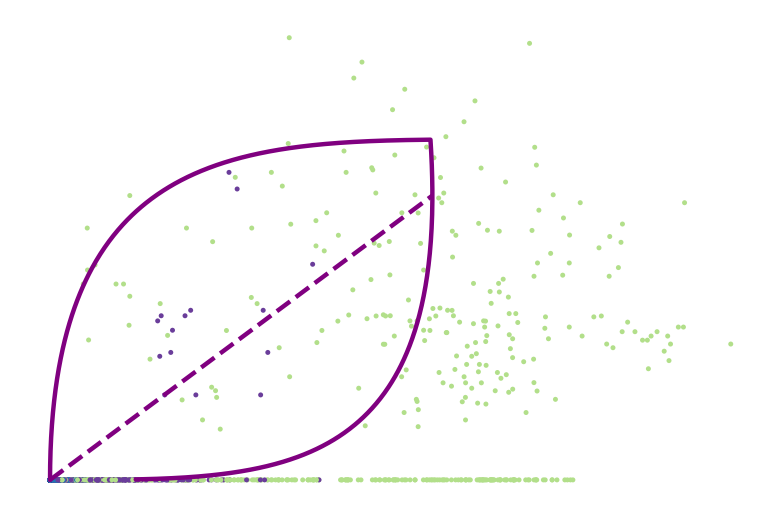

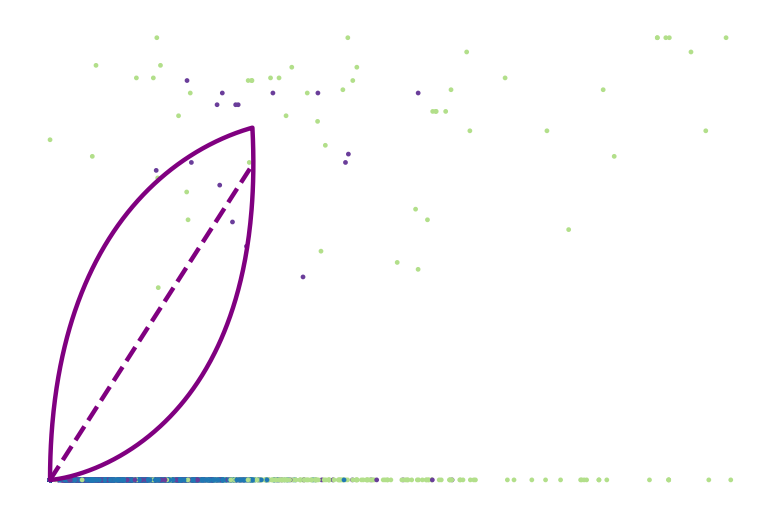

Cenpf


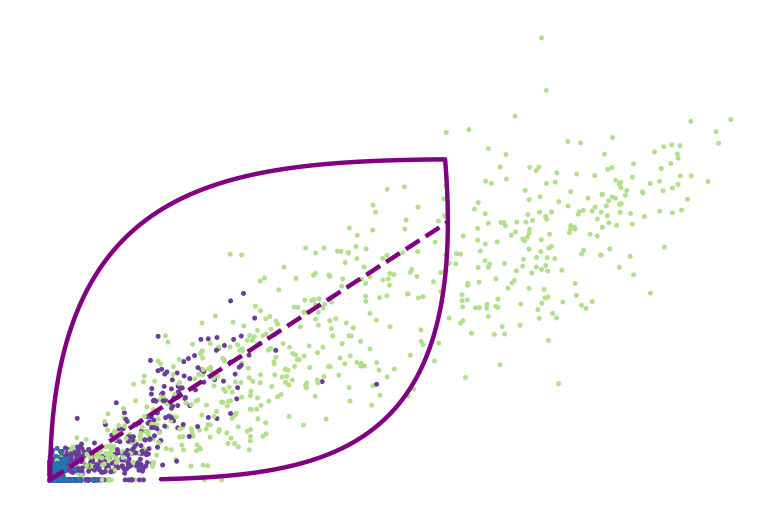

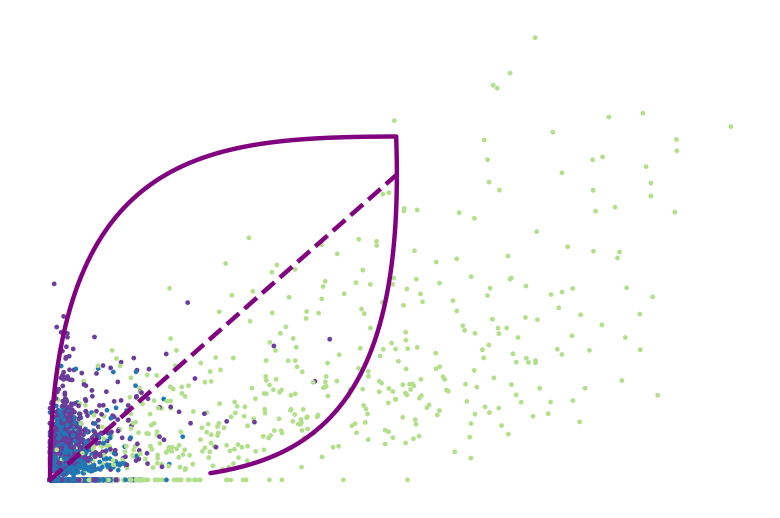

Cdc20


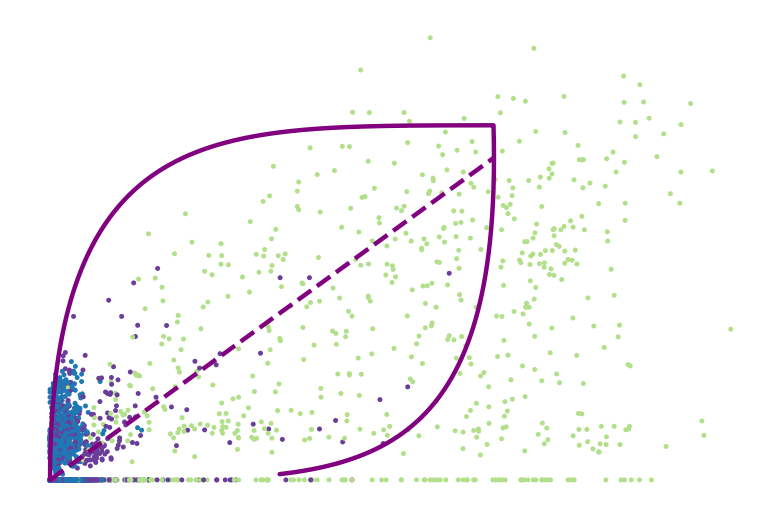

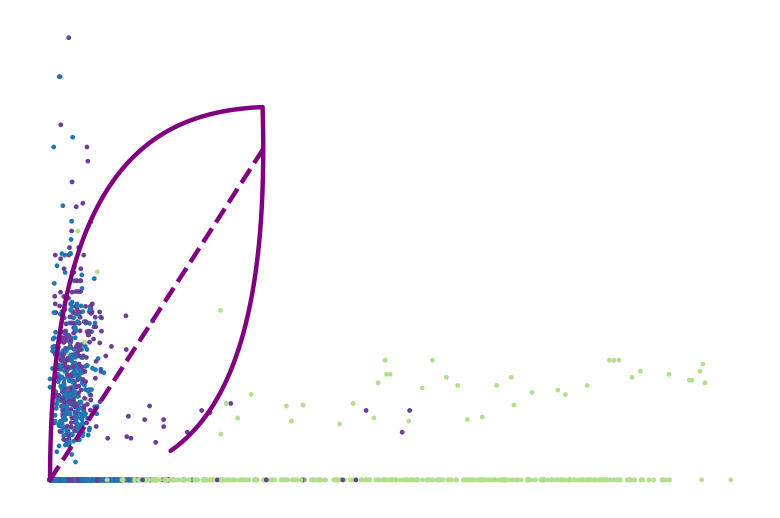

Cenpe


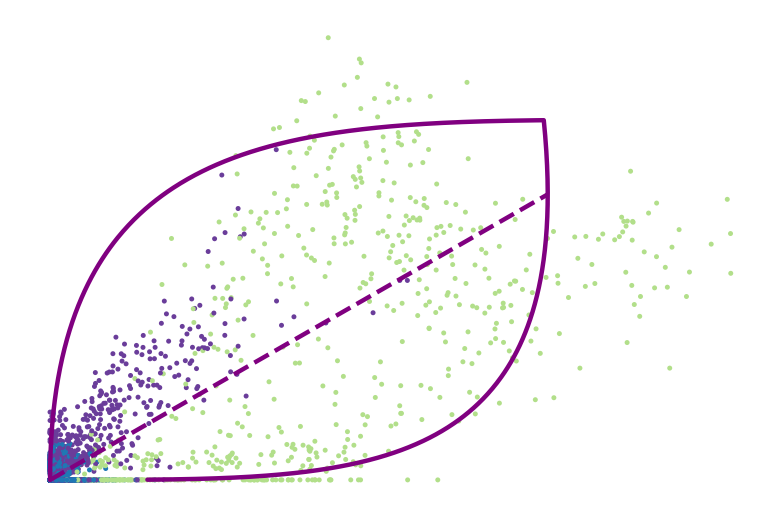

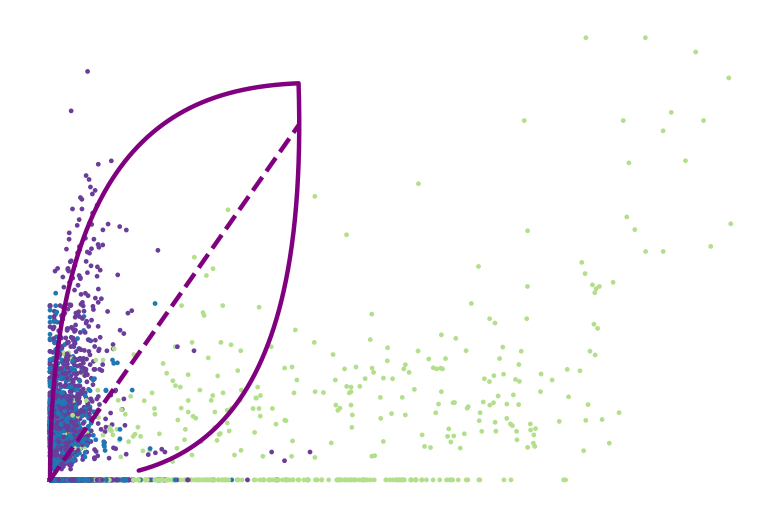

Tpx2


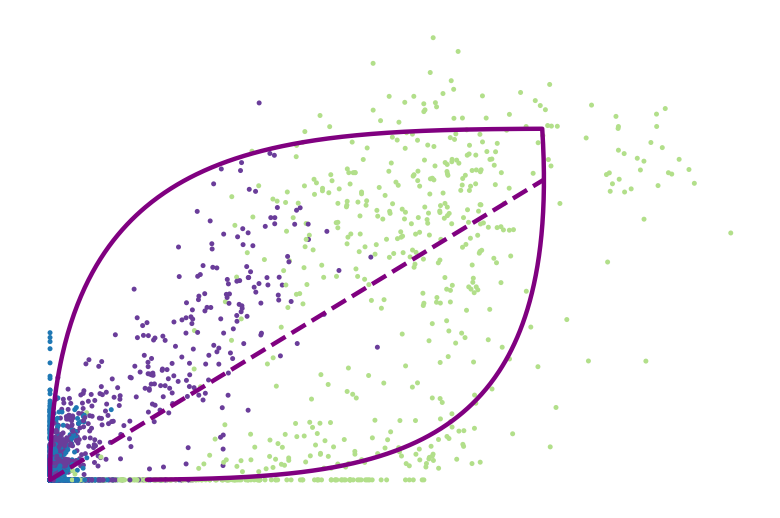

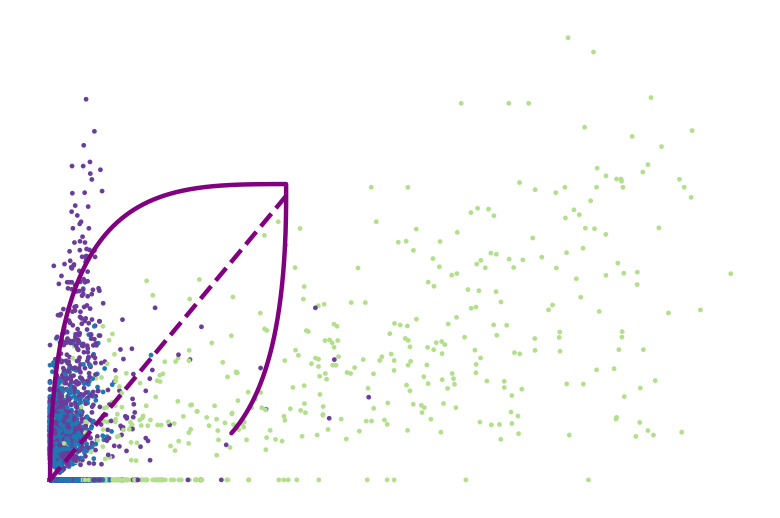

Kif23


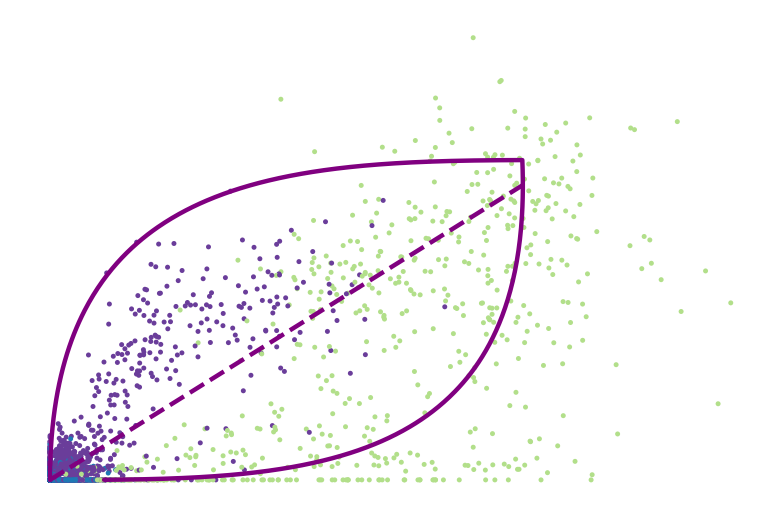

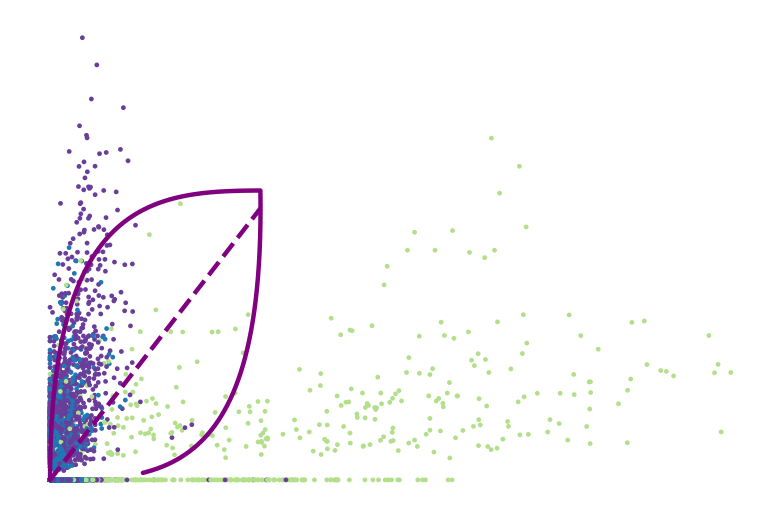

Hmgb2


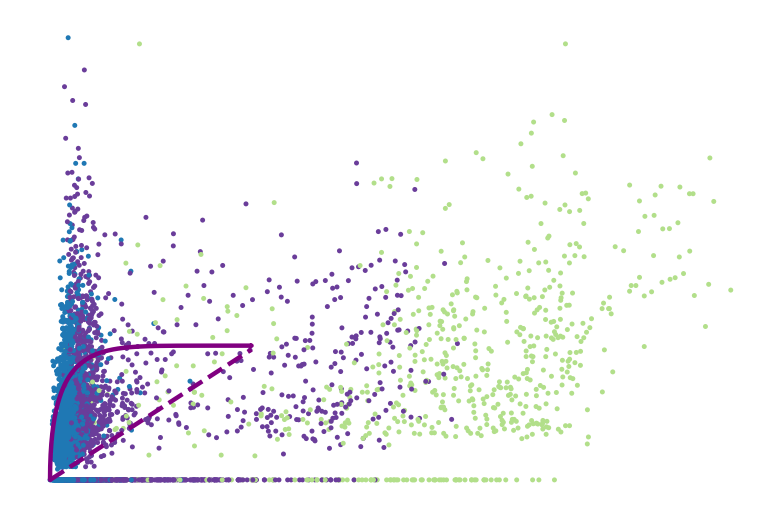

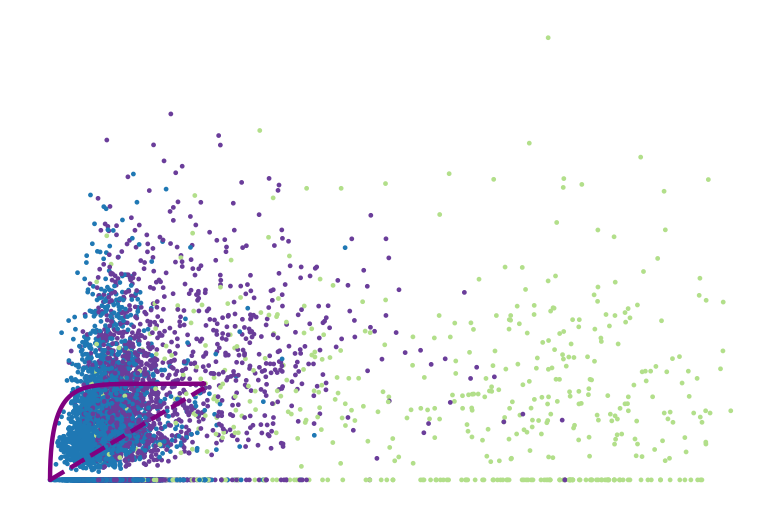

Kif2c


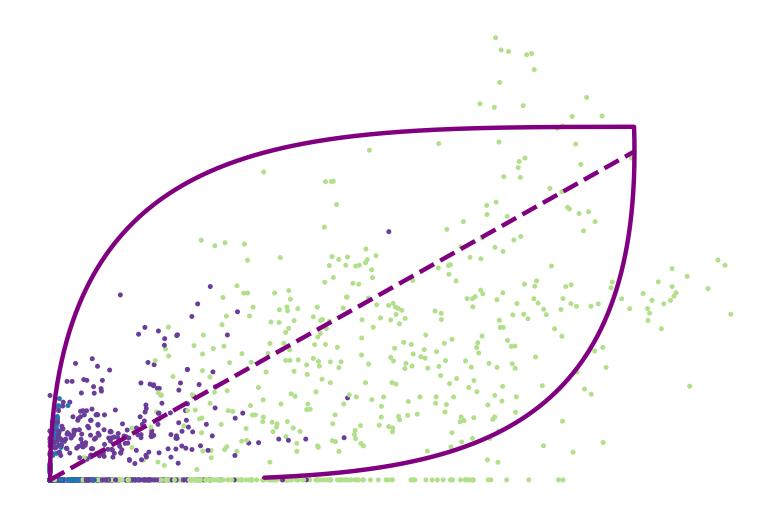

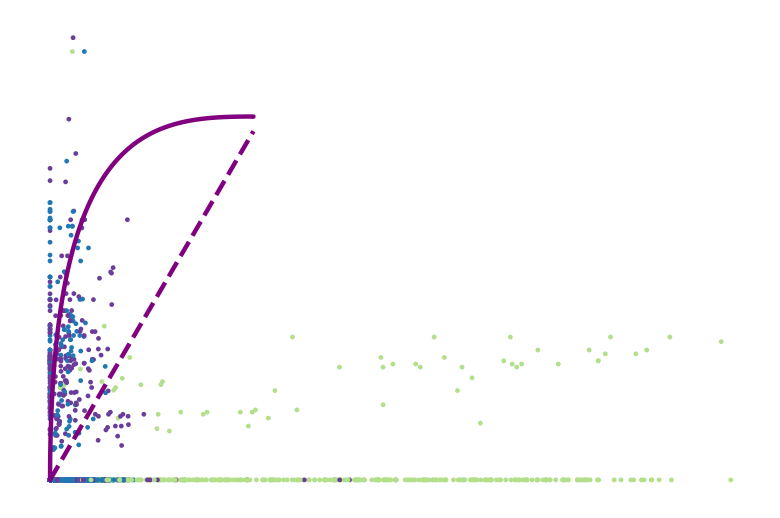

Cdk1


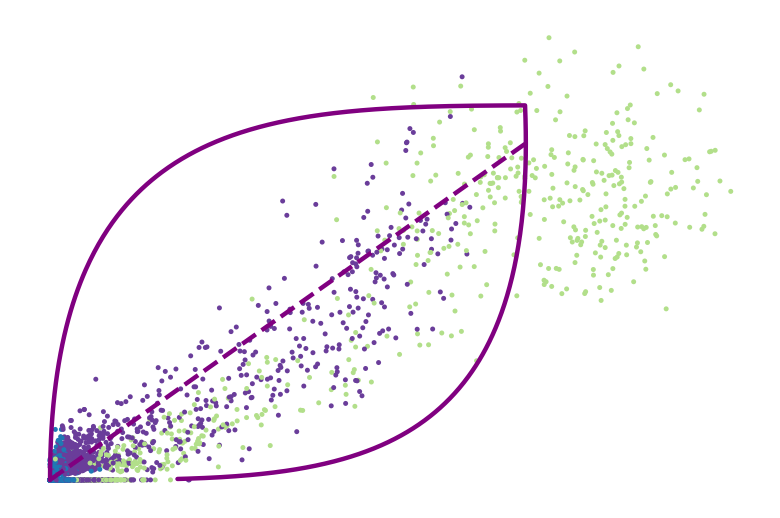

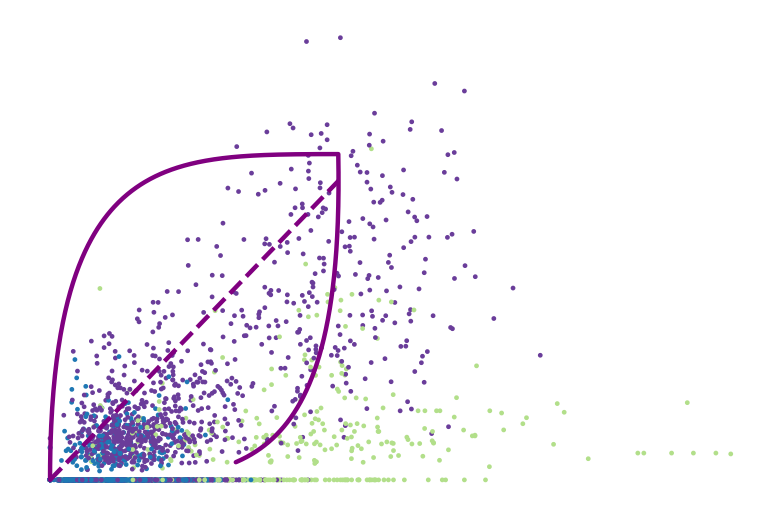

Smc4


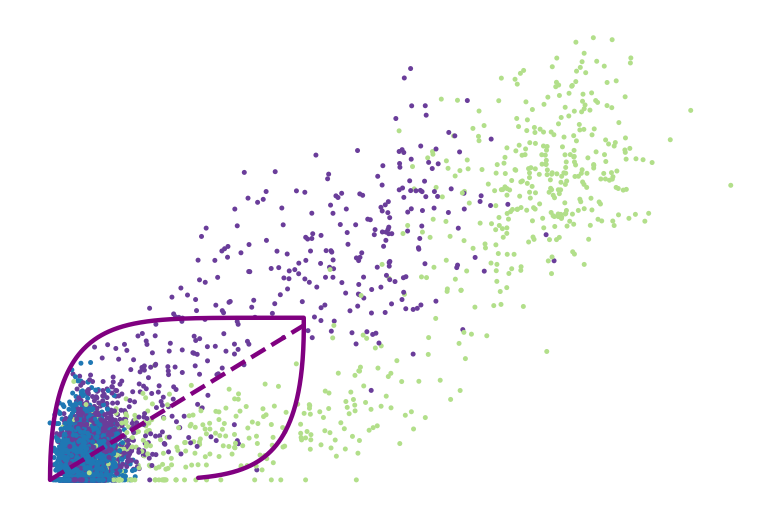

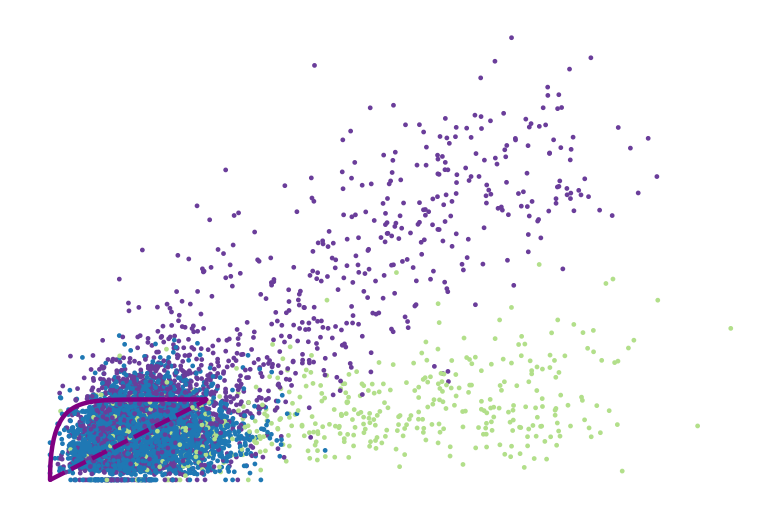

Birc5


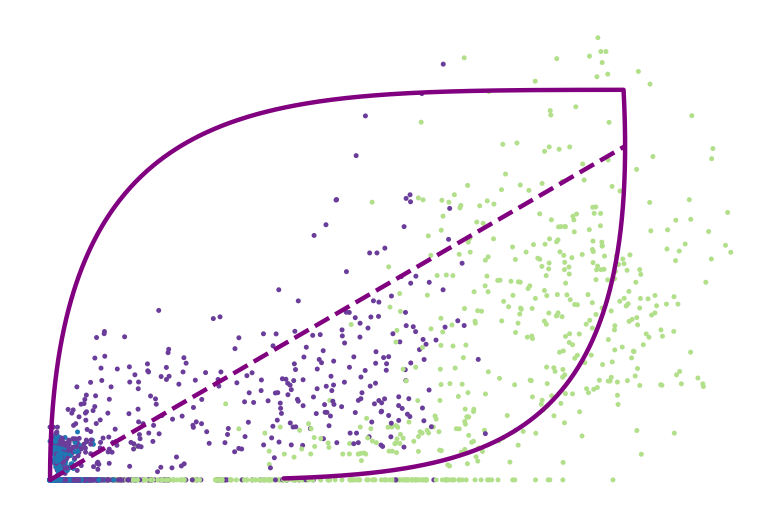

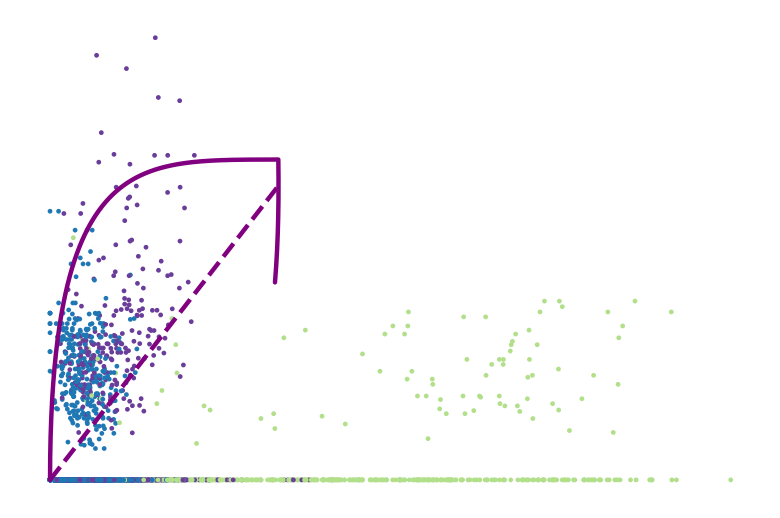

Hmmr


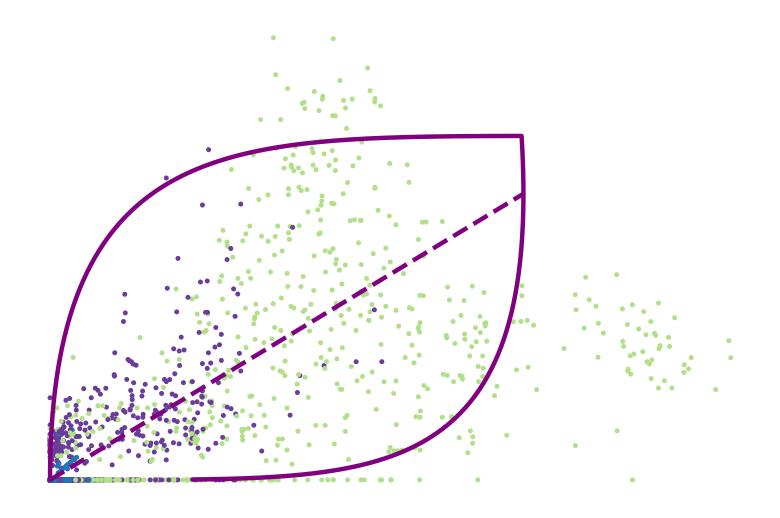

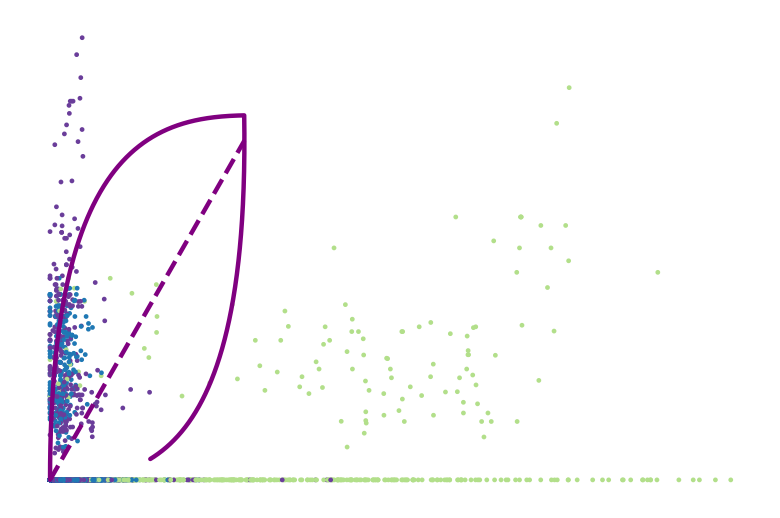

Mki67


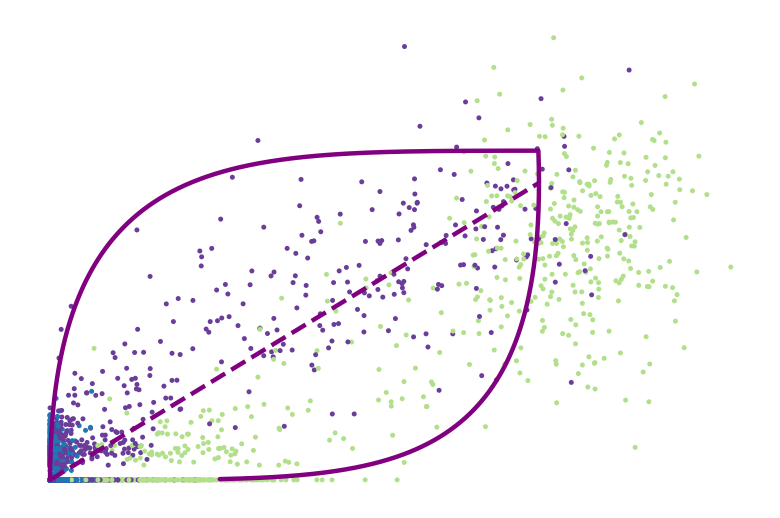

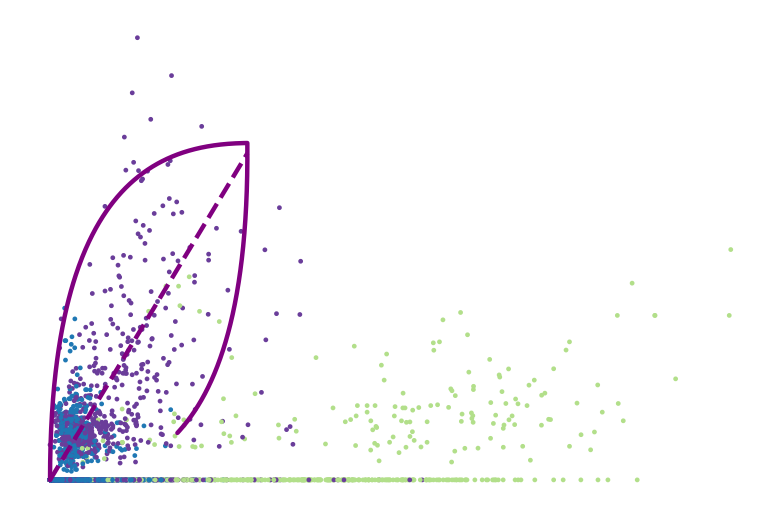

Nusap1


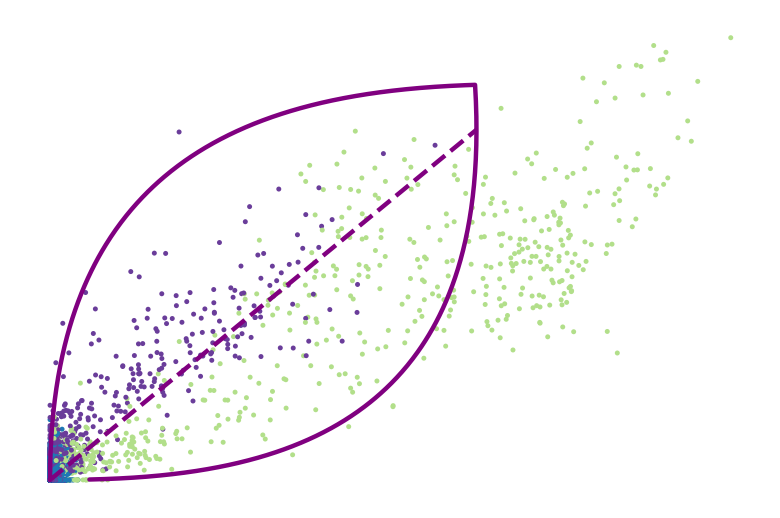

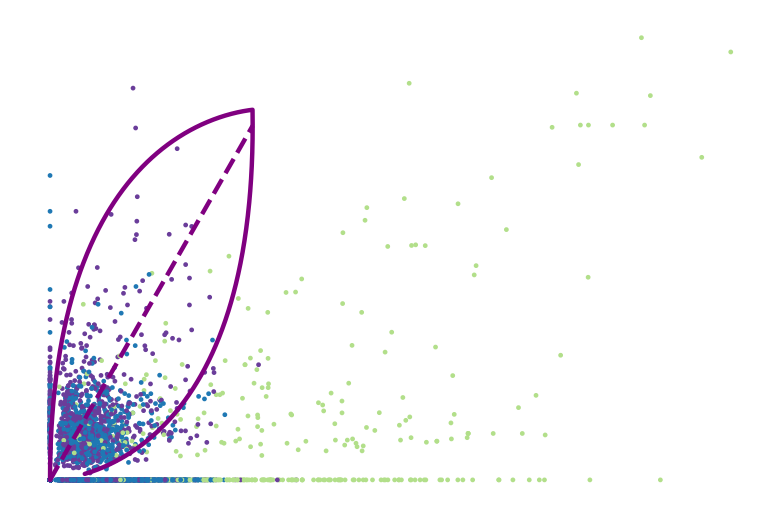

Cks2


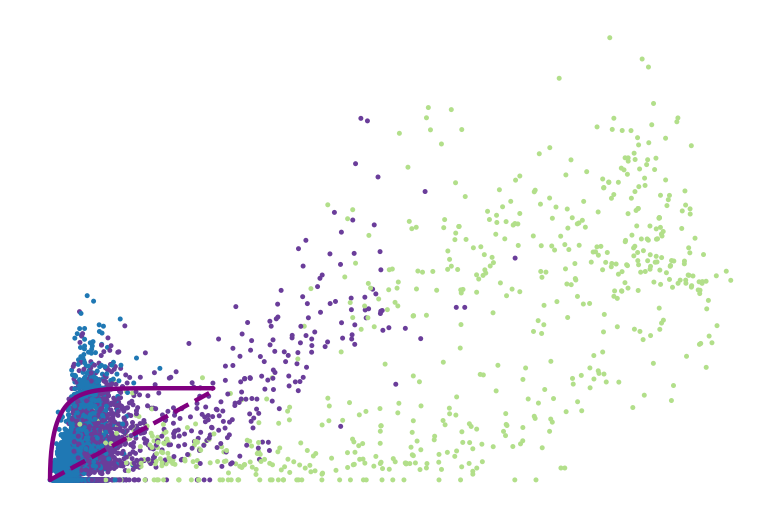

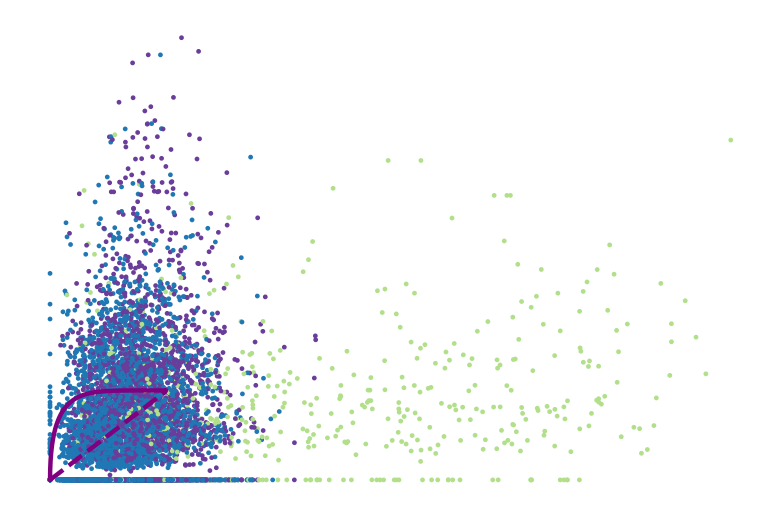

Ccnb2


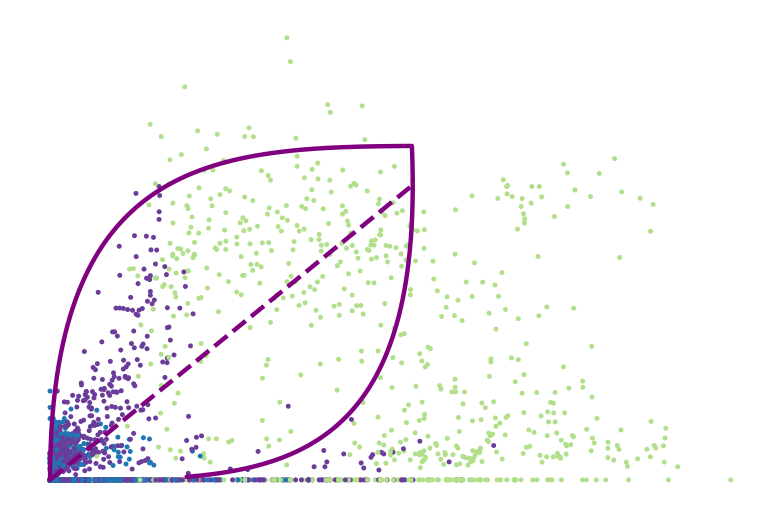

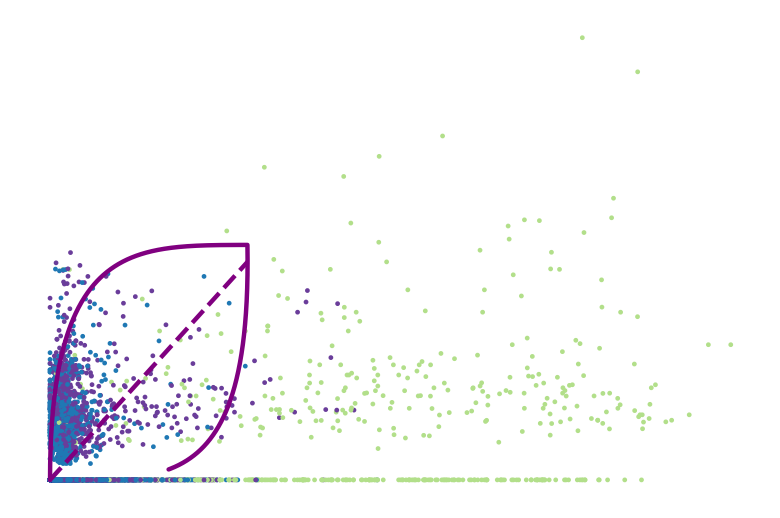

Top2a


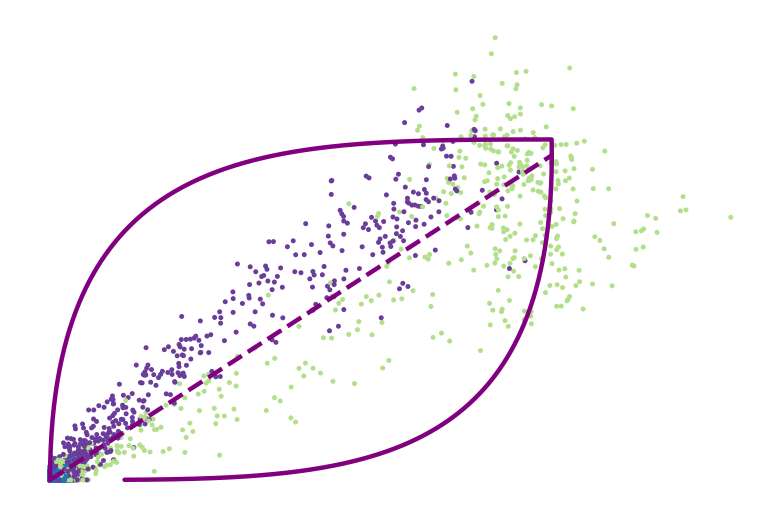

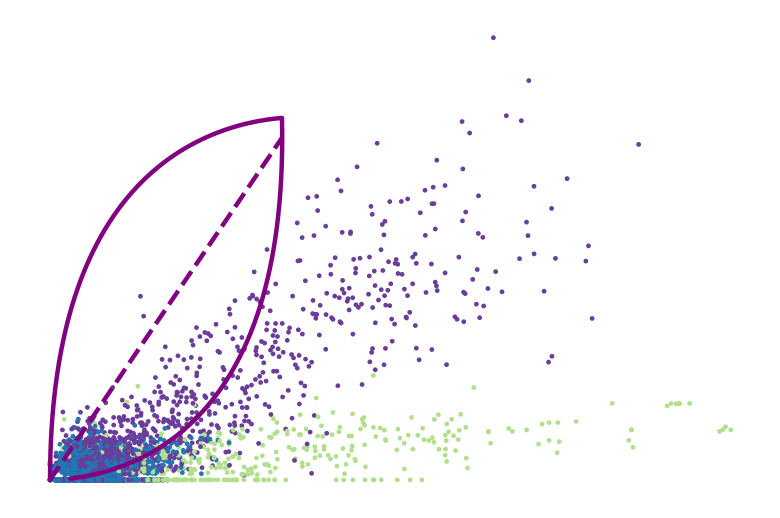

Mcm6


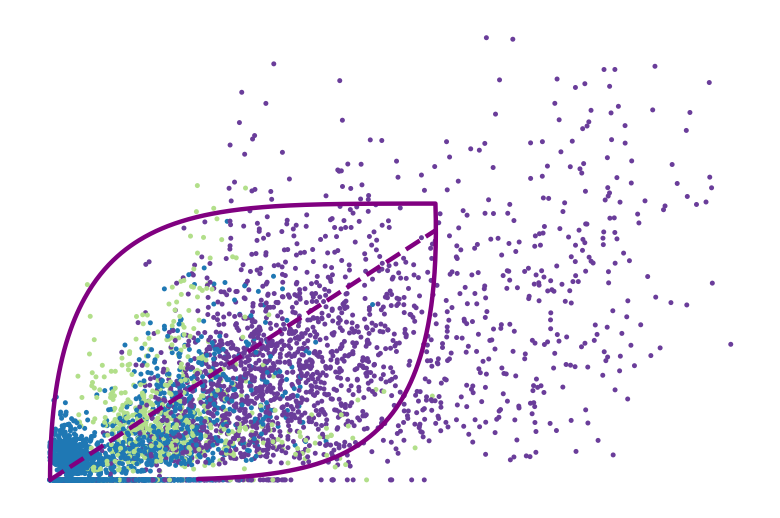

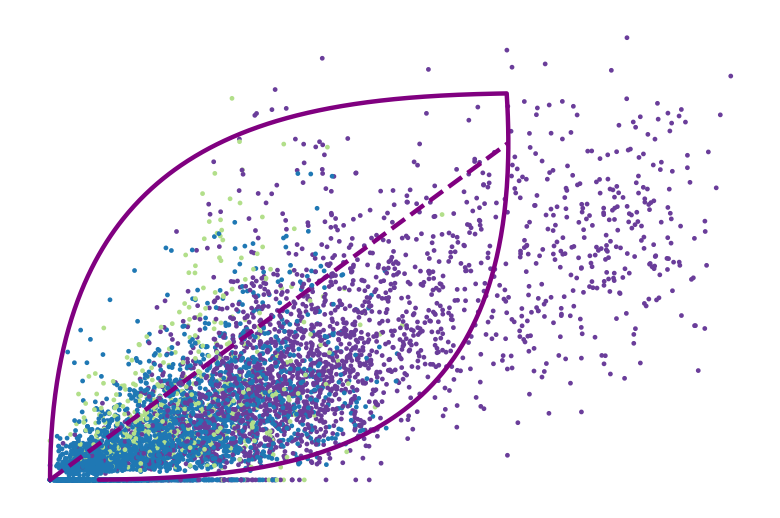

Rrm2


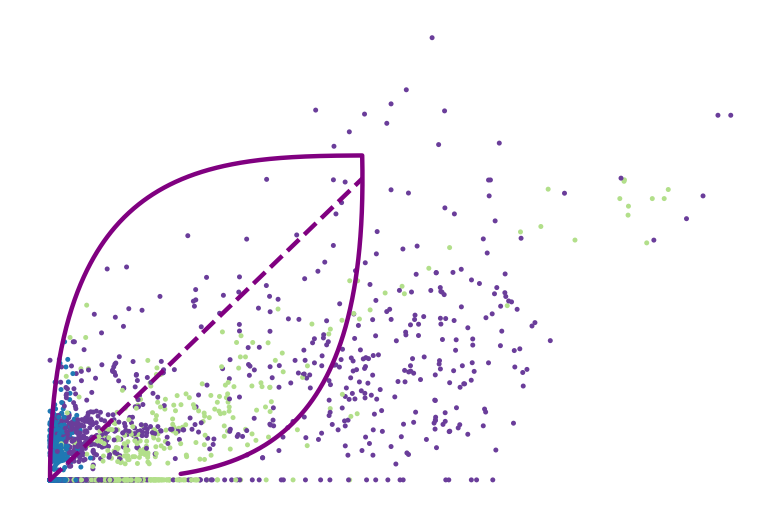

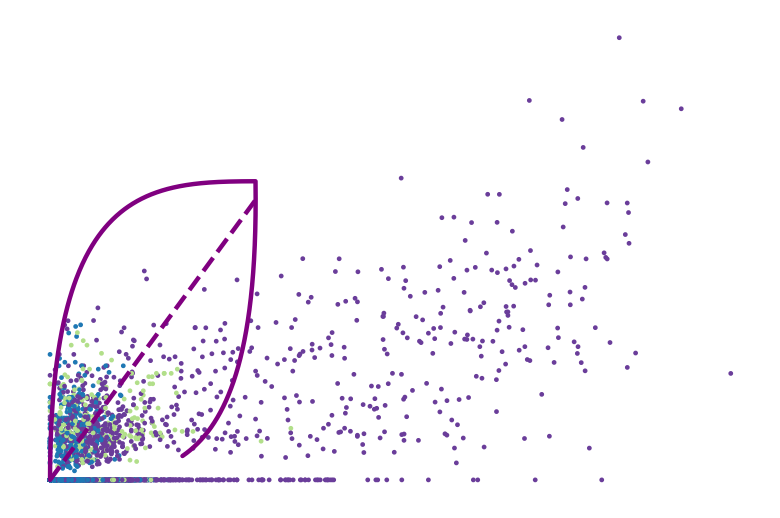

Uhrf1


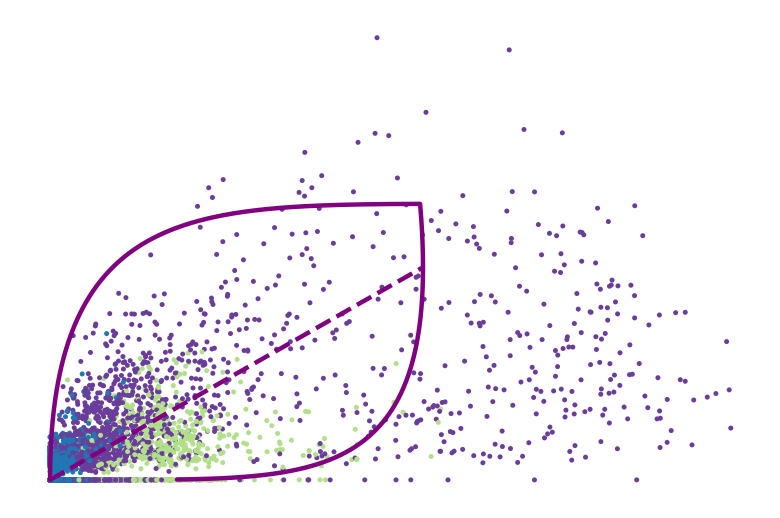

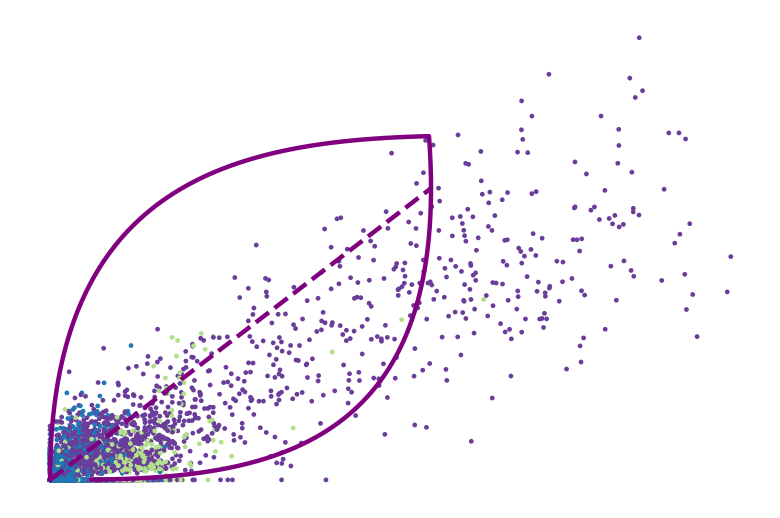

Atad2


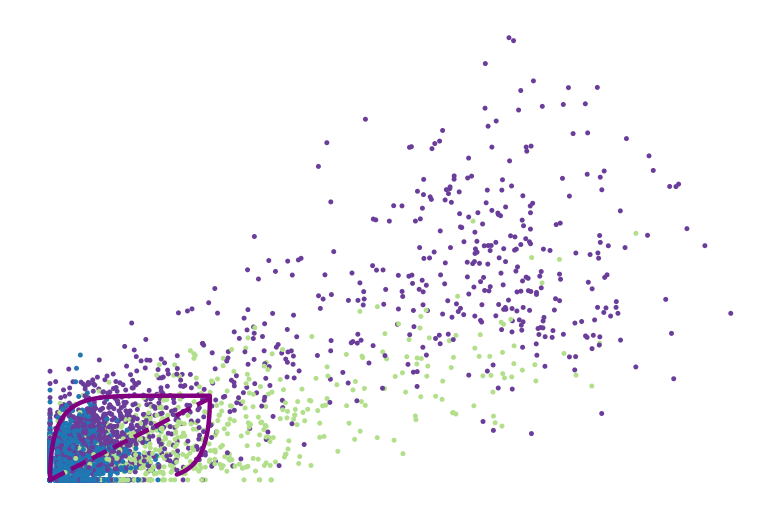

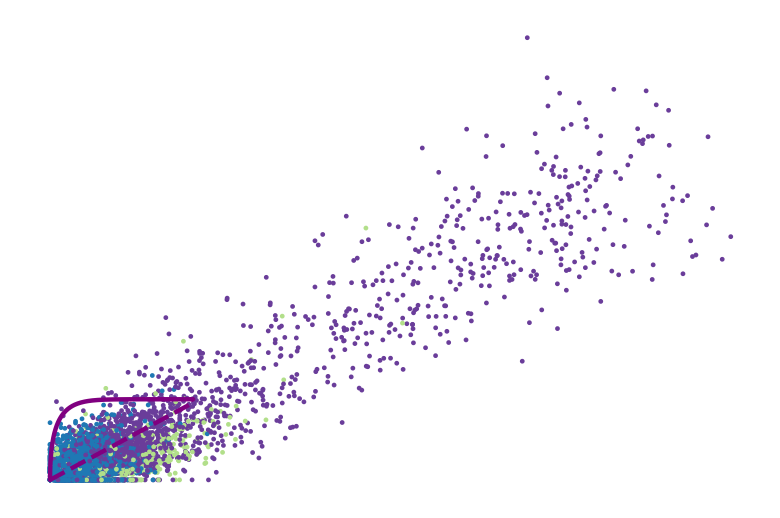

Gmnn


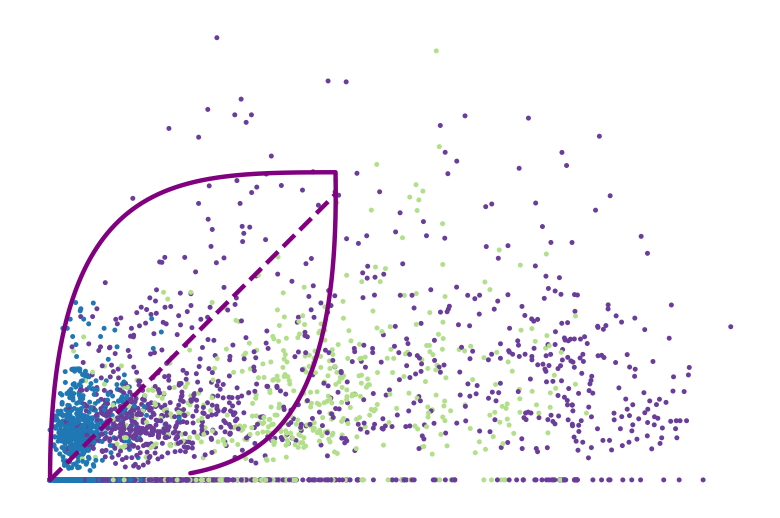

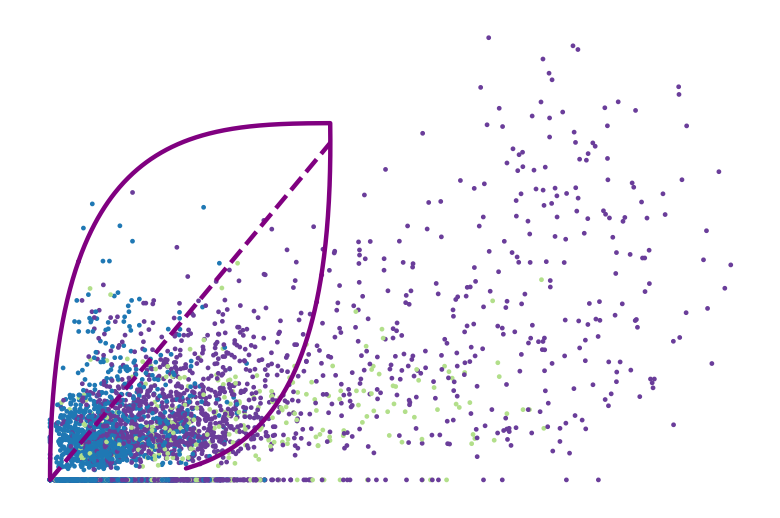

Clspn


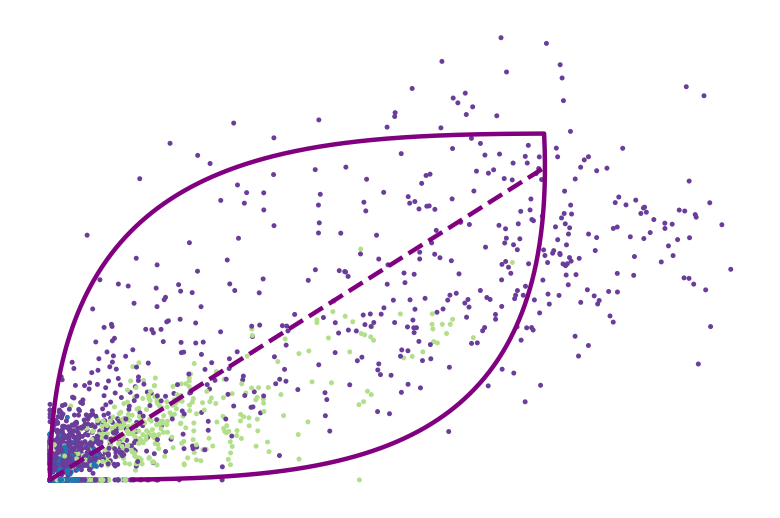

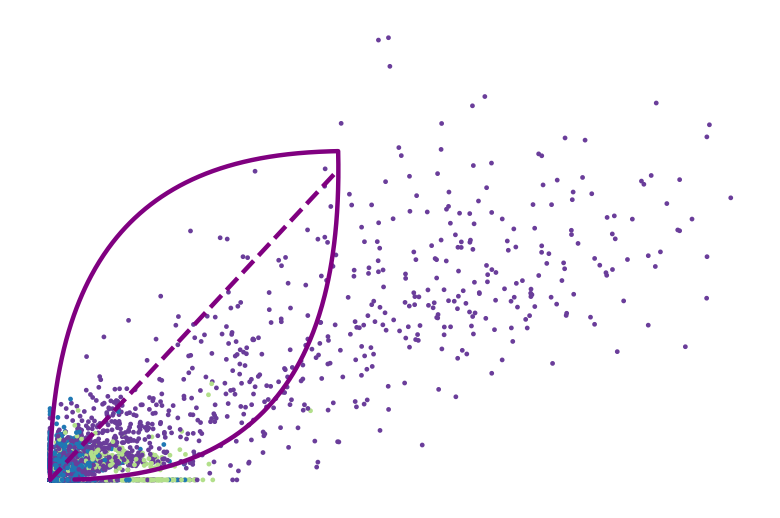

Pcna


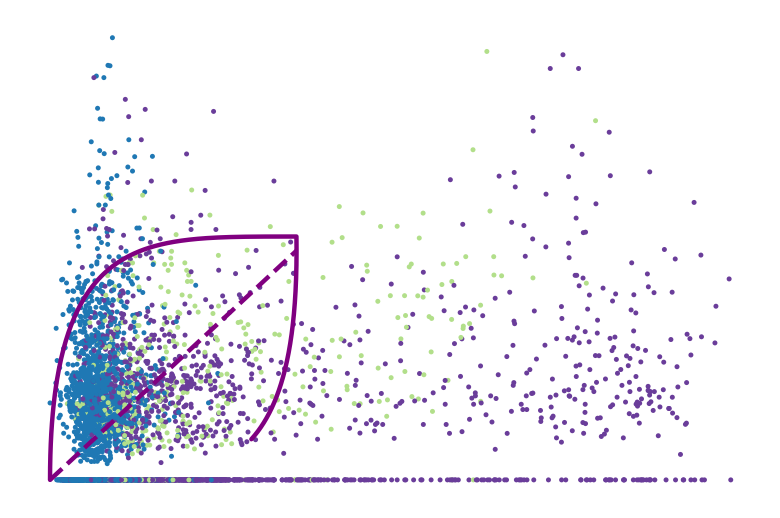

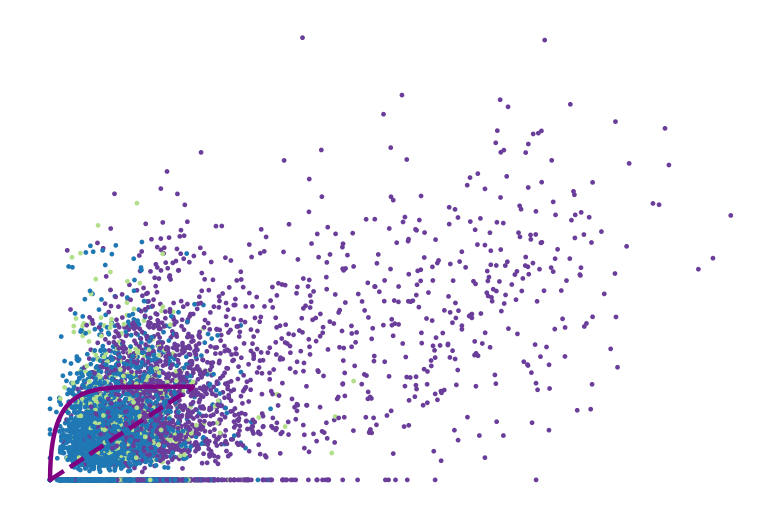

Hells


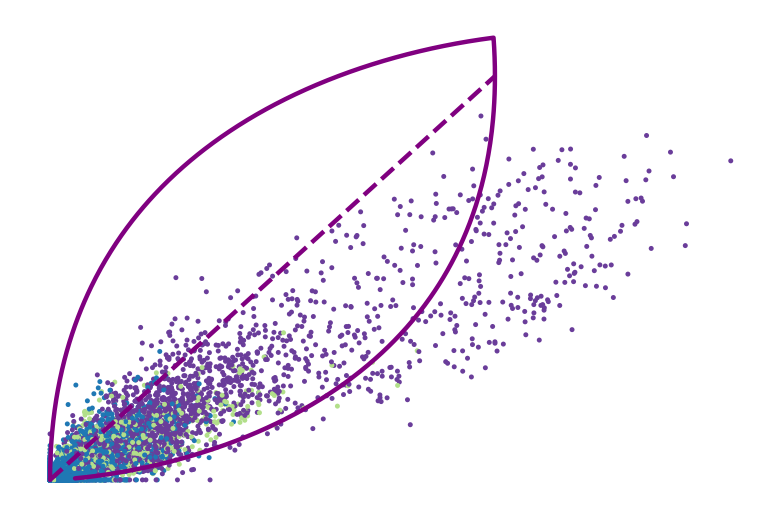

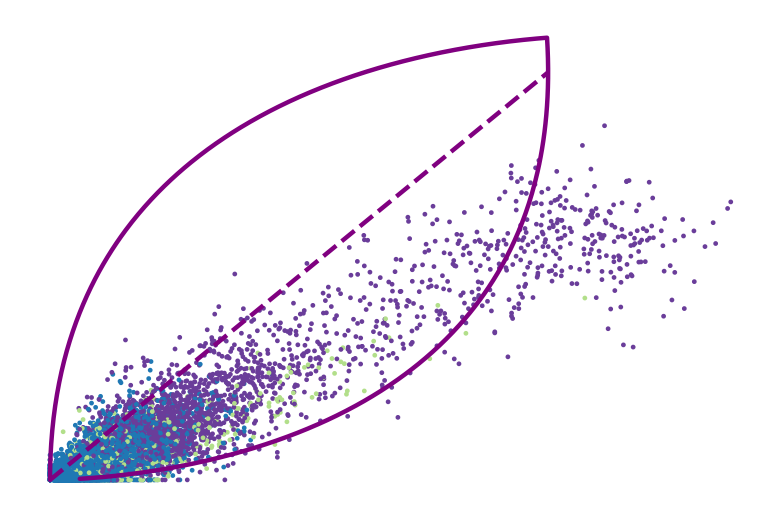

In [30]:
for gene in g2m_all + s_genes_all:
    # scRNA data
    print(gene)
    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))
        ax.axis("off")
        ax = scv.pl.scatter(
            adata_sc,
            basis=gene,
            fontsize=16,
            frameon=False,
            color="phase",
            legend_loc=False,
            show=False,
            title="",
            ax=ax,
        )
        plot_dynamics_(adata_sc, gene, "purple", ax)
        # ax.set_xlabel("Ms")
        # ax.set_ylabel("Mu")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"{gene}_sc.png", format="png", dpi=500, transparent=True, bbox_inches="tight")

    # snRNA data
    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))
        ax.axis("off")
        ax = scv.pl.scatter(
            adata_sn,
            basis=gene,
            fontsize=16,
            frameon=False,
            color="phase",
            legend_loc=False,
            show=False,
            title="",
            ax=ax,
        )
        plot_dynamics_(adata_sn, gene, "purple", ax)
        # ax.set_xlabel("Ms")
        # ax.set_ylabel("Mu")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            # fig.savefig(path / f"{gene}_sn.svg", format="svg", transparent=True, bbox_inches="tight")
            fig.savefig(path / f"{gene}_sn.png", format="png", dpi=500, transparent=True, bbox_inches="tight")

## Plot sc vs. sn benchmark (colored by cell type)

Cdca8


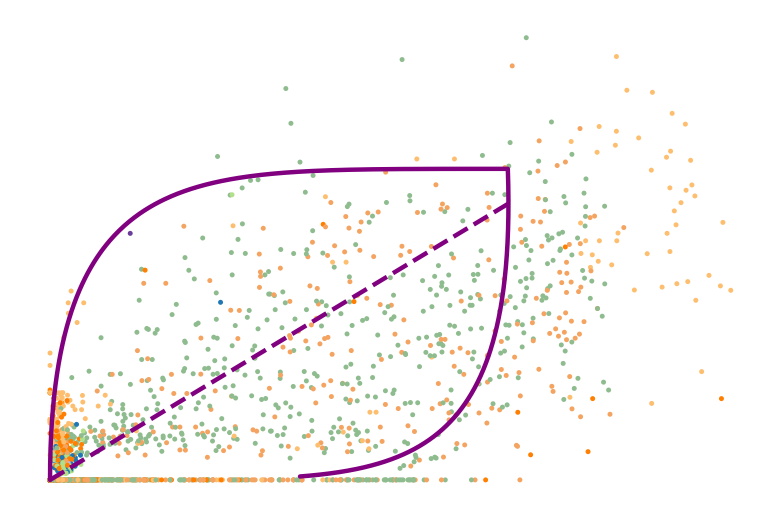

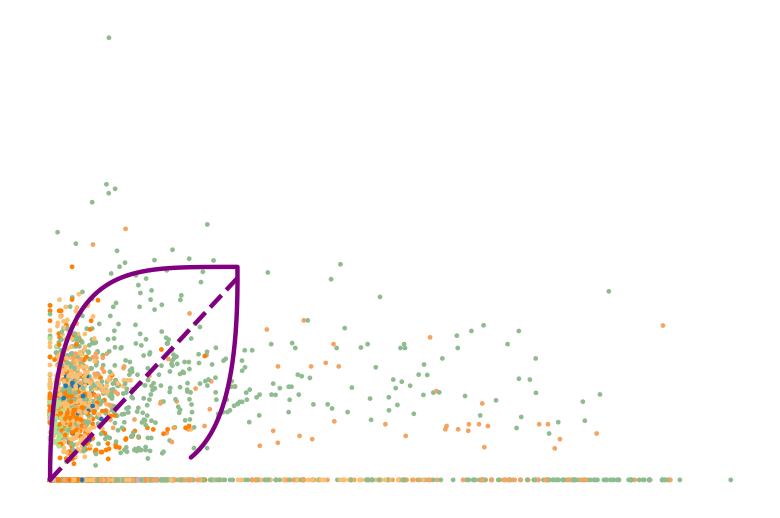

Cenpa


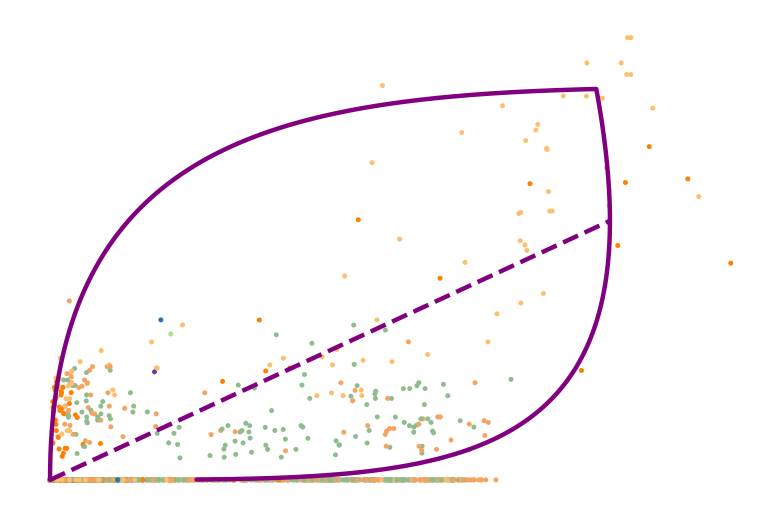

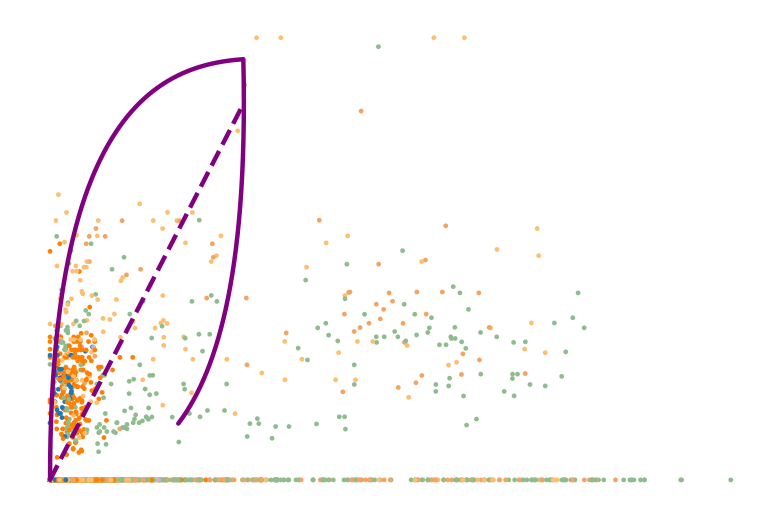

Ube2c


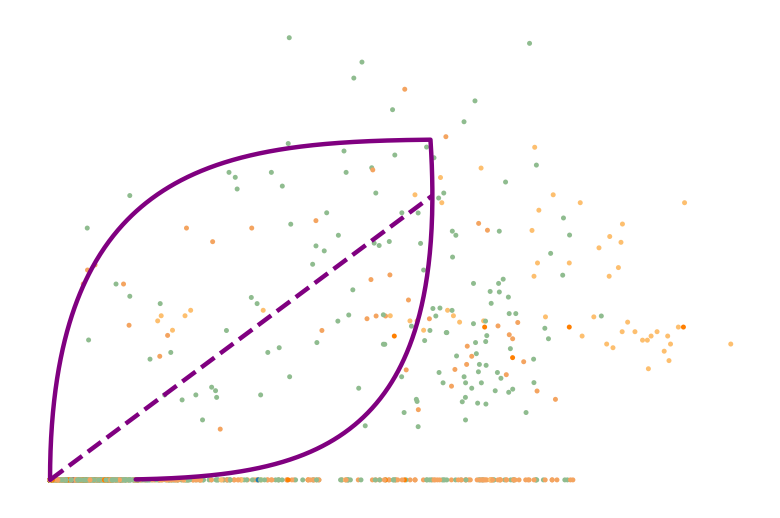

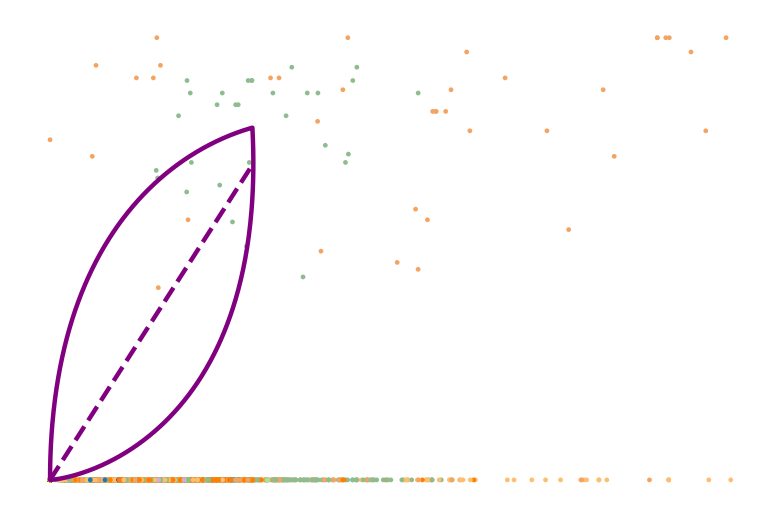

Cenpf


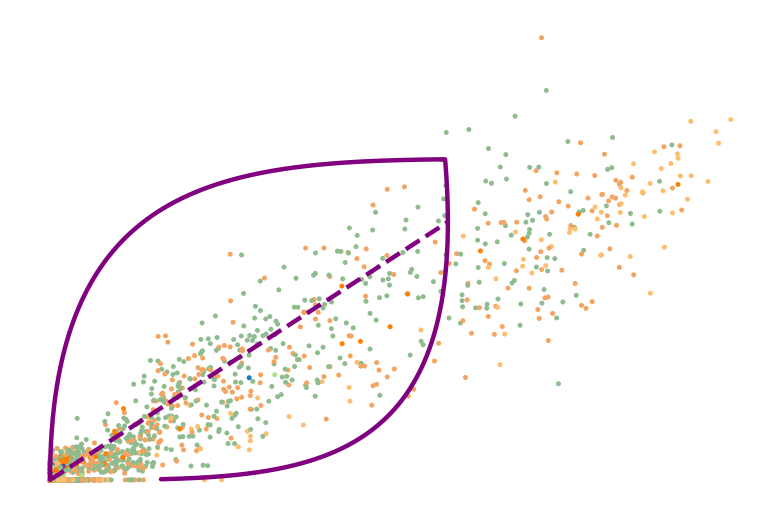

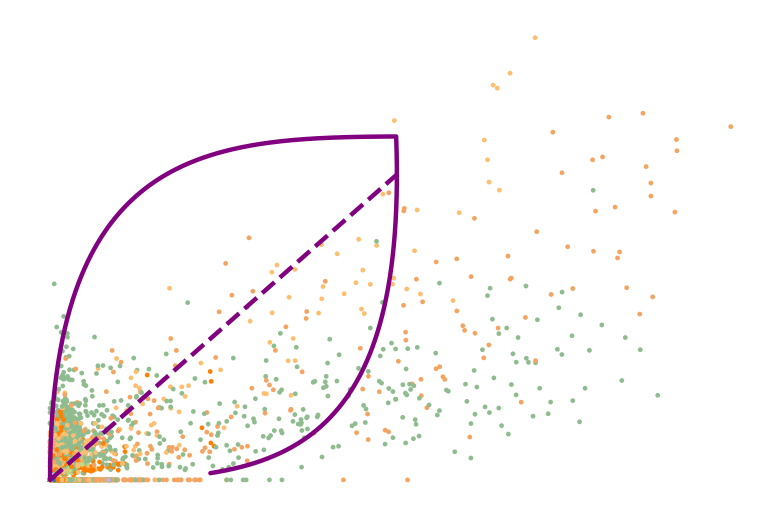

Cdc20


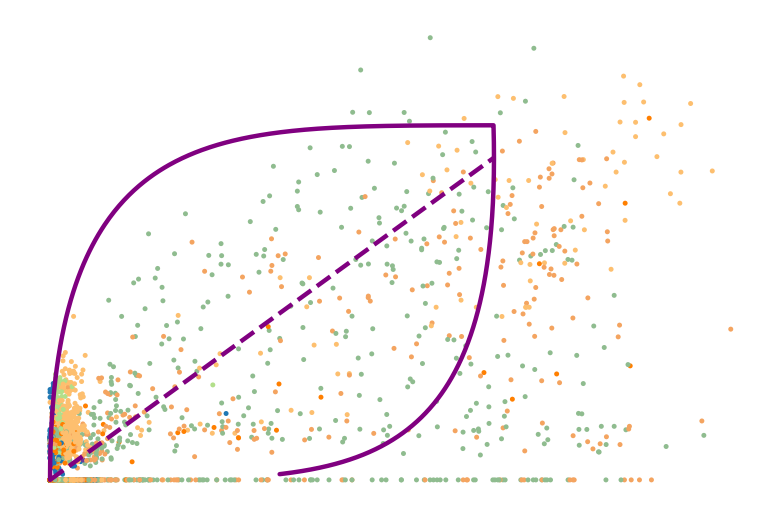

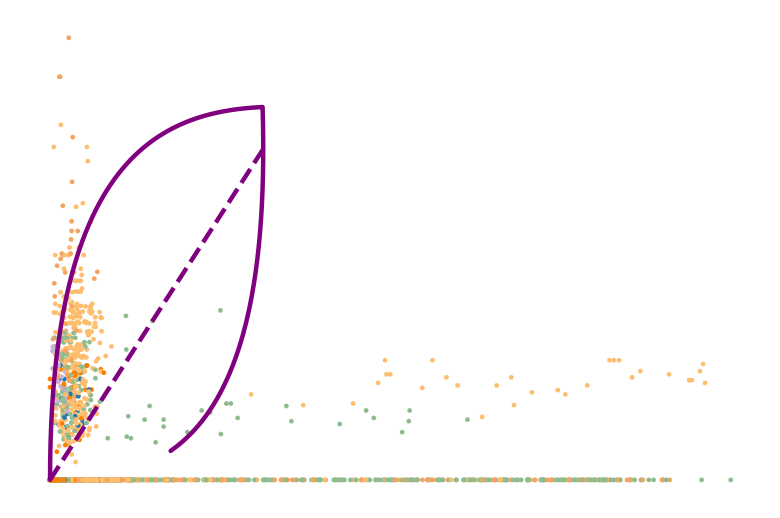

Cenpe


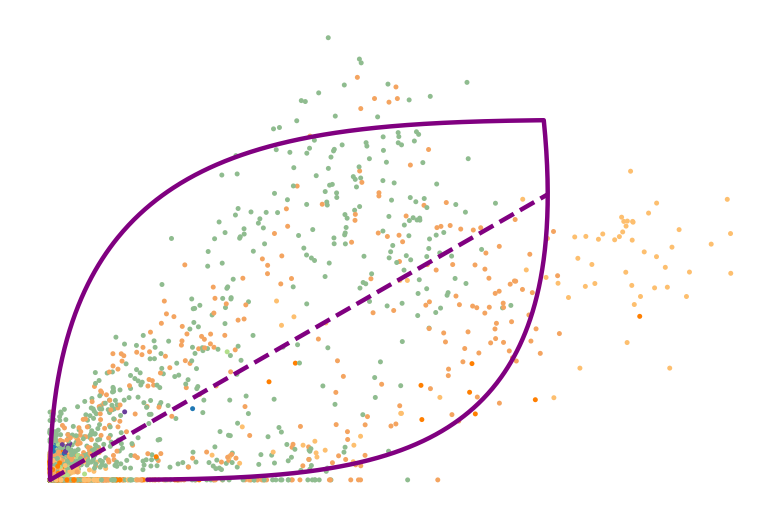

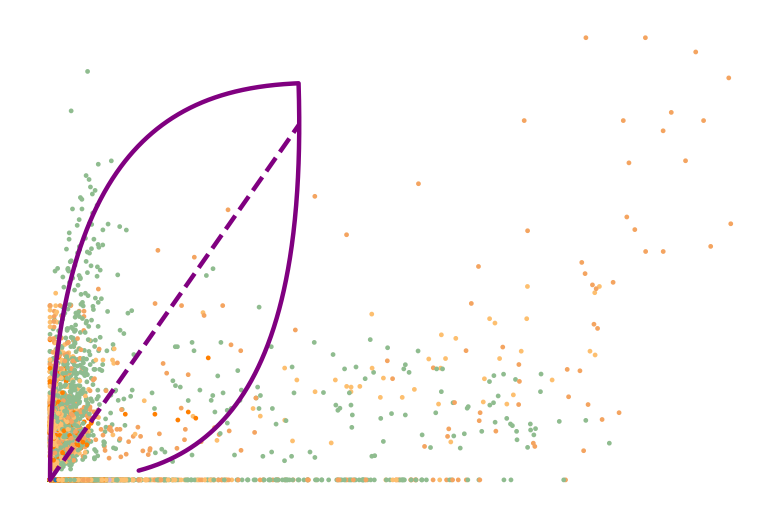

Tpx2


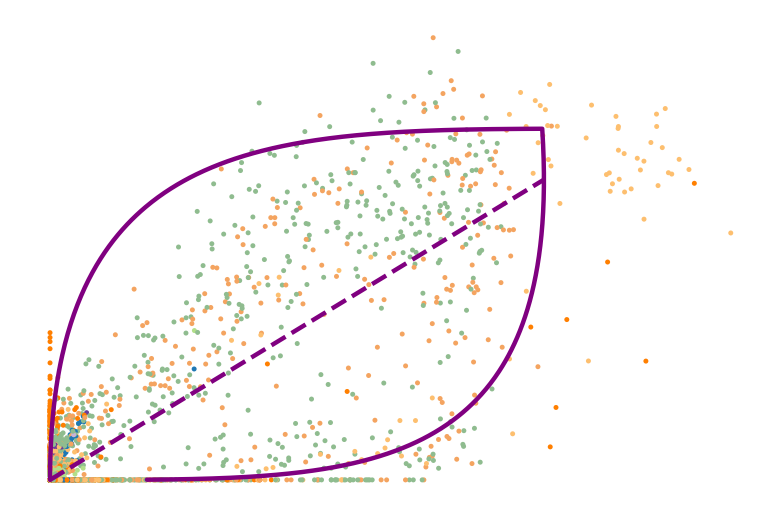

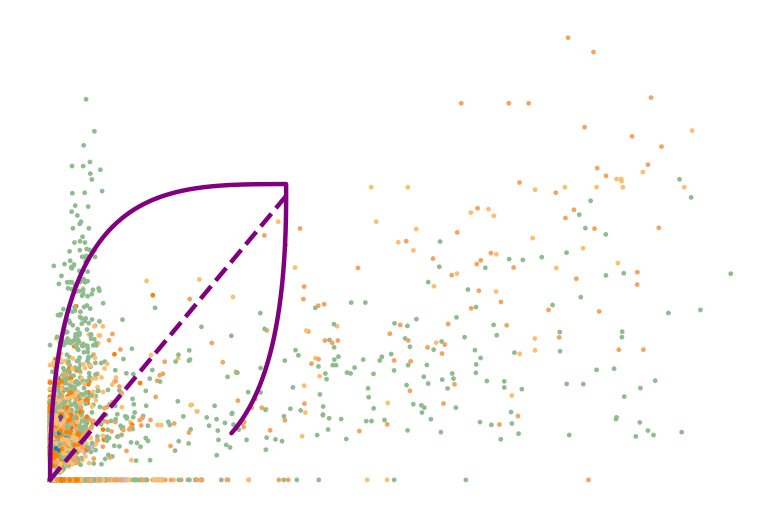

Kif23


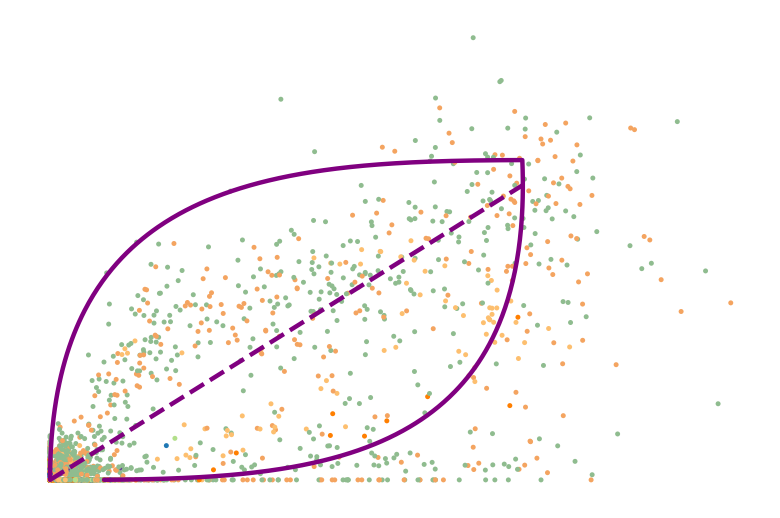

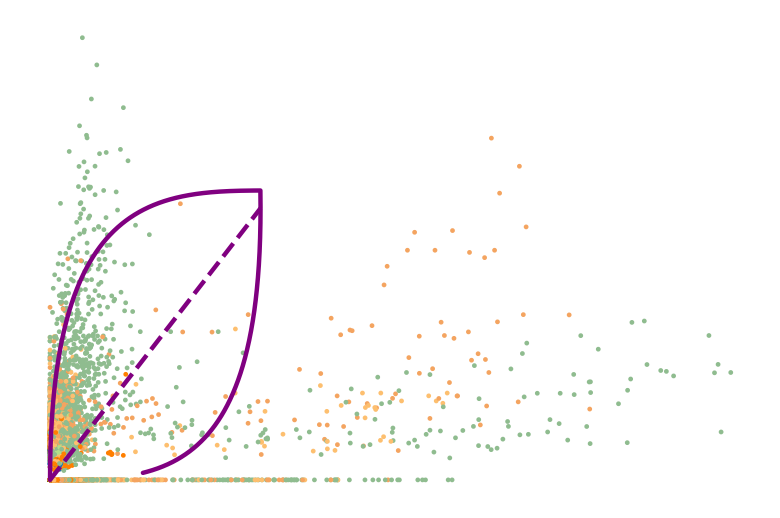

Hmgb2


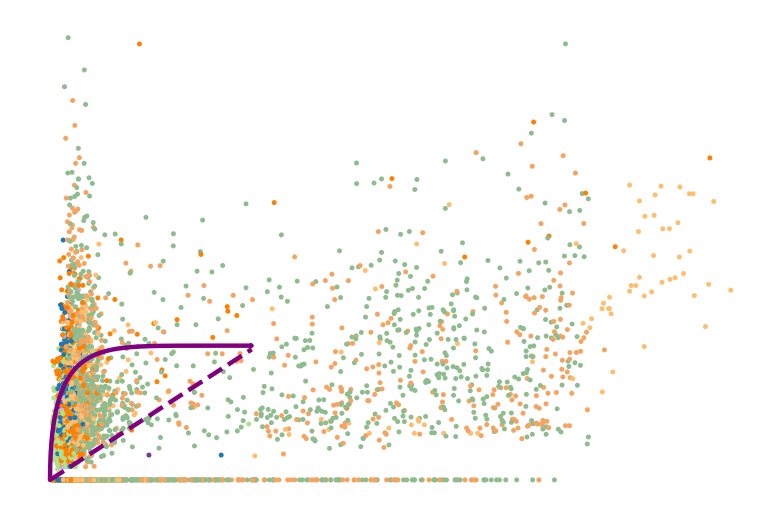

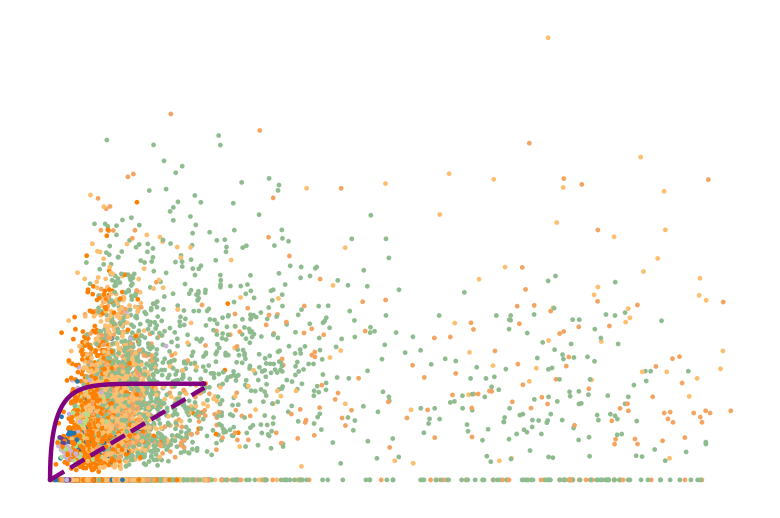

Kif2c


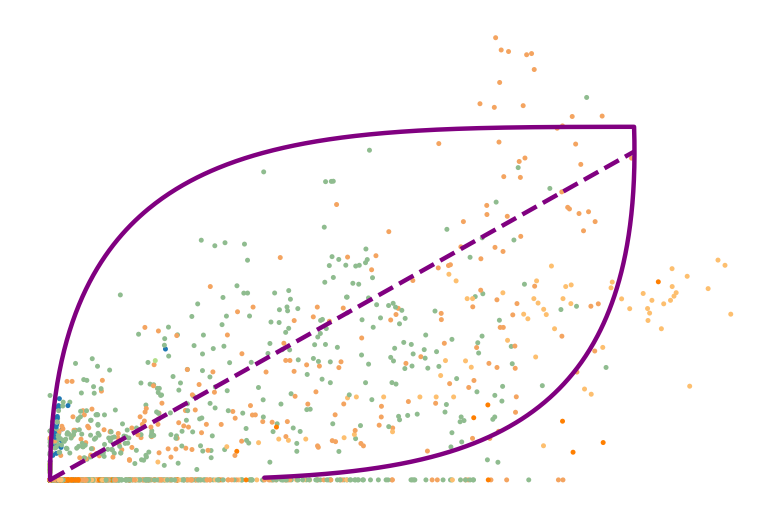

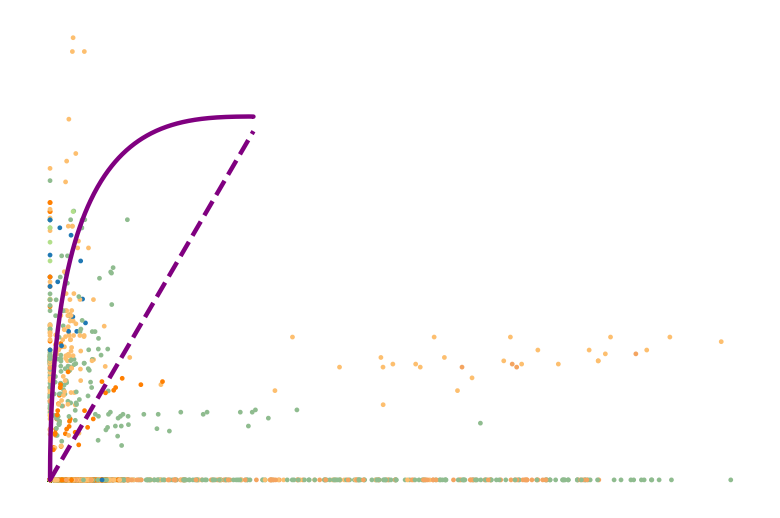

Cdk1


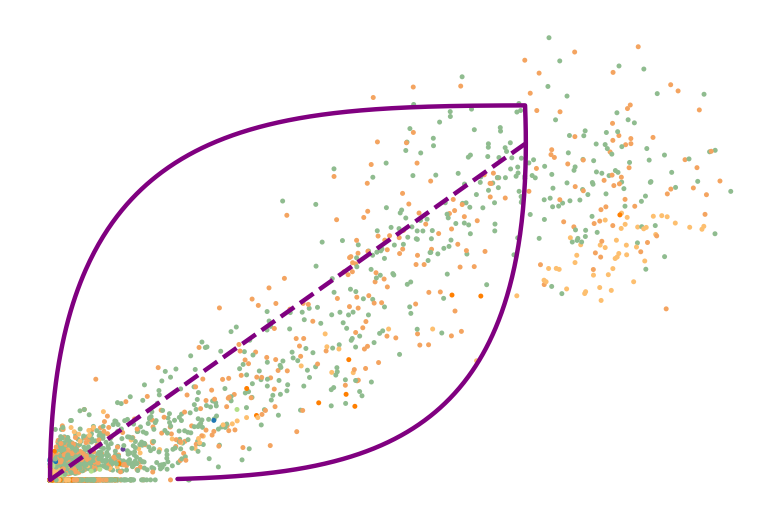

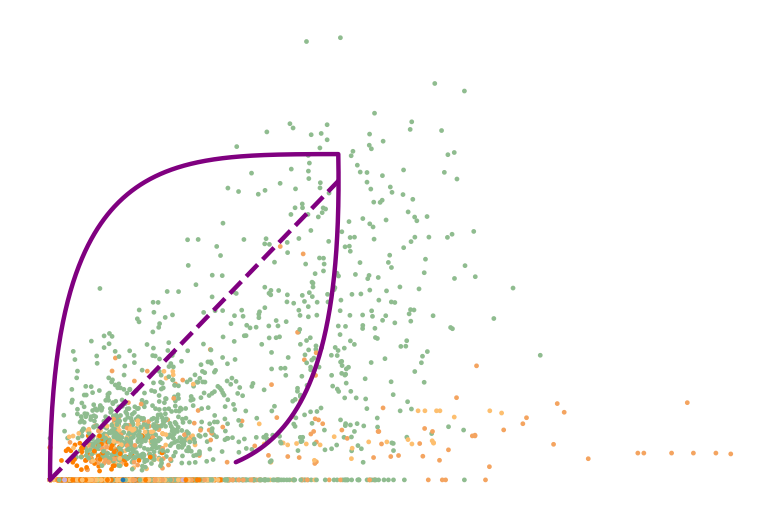

Smc4


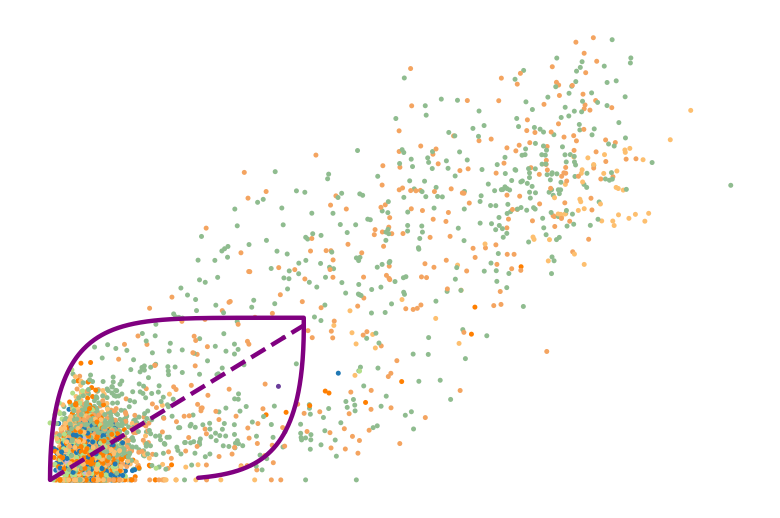

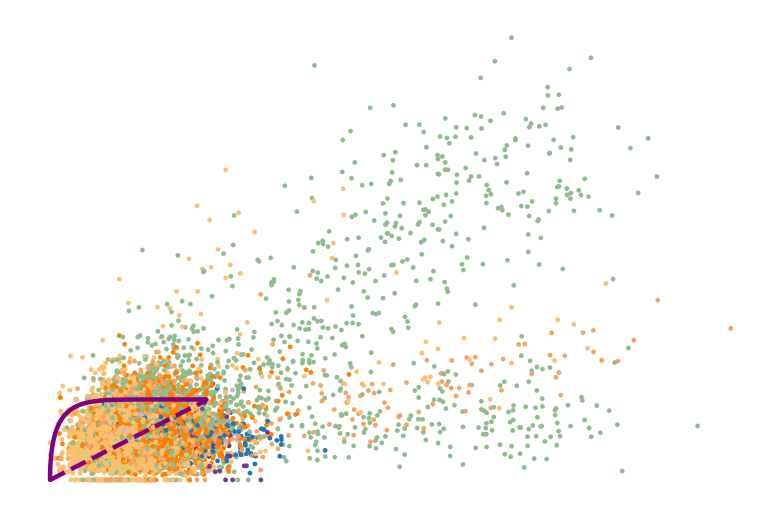

Birc5


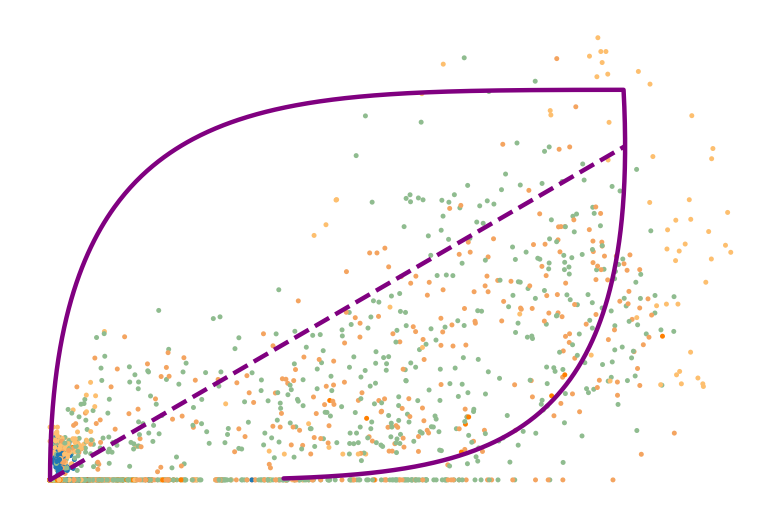

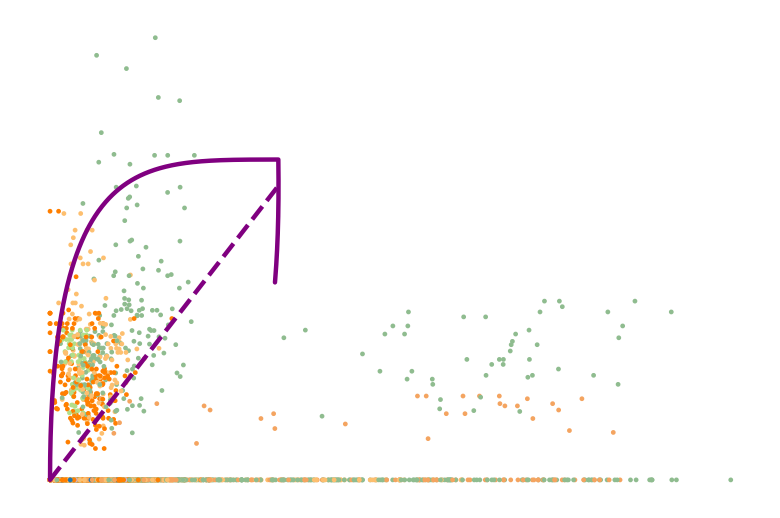

Hmmr


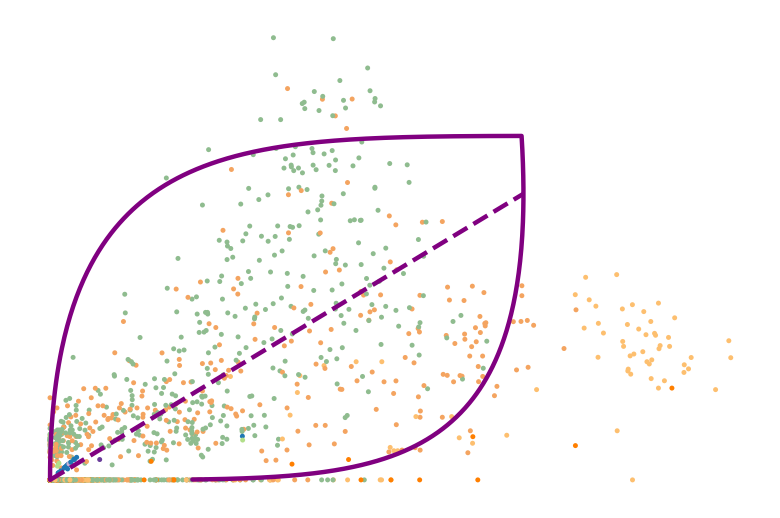

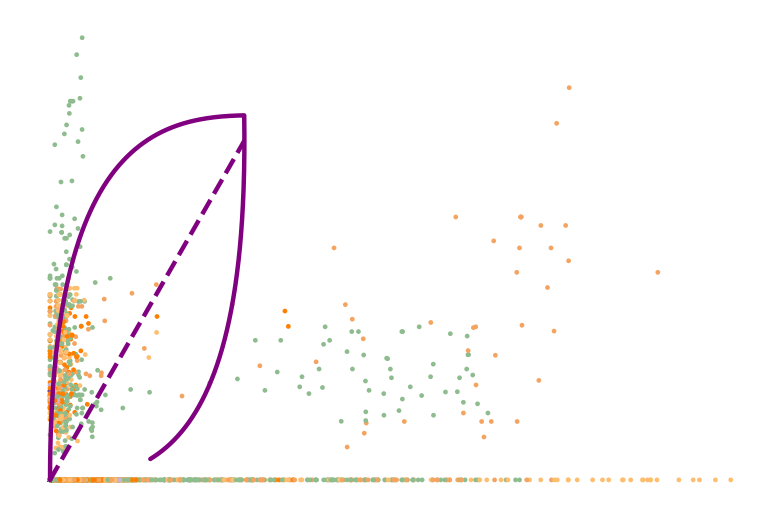

Mki67


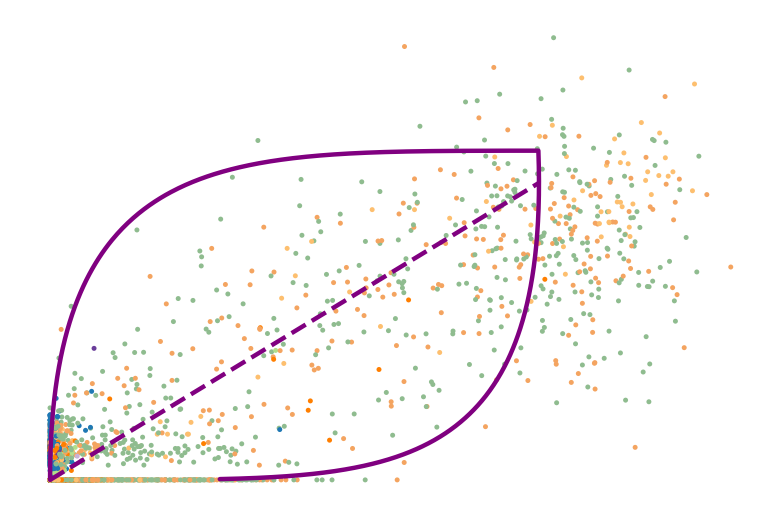

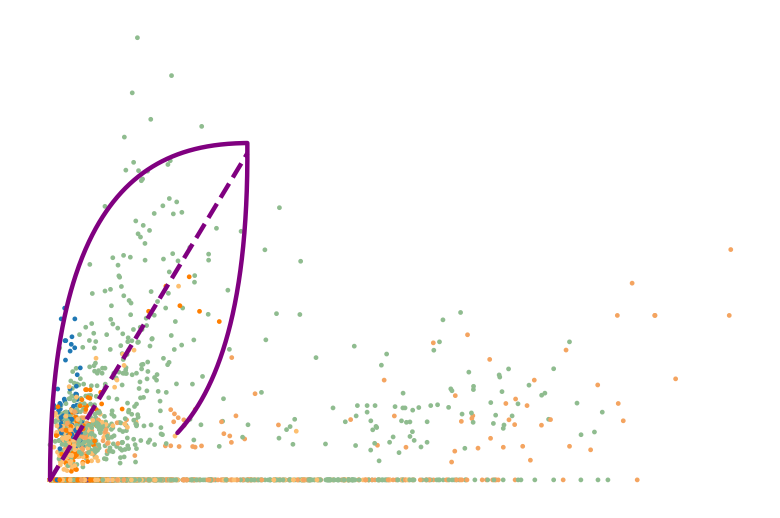

Nusap1


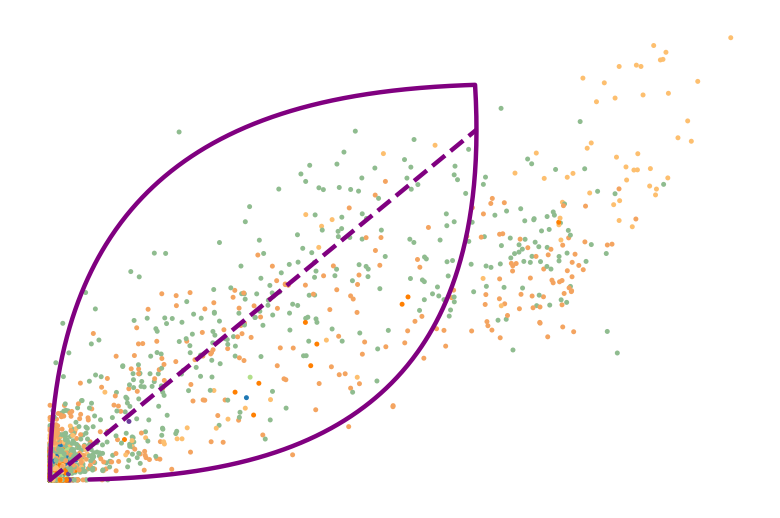

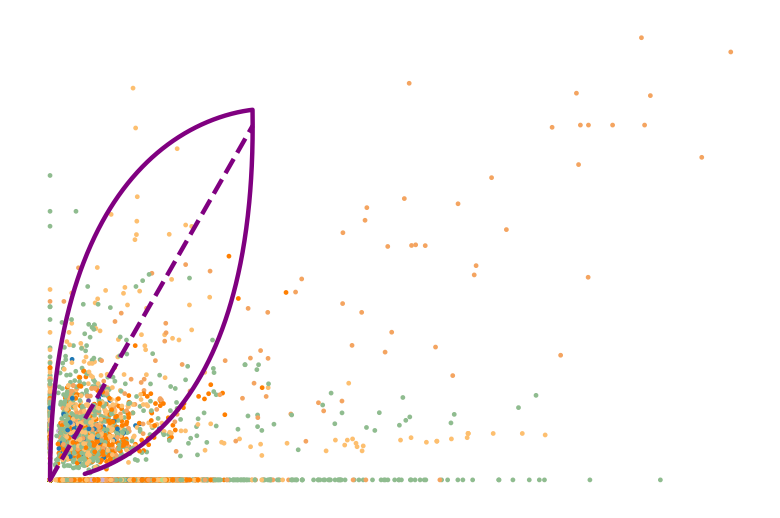

Cks2


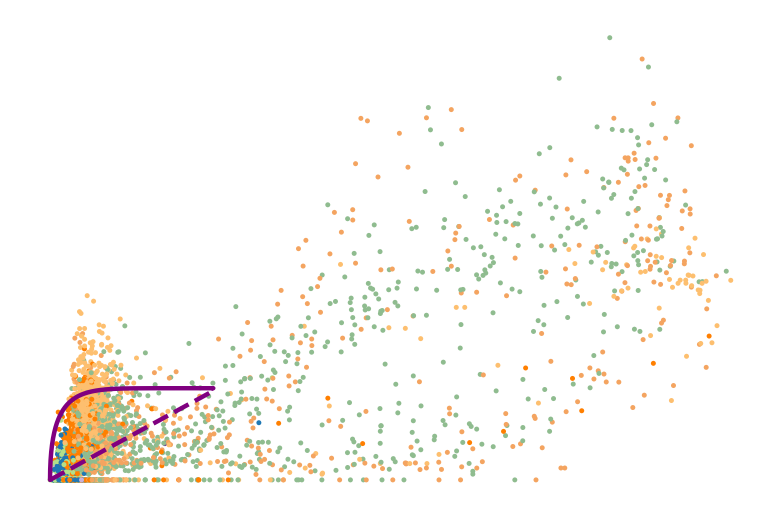

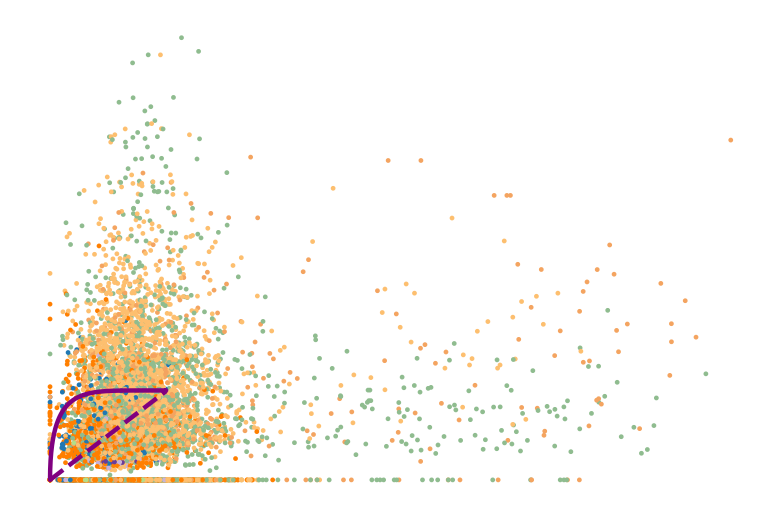

Ccnb2


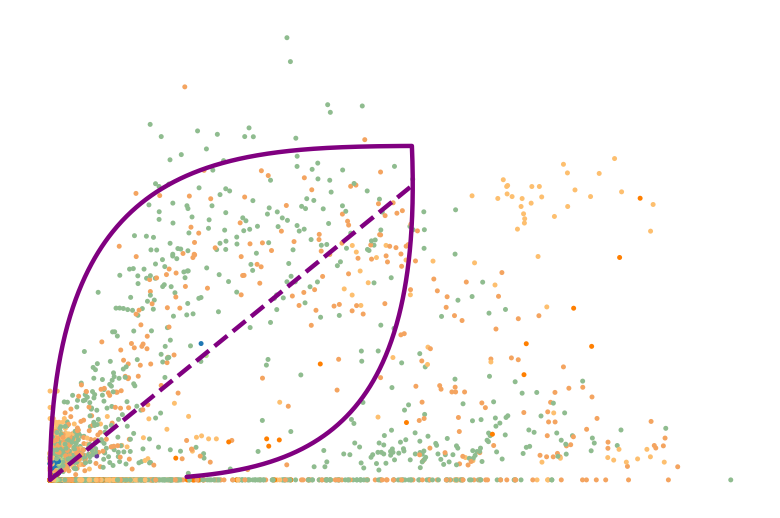

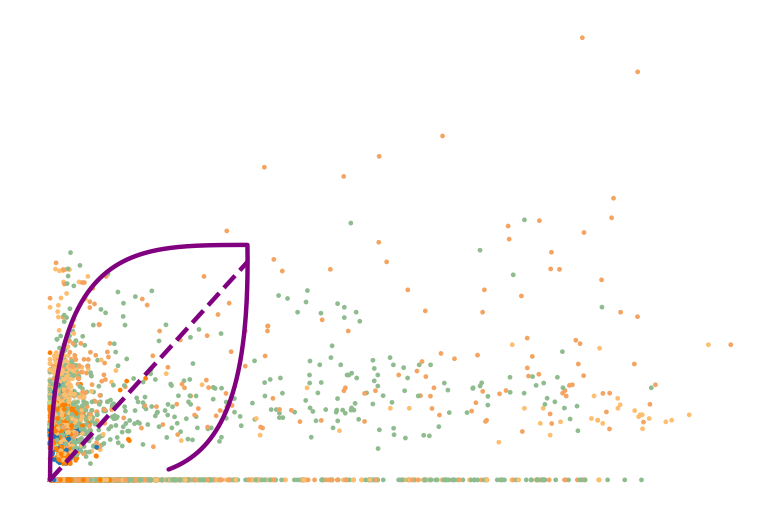

Top2a


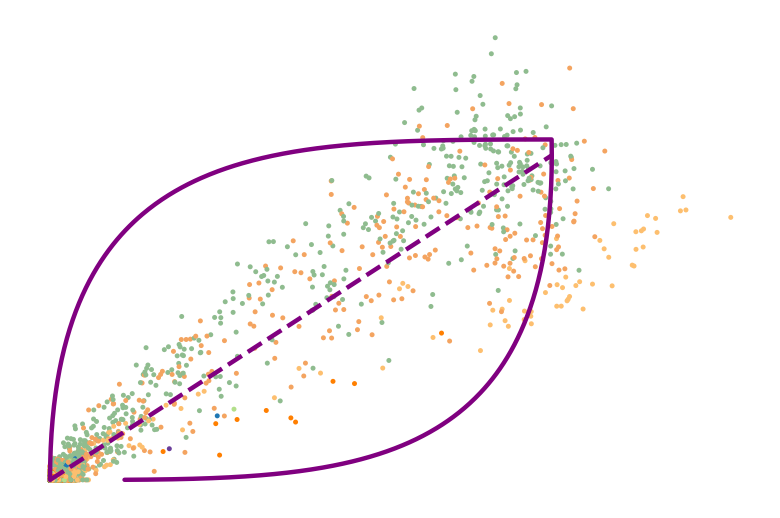

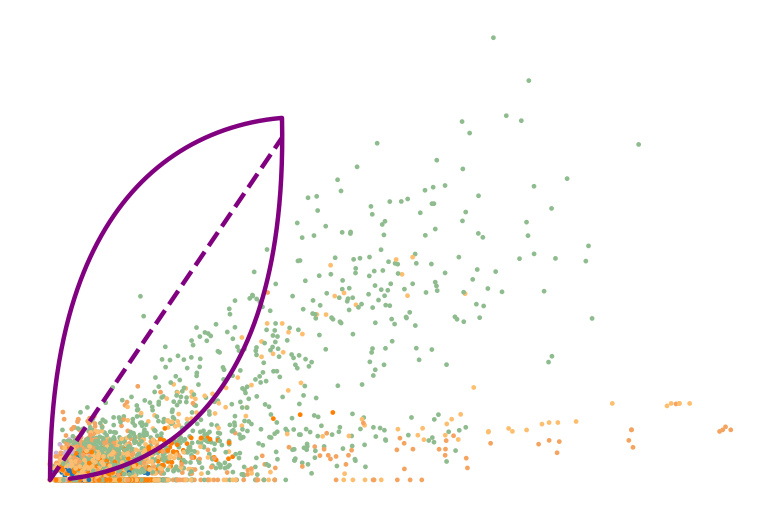

Mcm6


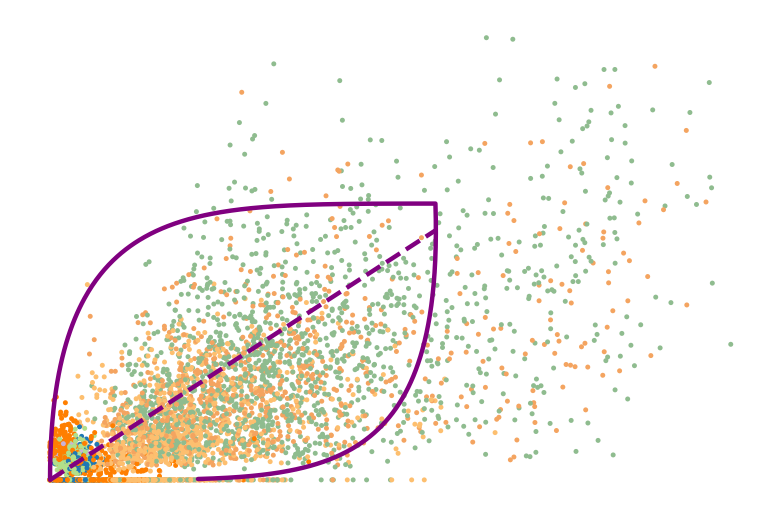

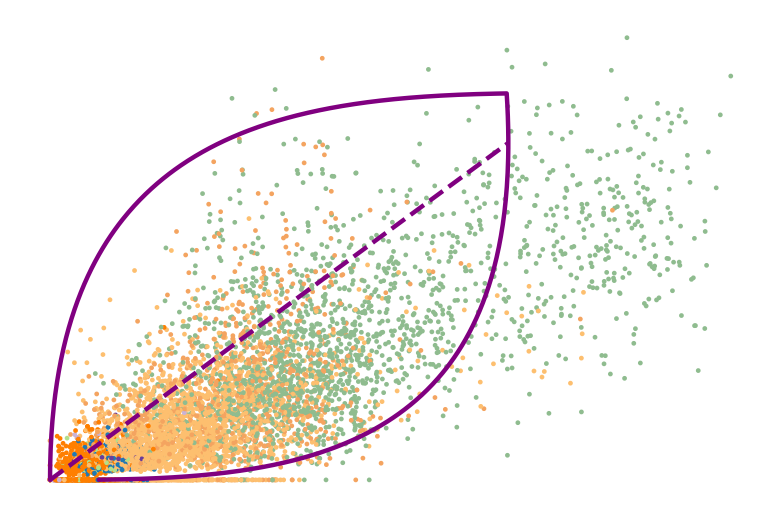

Rrm2


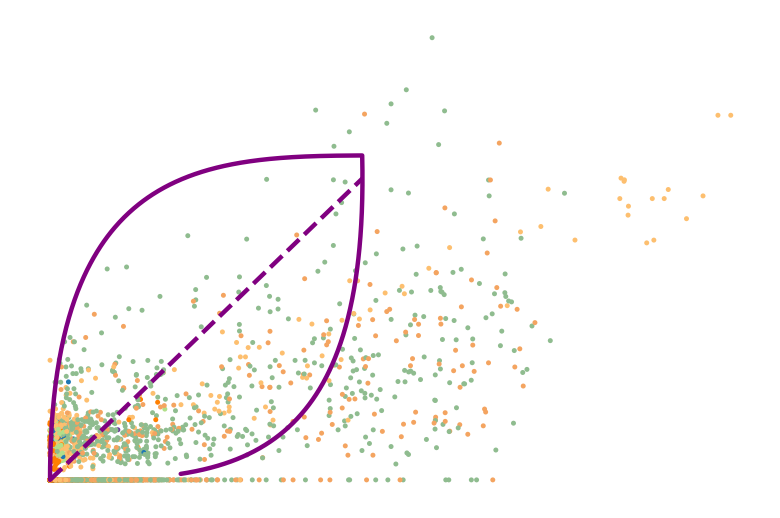

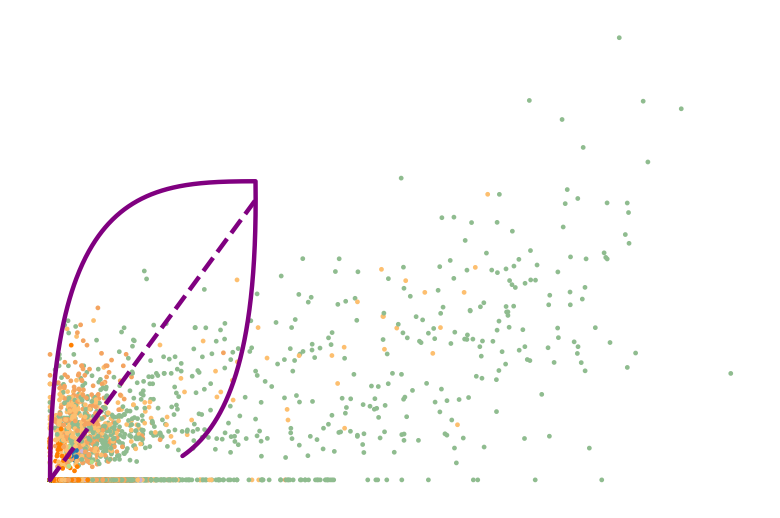

Uhrf1


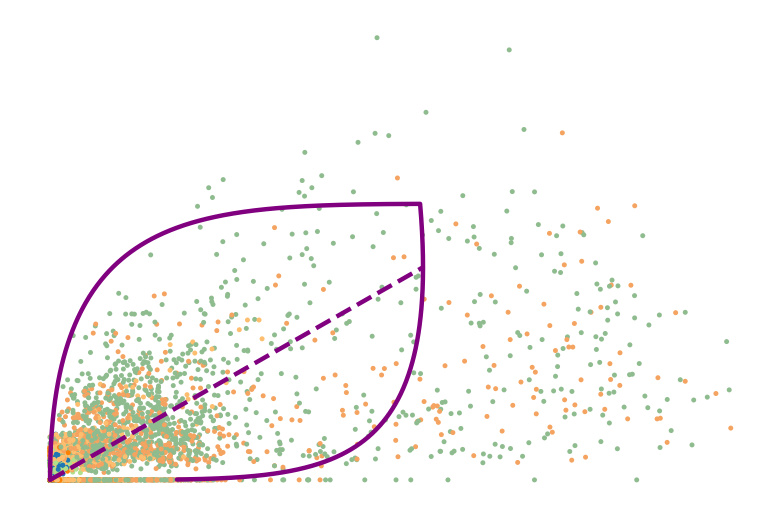

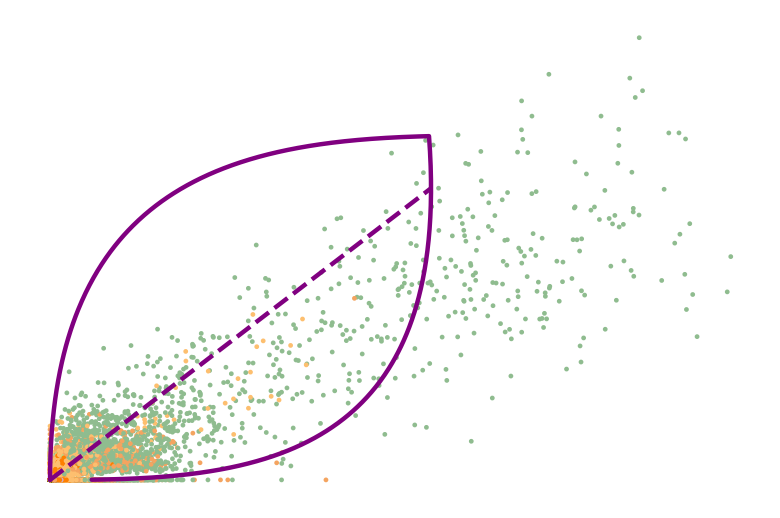

Atad2


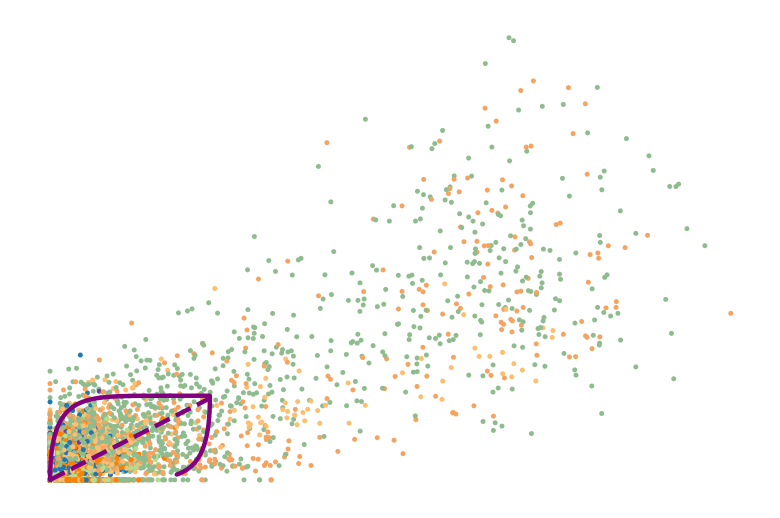

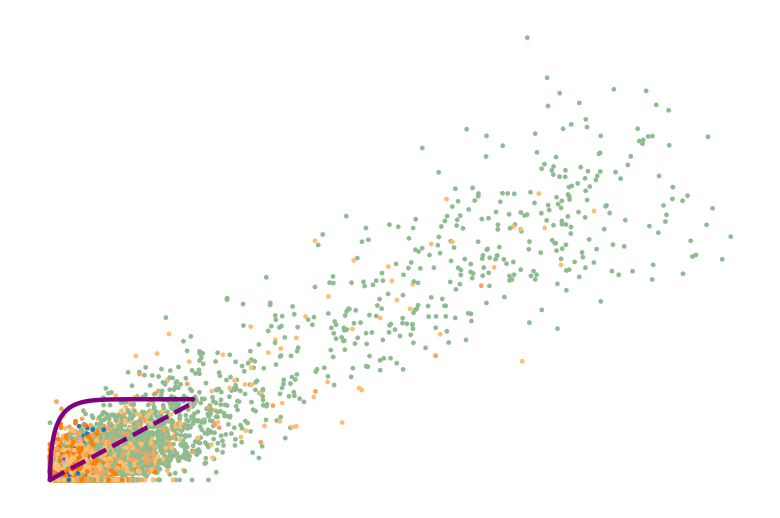

Gmnn


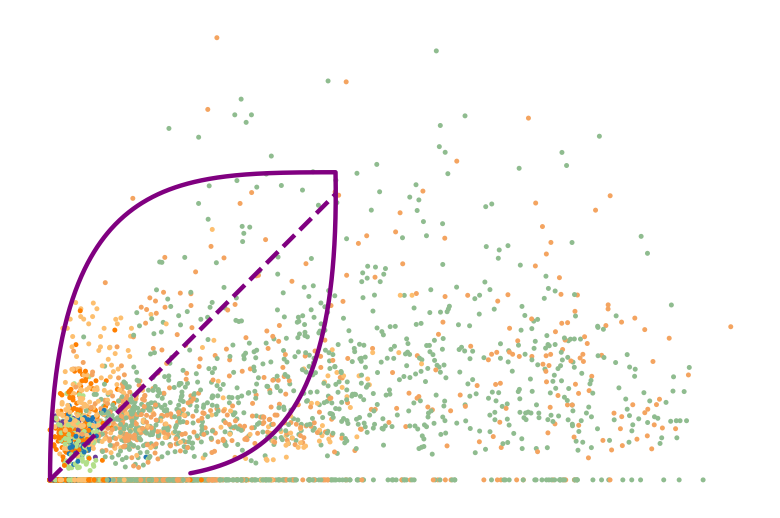

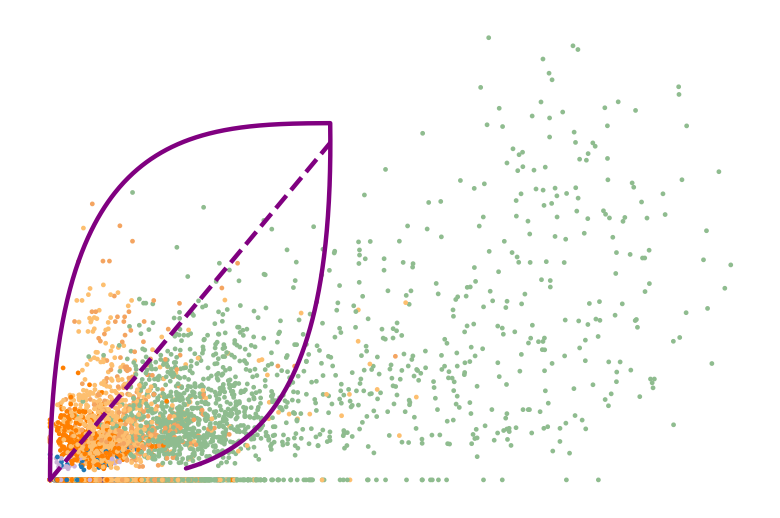

Clspn


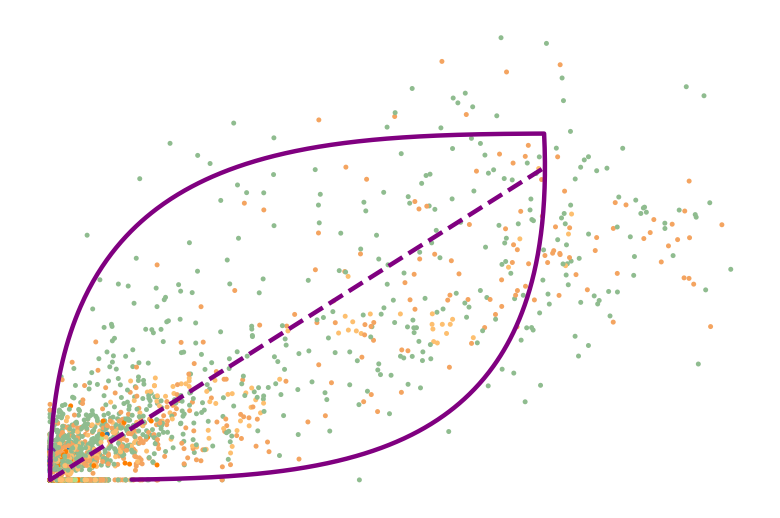

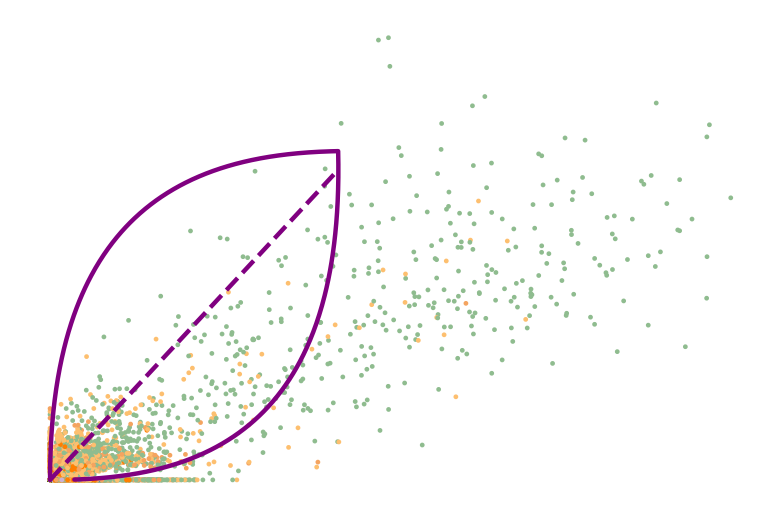

Pcna


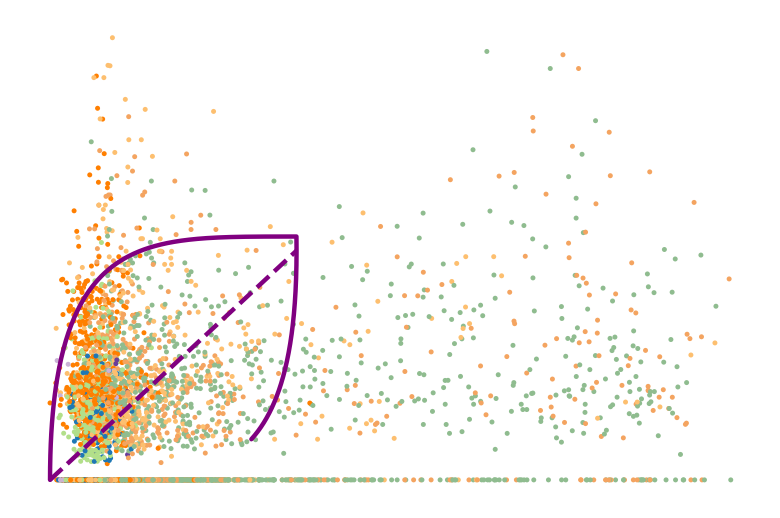

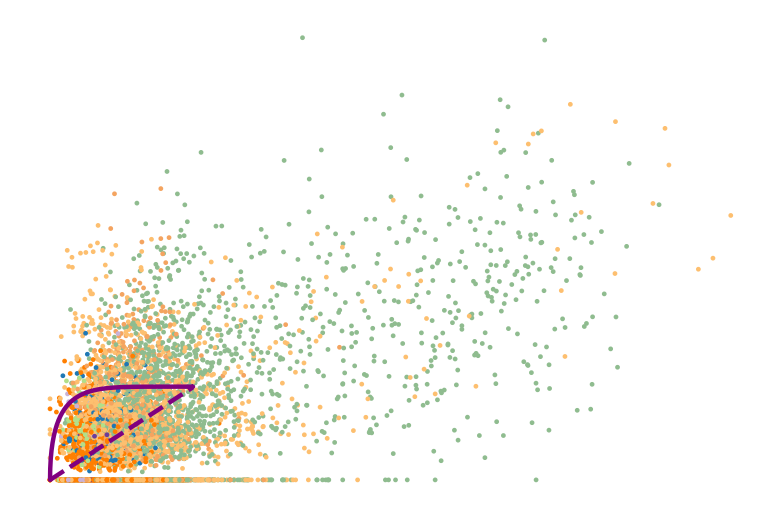

Hells


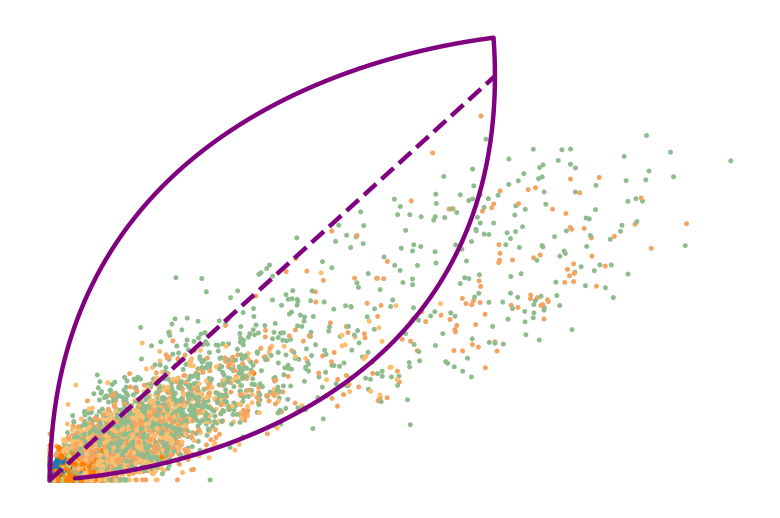

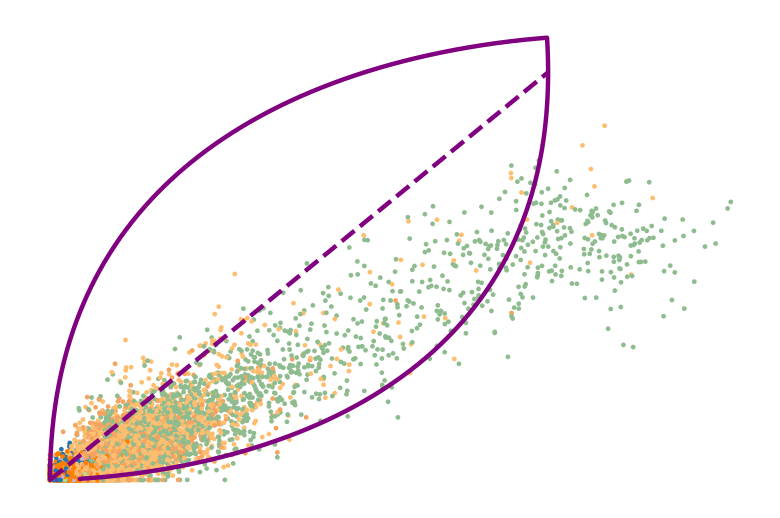

In [31]:
for gene in g2m_all + s_genes_all:
    # scRNA data
    print(gene)
    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))
        ax.axis("off")
        ax = scv.pl.scatter(
            adata_sc,
            basis=gene,
            fontsize=16,
            frameon=False,
            color="celltype",
            legend_loc=False,
            show=False,
            title="",
            ax=ax,
        )
        plot_dynamics_(adata_sc, gene, "purple", ax)
        # ax.set_xlabel("Ms")
        # ax.set_ylabel("Mu")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(
                path / f"{gene}_sc_celltype_color.png", format="png", dpi=500, transparent=True, bbox_inches="tight"
            )

    # snRNA data
    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 4))
        ax.axis("off")
        ax = scv.pl.scatter(
            adata_sn,
            basis=gene,
            fontsize=16,
            frameon=False,
            color="celltype",
            legend_loc=False,
            show=False,
            title="",
            ax=ax,
        )
        plot_dynamics_(adata_sn, gene, "purple", ax)
        # ax.set_xlabel("Ms")
        # ax.set_ylabel("Mu")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "phase_portraits"
            path.mkdir(parents=True, exist_ok=True)
            # fig.savefig(path / f"{gene}_sn.svg", format="svg", transparent=True, bbox_inches="tight")
            fig.savefig(
                path / f"{gene}_sn_celltype_color.png", format="png", dpi=500, transparent=True, bbox_inches="tight"
            )

## 2. Compare permutation scores of cycling genes

In [41]:
# Define colors for celltype and cell cycle phases
adata.uns["celltype_colors"] = celltype_colors
adata_sc.uns["celltype_colors"] = celltype_colors
adata_sn.uns["celltype_colors"] = celltype_colors

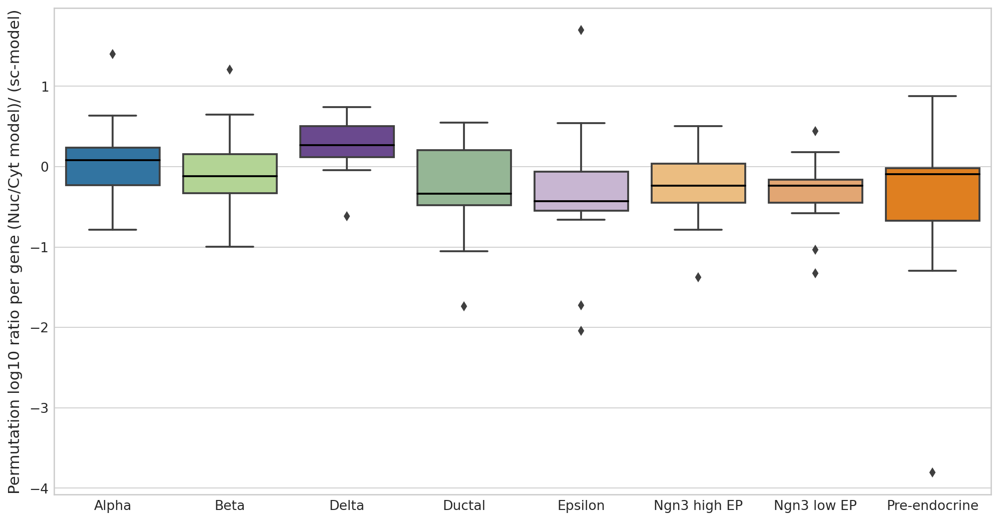

In [33]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(15, 8))
    sns.boxplot(
        data=np.log10(
            perm_scores.loc[list(g2m_all) + list(s_genes_all)] / perm_scores_sc.loc[list(g2m_all) + list(s_genes_all)]
        ),
        palette=adata.uns["celltype_colors"],
        medianprops={"color": "black"},
    )
    ax.set_ylabel("Permutation log10 ratio per gene (Nuc/Cyt model)/ (sc-model)")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "perm_scores"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "nuc_cyt_vs_sc.svg", format="svg", transparent=True, bbox_inches="tight")

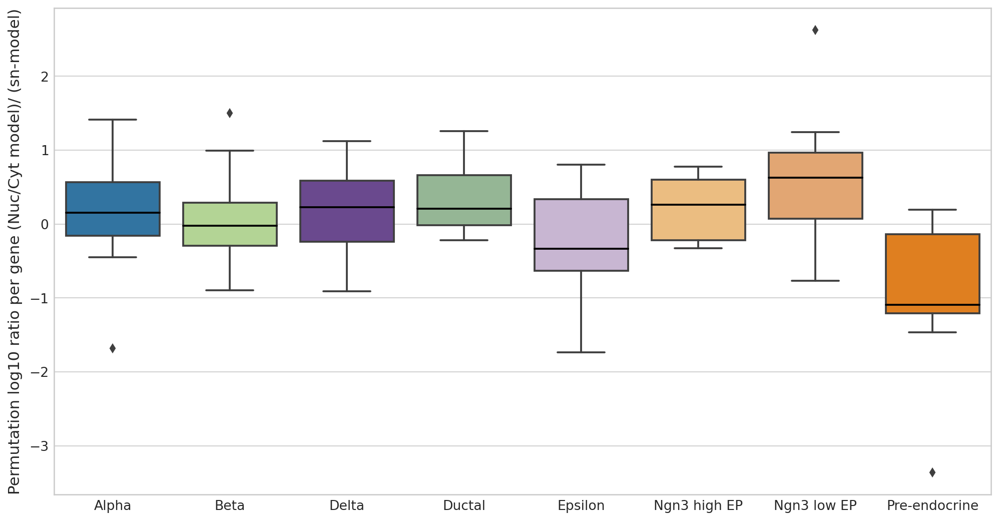

In [34]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(15, 8))
    sns.boxplot(
        data=np.log10(
            perm_scores.loc[list(g2m_all) + list(s_genes_all)] / perm_scores_sn.loc[list(g2m_all) + list(s_genes_all)]
        ),
        palette=adata.uns["celltype_colors"],
        medianprops={"color": "black"},
    )
    ax.set_ylabel("Permutation log10 ratio per gene (Nuc/Cyt model)/ (sn-model)")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "perm_scores"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "nuc_cyt_vs_sn.svg", format="svg", transparent=True, bbox_inches="tight")

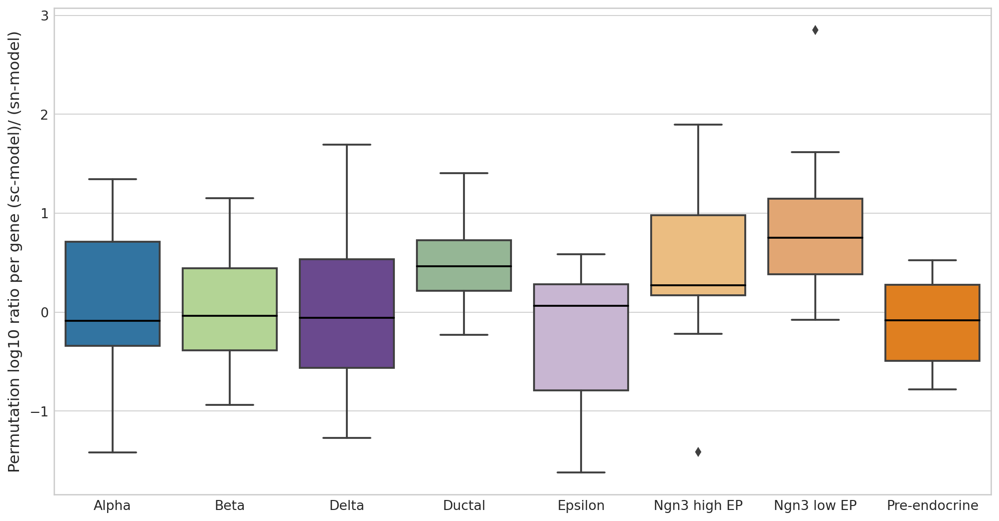

In [35]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(15, 8))
    sns.boxplot(
        data=np.log10(
            perm_scores_sc.loc[list(g2m_all) + list(s_genes_all)]
            / perm_scores_sn.loc[list(g2m_all) + list(s_genes_all)]
        ),
        palette=adata.uns["celltype_colors"],
        medianprops={"color": "black"},
    )
    ax.set_ylabel("Permutation log10 ratio per gene (sc-model)/ (sn-model)")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "perm_scores"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "sc_vs_sn.svg", format="svg", transparent=True, bbox_inches="tight")

## Permutation density: Max effect over cell types

In [36]:
full_perm_df = pd.DataFrame(columns=["Score", "Model"])
perm_dfs = [
    perm_scores.loc[list(g2m_all) + list(s_genes_all)],
    perm_scores_sc.loc[list(g2m_all) + list(s_genes_all)],
    perm_scores_sn.loc[list(g2m_all) + list(s_genes_all)],
]
names = ["Nuc/Cyt model", "sc-model", "sn-model"]
models = []
scores = []
for perm_df, model_name in zip(perm_dfs, names):
    p = perm_df.values
    max_ratio = np.nanmax(p, axis=1)
    scores += max_ratio.tolist()
    models += len(max_ratio) * [model_name]
full_perm_df["Score"] = scores
full_perm_df["Model"] = models

n_datasets = 4

full_perm_df["Model_id"] = full_perm_df["Model"].replace(dict(zip(names, range(len(names)))))

palette = dict(zip(full_perm_df["Model"].unique(), sns.color_palette("colorblind").as_hex()[:n_datasets]))

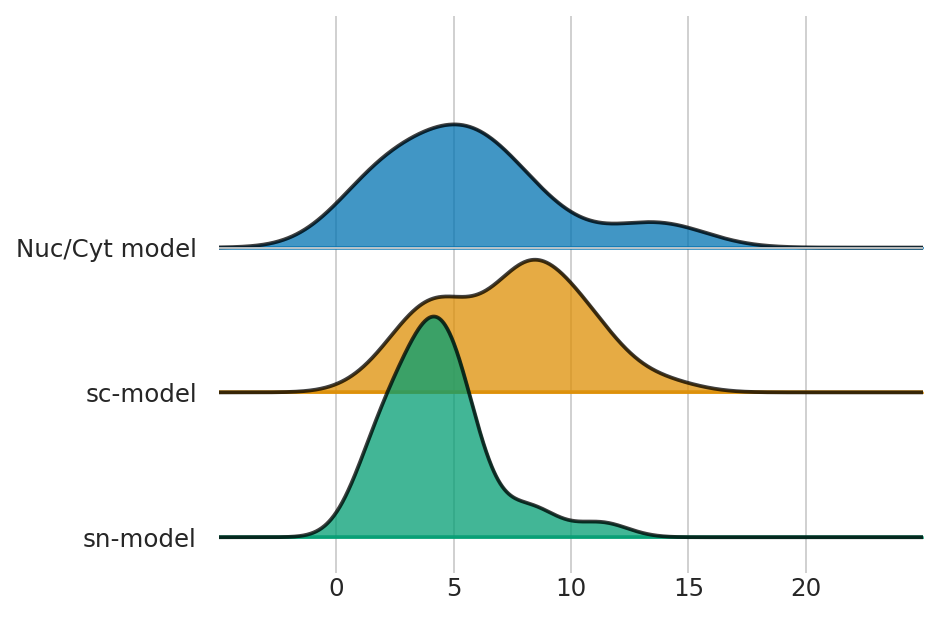

In [37]:
with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, axes = joypy.joyplot(
        full_perm_df,
        by="Model_id",
        color=[palette[model] for model in names],
        alpha=0.75,
        labels=names,
        x_range=[-5, 25],
        figsize=(6, 4),
        grid="both",
    )
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "perm_scores"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "permscores_joyplot.svg", format="svg", transparent=True, bbox_inches="tight")

## Permutation density: Ductal cell type

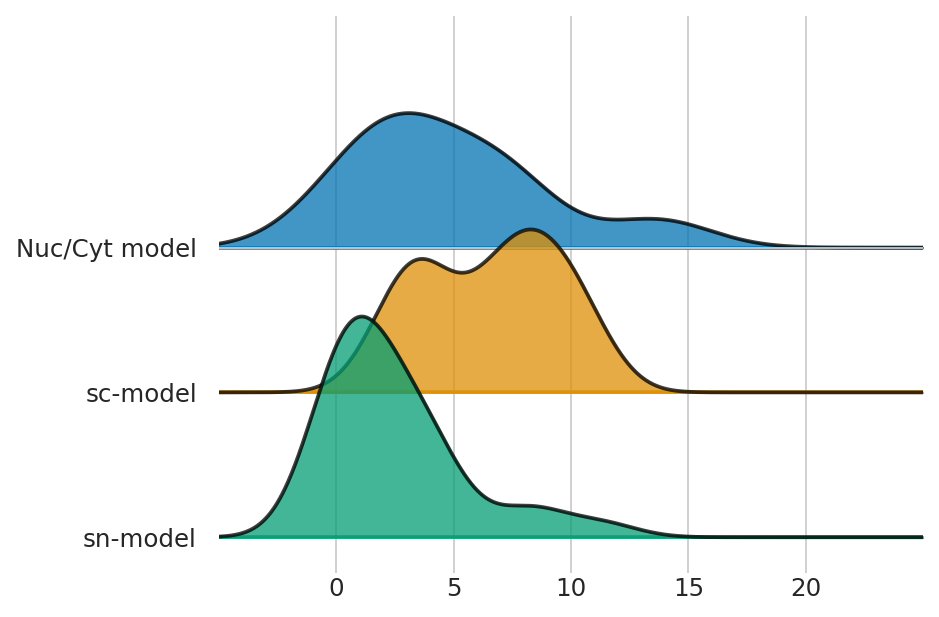

In [38]:
full_perm_df = pd.DataFrame(columns=["Score", "Model"])
perm_dfs = [
    perm_scores.loc[list(g2m_all) + list(s_genes_all)],
    perm_scores_sc.loc[list(g2m_all) + list(s_genes_all)],
    perm_scores_sn.loc[list(g2m_all) + list(s_genes_all)],
]
names = ["Nuc/Cyt model", "sc-model", "sn-model"]  # , "Multi-modal sc-model"]
models = []
scores = []
for perm_df, model_name in zip(perm_dfs, names):
    ductal_permutation = perm_df["Ductal"].values
    scores += ductal_permutation.tolist()
    models += len(ductal_permutation) * [model_name]
full_perm_df["Score"] = scores
full_perm_df["Model"] = models

n_datasets = 4

full_perm_df["Model_id"] = full_perm_df["Model"].replace(dict(zip(names, range(len(names)))))

palette = dict(zip(full_perm_df["Model"].unique(), sns.color_palette("colorblind").as_hex()[:n_datasets]))

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, axes = joypy.joyplot(
        full_perm_df,
        by="Model_id",
        color=[palette[model] for model in names],
        alpha=0.75,
        labels=names,
        x_range=[-5, 25],
        figsize=(6, 4),
        grid="both",
    )
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "perm_scores"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "permscores_joyplot_ductal.svg", format="svg", transparent=True, bbox_inches="tight")

#### 3. Use Cellrank to get transition probabilities (Complete phase portraits)
We now want to investigate phase transition probabilities of cells, e.g. we want to find probabilities of $P(G1 \rightarrow S)$, $P(S \rightarrow G2M)$, $P(G2M \rightarrow G1)$

  0%|          | 0/3387 [00:00<?, ?cell/s]

  0%|          | 0/3387 [00:00<?, ?cell/s]

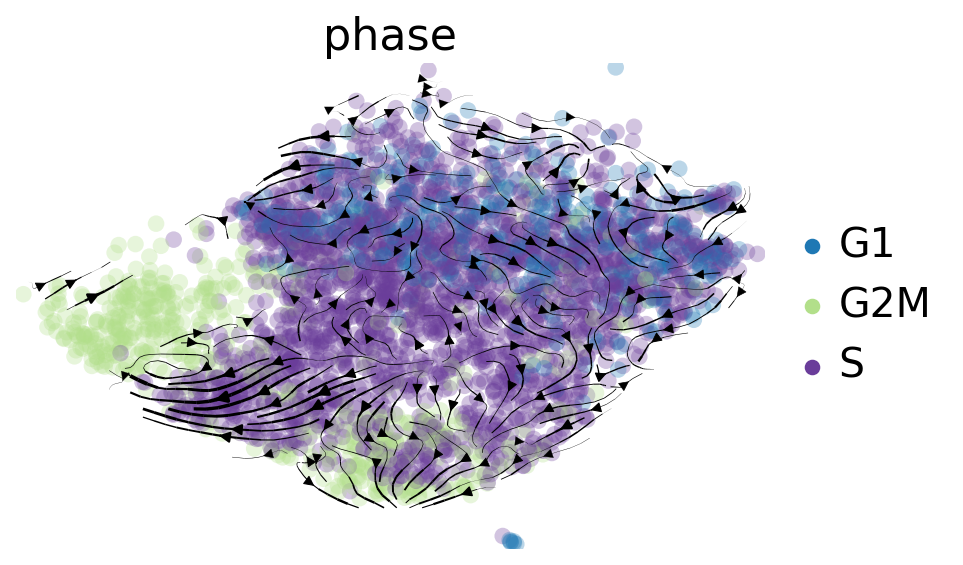

In [43]:
adata_ductal = adata[adata.obs.celltype == "Ductal", :].copy()
sc.pp.neighbors(adata_ductal, n_neighbors=20, use_rep="X_glue_gex")

vk = cr.kernels.VelocityKernel(
    adata_ductal, vkey="velocities_velovi_s_nuc", xkey="Ms_nuc", gene_subset=list(g2m_all) + list(s_genes_all)
)
vk.compute_transition_matrix()

vk.plot_projection(color="phase", legend_loc="right margin")

vk.write_to_adata()

  0%|          | 0/3387 [00:00<?, ?cell/s]

  0%|          | 0/3387 [00:00<?, ?cell/s]

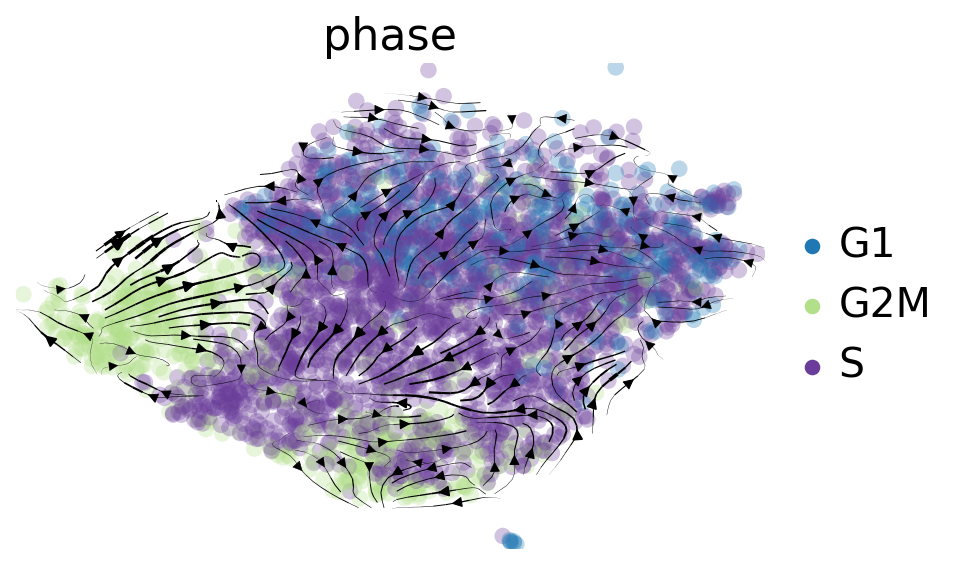

In [44]:
adata_ductal_sum = adata[adata.obs.celltype == "Ductal", :].copy()
sc.pp.neighbors(adata_ductal_sum, n_neighbors=20, use_rep="X_glue_gex")

vk = cr.kernels.VelocityKernel(
    adata_ductal_sum, vkey="velocities_velovi_s_sum", xkey="Ms_sum", gene_subset=list(g2m_all) + list(s_genes_all)
)
vk.compute_transition_matrix()

vk.plot_projection(color="phase", legend_loc="right margin")

vk.write_to_adata()

  0%|          | 0/1517 [00:00<?, ?cell/s]

  0%|          | 0/1517 [00:00<?, ?cell/s]

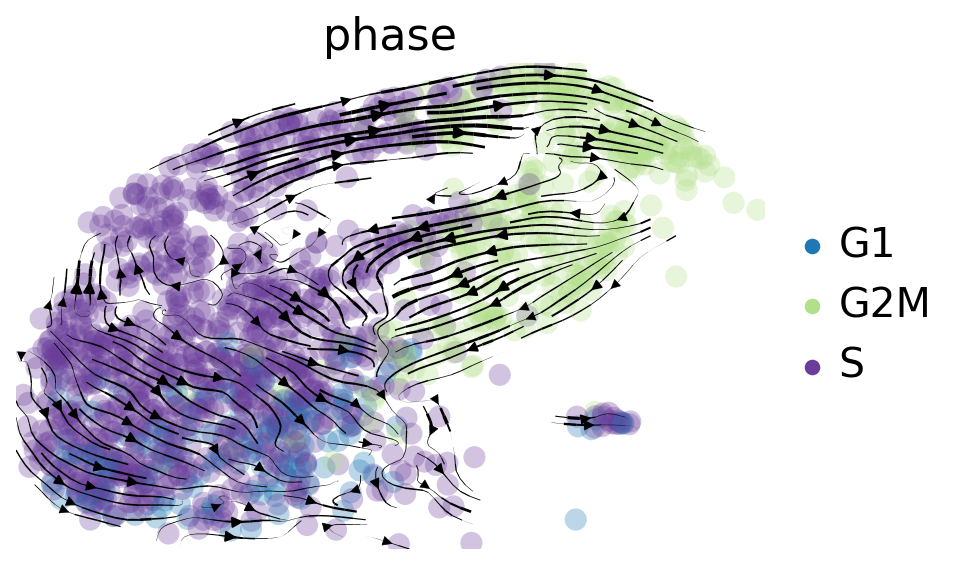

In [45]:
adata_ductal_sc = adata_sc[adata_sc.obs.celltype == "Ductal"].copy()
sc.pp.neighbors(adata_ductal_sc, n_neighbors=20)
# vk = cr.kernels.VelocityKernel(adata_ductal_sc, vkey="velocities_velovi", xkey="Ms", gene_subset=list(s_genes_sc)+list(g2m_genes_sc))
vk = cr.kernels.VelocityKernel(
    adata_ductal_sc, vkey="velocities_velovi", xkey="Ms", gene_subset=list(g2m_all) + list(s_genes_all)
)
vk.compute_transition_matrix(n_jobs=1)

vk.plot_projection(color="phase", legend_loc="right margin")

vk.write_to_adata()

  0%|          | 0/1871 [00:00<?, ?cell/s]

  0%|          | 0/1871 [00:00<?, ?cell/s]

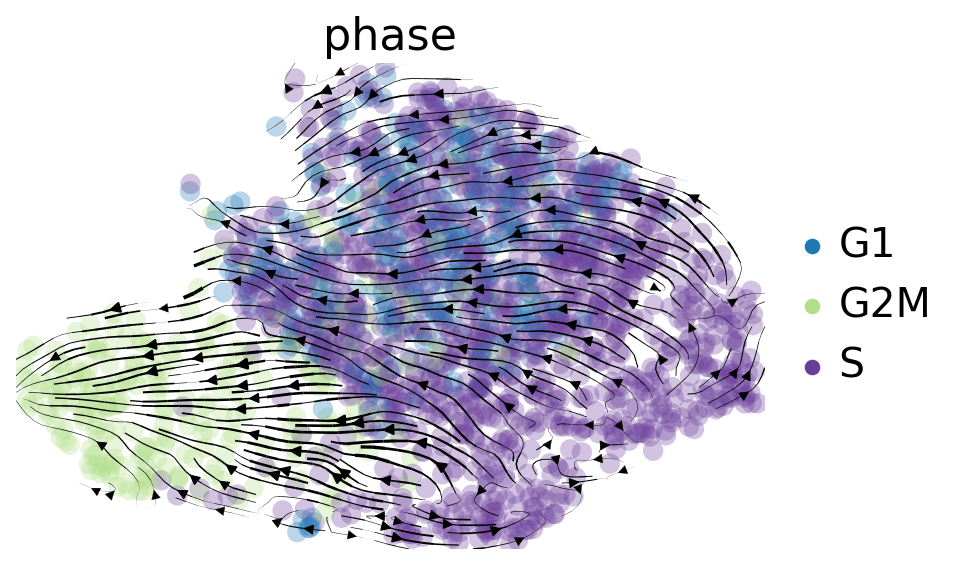

In [46]:
adata_ductal_sn = adata_sn[adata_sn.obs.celltype == "Ductal", :].copy()
sc.pp.neighbors(adata_ductal_sn, n_neighbors=20)

vk = cr.kernels.VelocityKernel(
    adata_ductal_sn, vkey="velocities_velovi", xkey="Ms", gene_subset=list(g2m_all) + list(s_genes_all)
)
vk.compute_transition_matrix()

vk.plot_projection(color="phase", legend_loc="right margin")

vk.write_to_adata()

#### Investigate transition probabilities

In [48]:
adatas = [adata_ductal, adata_ductal_sum, adata_ductal_sc, adata_ductal_sn]
model_names = ["Nuc/Cyt model", "Nuc/Cyt model (s_sum)", "sc-model", "sn-model"]
probs_dfs, count_dfs = get_transit_probs_counts_cycle(adatas, model_names)

#### Heatmap

In [49]:
transit_df = probs_dfs.groupby(["Target phase", "Phase from", "Model"], as_index=False).mean("Probability")
transit_df_nuc_cyt = transit_df[transit_df.Model == "Nuc/Cyt model"].pivot(
    index="Phase from", columns="Target phase", values="Probability"
)
transit_df_nuc_cyt_sum = transit_df[transit_df.Model == "Nuc/Cyt model (s_sum)"].pivot(
    index="Phase from", columns="Target phase", values="Probability"
)
transit_df_sc = transit_df[transit_df.Model == "sc-model"].pivot(
    index="Phase from", columns="Target phase", values="Probability"
)
transit_df_sn = transit_df[transit_df.Model == "sn-model"].pivot(
    index="Phase from", columns="Target phase", values="Probability"
)


column_order = ["G1", "S", "G2M"]
transit_df_nuc_cyt = transit_df_nuc_cyt.reindex(column_order, axis=1)
transit_df_nuc_cyt = transit_df_nuc_cyt.reindex(column_order, axis=0)

transit_df_nuc_cyt_sum = transit_df_nuc_cyt_sum.reindex(column_order, axis=1)
transit_df_nuc_cyt_sum = transit_df_nuc_cyt_sum.reindex(column_order, axis=0)

transit_df_sc = transit_df_sc.reindex(column_order, axis=1)
transit_df_sc = transit_df_sc.reindex(column_order, axis=0)

transit_df_sn = transit_df_sn.reindex(column_order, axis=1)
transit_df_sn = transit_df_sn.reindex(column_order, axis=0)

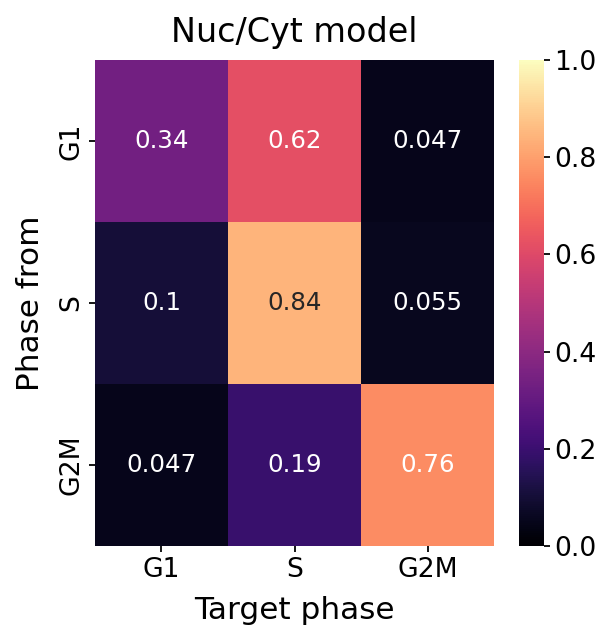

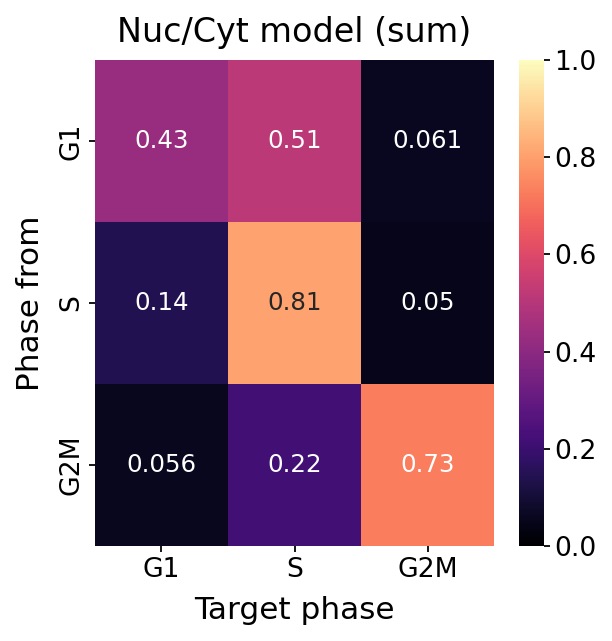

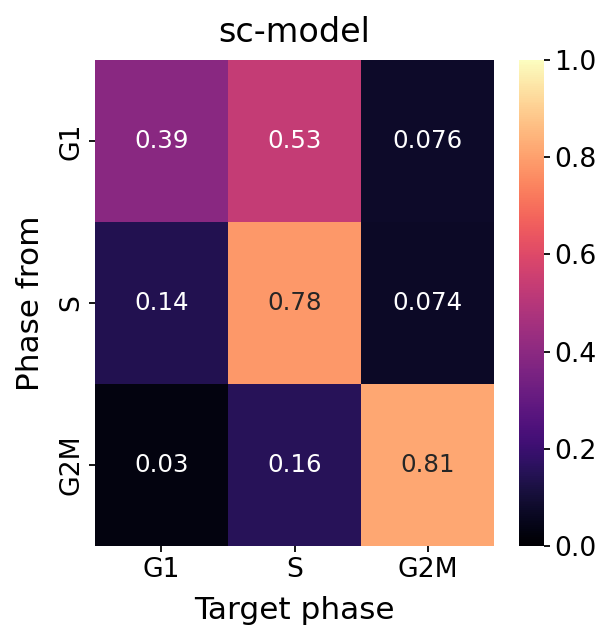

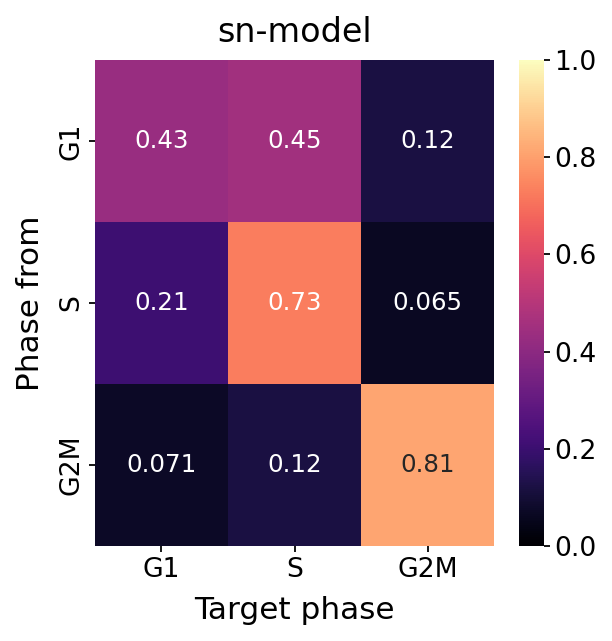

In [51]:
with mplscience.style_context():
    fig, ax = plt.subplots()
    sns.heatmap(transit_df_nuc_cyt, cmap="magma", annot=True, ax=ax, vmin=0, vmax=1)
    plt.title("Nuc/Cyt model")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "heatmap"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "heatmap_nuc_cyt.svg", format="svg", transparent=True, bbox_inches="tight")

with mplscience.style_context():
    fig, ax = plt.subplots()
    sns.heatmap(transit_df_nuc_cyt_sum, cmap="magma", annot=True, ax=ax, vmin=0, vmax=1)
    plt.title("Nuc/Cyt model (sum)")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "heatmap"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "heatmap_nuc_cyt_sum.svg", format="svg", transparent=True, bbox_inches="tight")


with mplscience.style_context():
    fig, ax = plt.subplots()
    sns.heatmap(transit_df_sc, cmap="magma", annot=True, ax=ax, vmin=0, vmax=1)
    plt.title("sc-model")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "heatmap"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "heatmap_sc.svg", format="svg", transparent=True, bbox_inches="tight")

with mplscience.style_context():
    fig, ax = plt.subplots()
    sns.heatmap(transit_df_sn, cmap="magma", annot=True, ax=ax, vmin=0, vmax=1)
    plt.title("sn-model")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "heatmap"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "heatmap_sn.svg", format="svg", transparent=True, bbox_inches="tight")

#### Boxplots/ Violinplots of transition probabilities

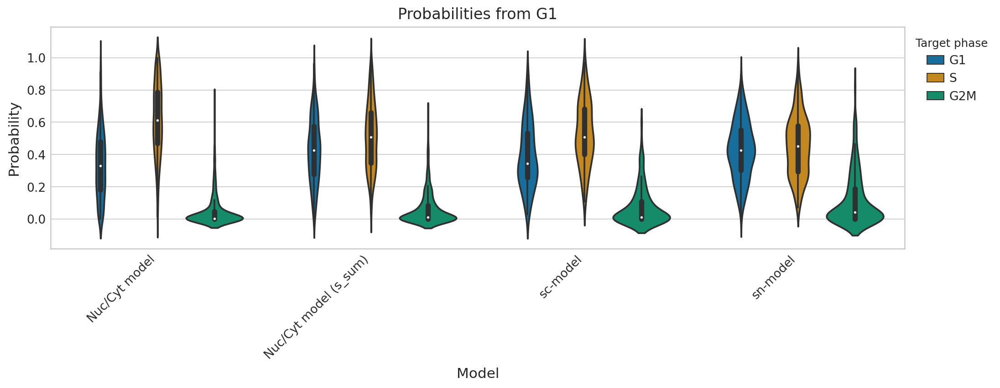

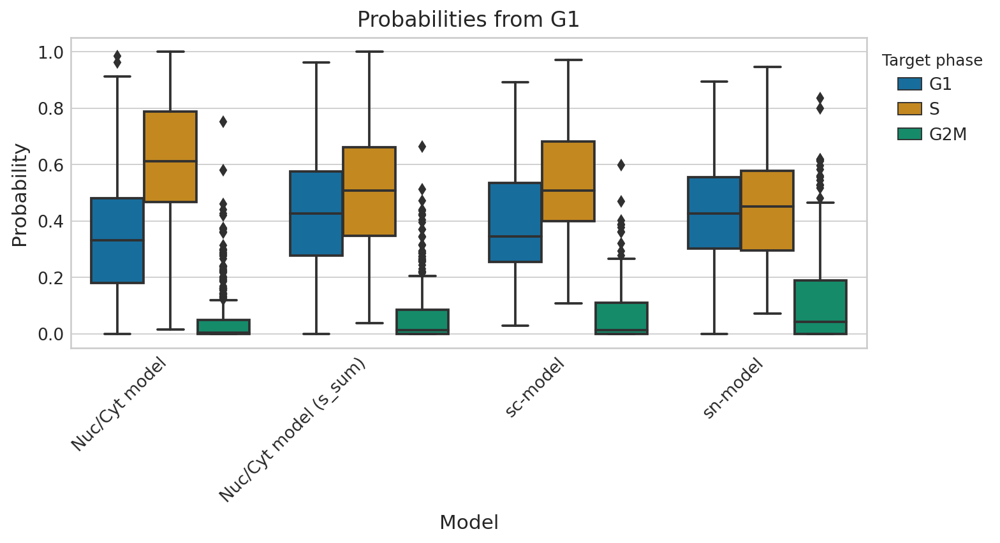

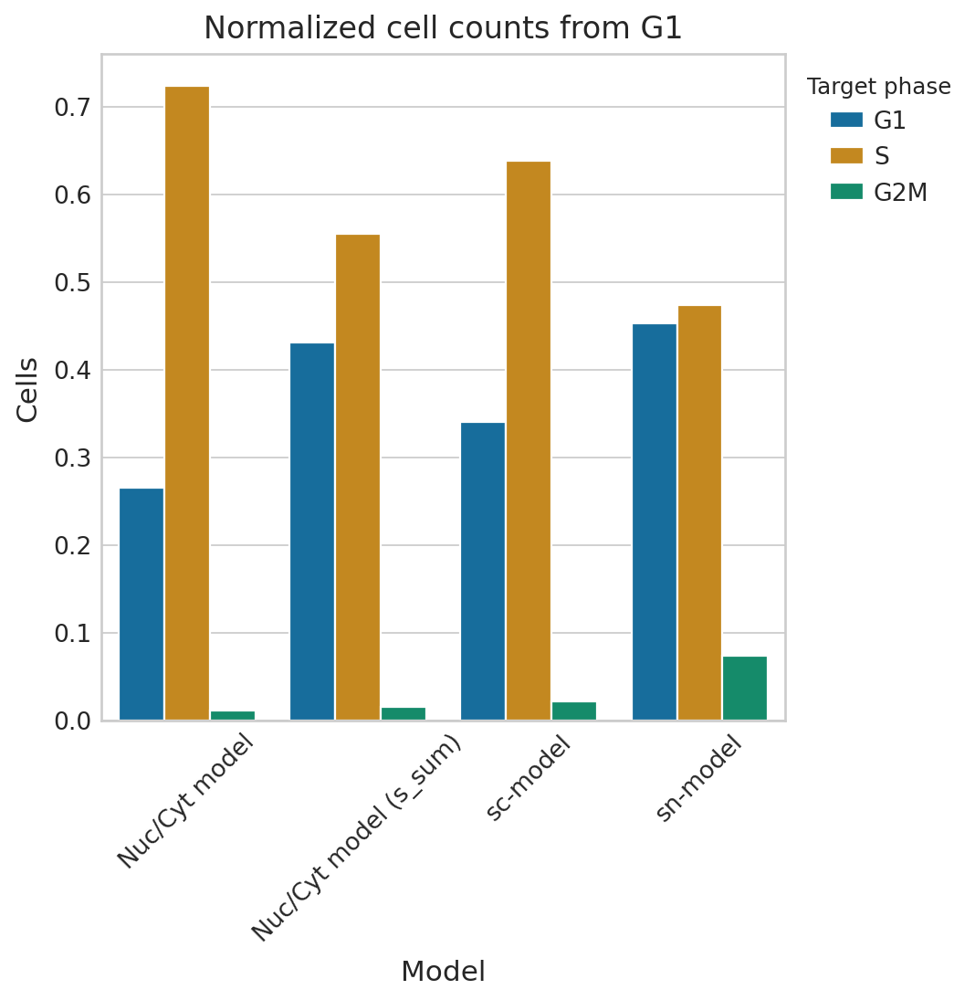

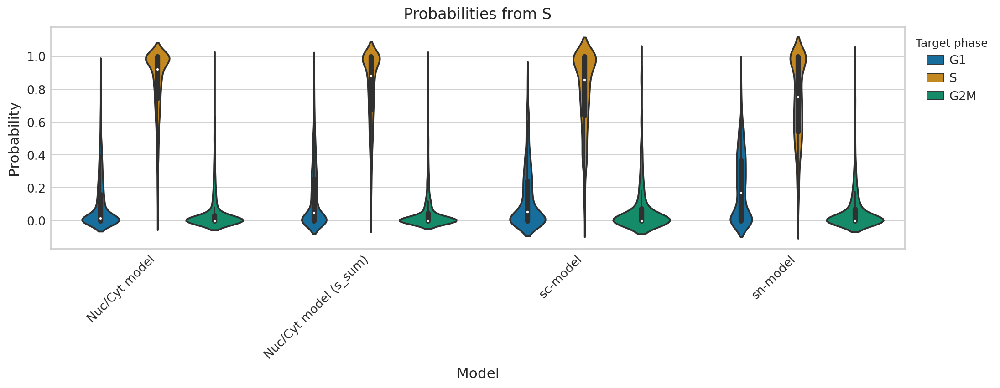

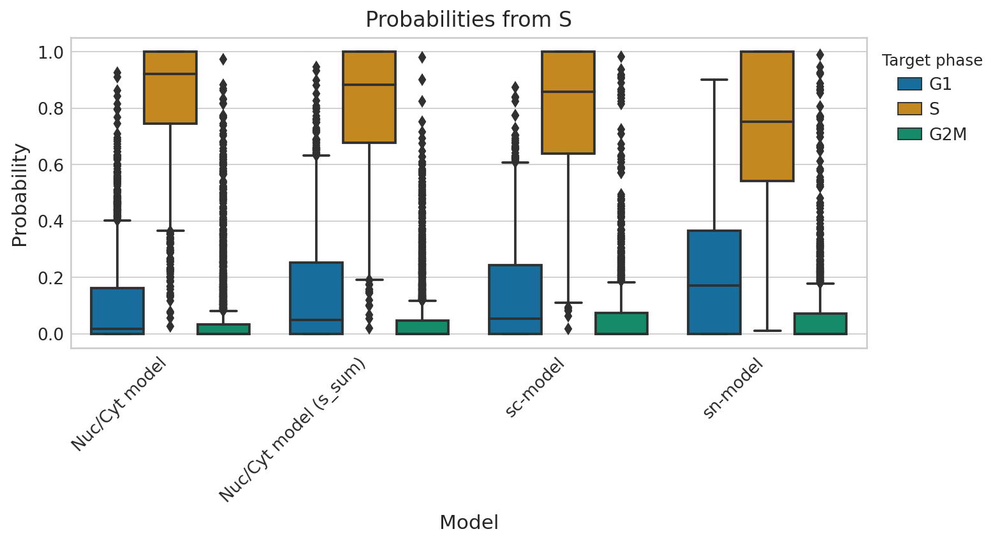

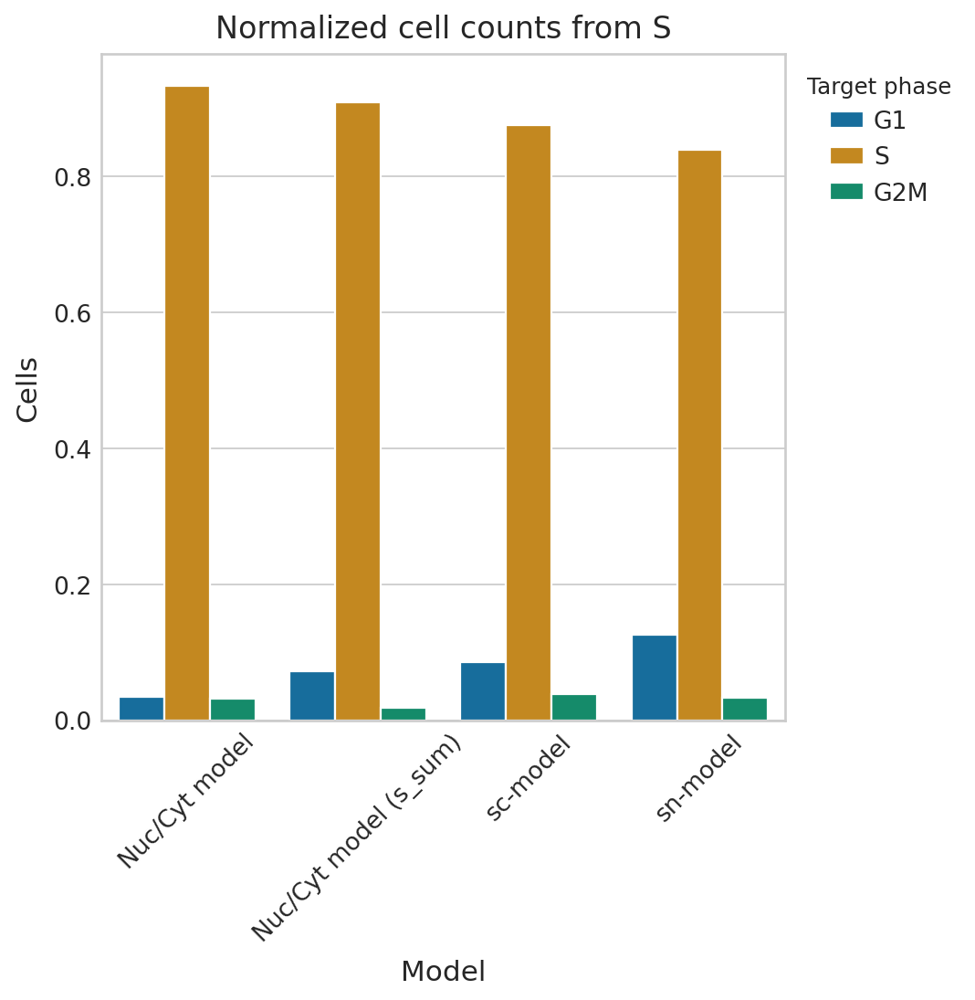

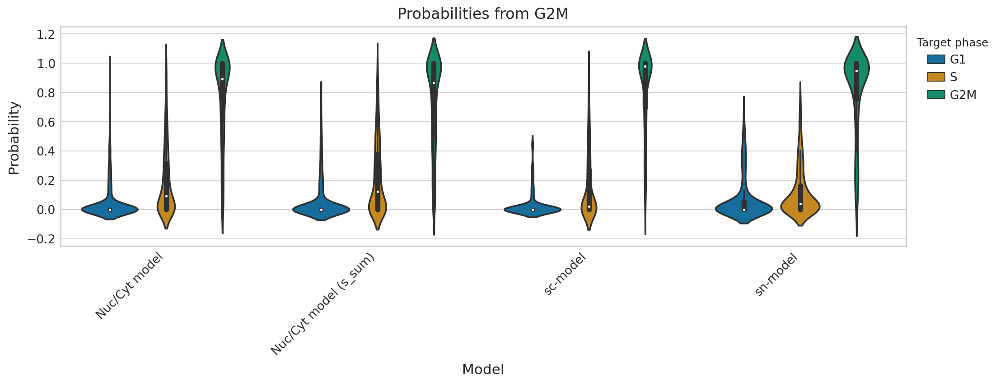

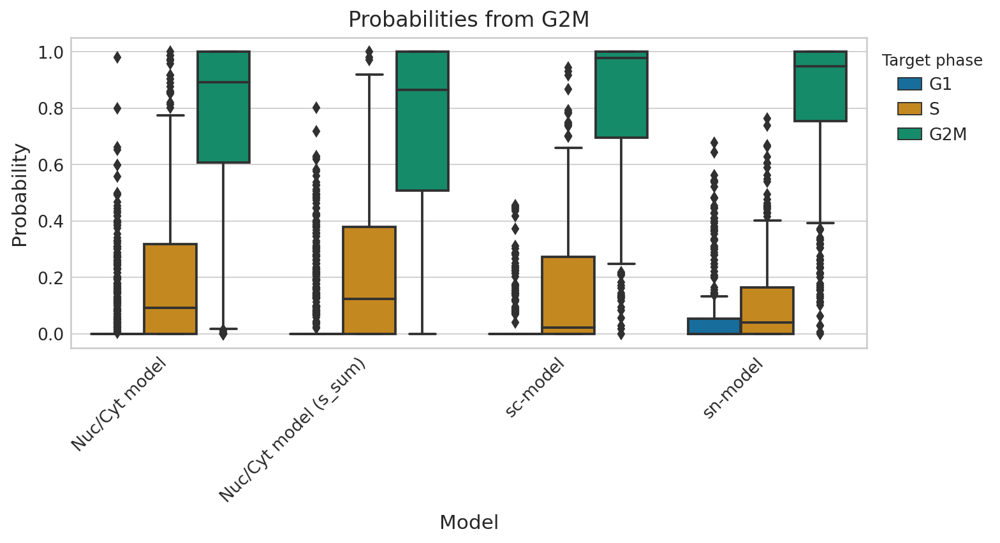

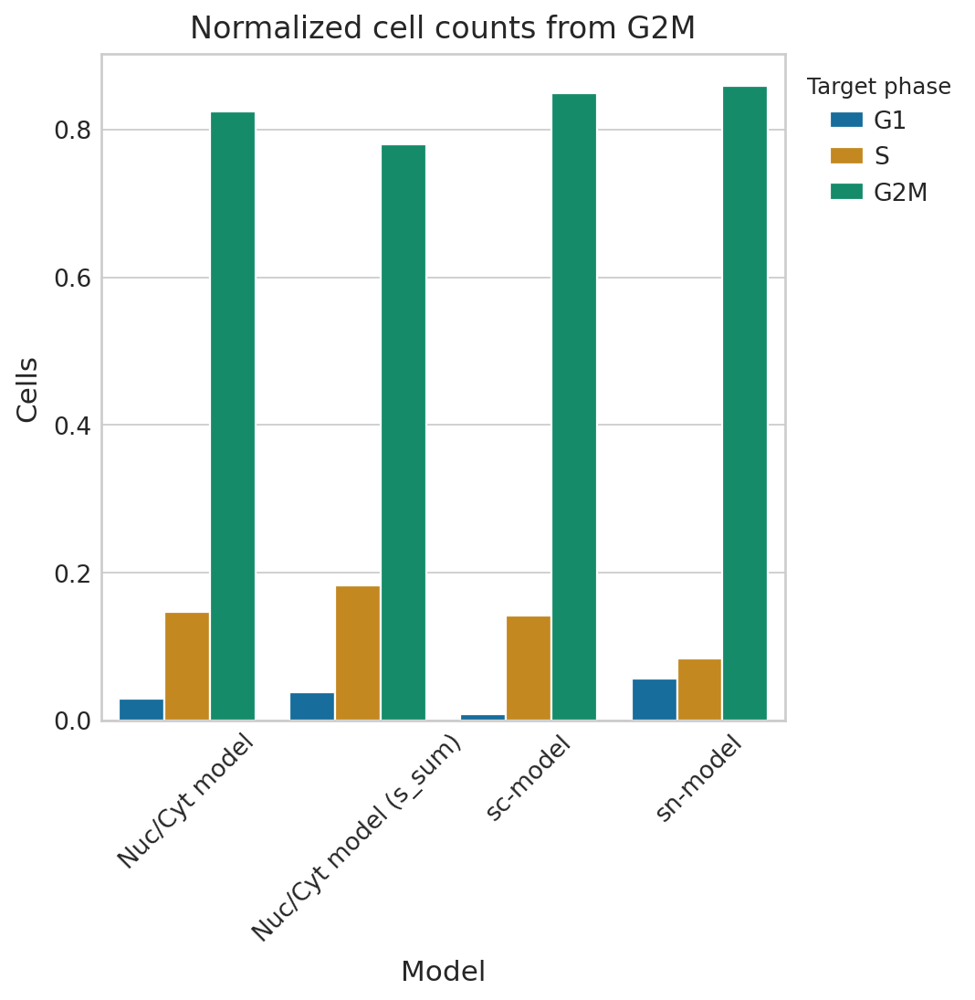

In [52]:
for phase in ["G1", "S", "G2M"]:
    # Violinplot
    with mplscience.style_context():
        sns.set_style(style="whitegrid")

        fig, ax = plt.subplots(figsize=(15, 4))
        sns.violinplot(
            data=probs_dfs[probs_dfs["Phase from"] == phase],
            orient="v",
            ax=ax,
            x="Model",
            y="Probability",
            hue="Target phase",
            palette=sns.color_palette("colorblind").as_hex()[:3],
        )
        plt.title(f"Probabilities from {phase}")
        sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
        plt.xticks(rotation=45, ha="right")
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "transition_probs"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(path / f"{phase}_transit_probs_violin.svg", format="svg", transparent=True, bbox_inches="tight")

    # Boxplot
    with mplscience.style_context():
        sns.set_style(style="whitegrid")

        fig, ax = plt.subplots(figsize=(10, 4))

        sns.boxplot(
            data=probs_dfs[probs_dfs["Phase from"] == phase],
            x="Model",
            y="Probability",
            hue="Target phase",
            palette=sns.color_palette("colorblind").as_hex()[:3],
        )
        plt.title(f"Probabilities from {phase}")
        plt.xticks(rotation=45, ha="right")
        sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
        plt.show()
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "transition_probs"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(
                path / f"{phase}_transit_probs_boxplot.svg", format="svg", transparent=True, bbox_inches="tight"
            )

    # barplot of counts
    with mplscience.style_context():
        sns.set_style(style="whitegrid")
        fig, ax = plt.subplots(figsize=(6, 6))
        sns.barplot(
            data=count_dfs[count_dfs["Phase from"] == phase],
            y="Cells",
            x="Model",
            hue="Target phase",
            palette=sns.color_palette("colorblind").as_hex()[:3],
            ax=ax,
        )
        sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
        plt.title(f"Normalized cell counts from {phase}")
        ax.tick_params(axis="x", rotation=45)
        if SAVE_FIGURES:
            path = FIG_DIR / "cell_cycle_analysis" / "transition_probs"
            path.mkdir(parents=True, exist_ok=True)
            fig.savefig(
                path / f"{phase}_transit_probs_barplot.svg", format="svg", transparent=True, bbox_inches="tight"
            )

## Compare inferred velocities for cell cycle genes between models

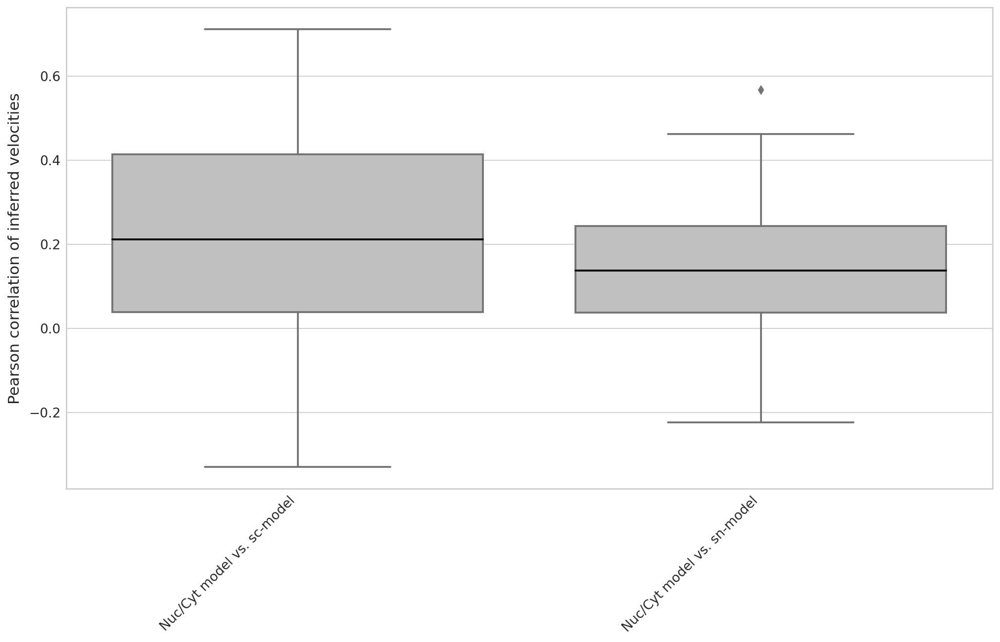

In [53]:
pearson_dfs = pd.DataFrame(columns=["Pearson correlation"])
pearson_coeffs_sc_nuc_cyt = []
pearson_coeffs_sn_nuc_cyt = []

for gene in s_genes_all + g2m_all:
    pearson_coeffs_sc_nuc_cyt.append(
        pearsonr(
            adata[sc_cells, gene].layers["velocities_velovi_s_nuc"].squeeze(),
            adata_sc[sc_cells, gene].layers["velocities_velovi"].squeeze(),
        )[0]
    )

    pearson_coeffs_sn_nuc_cyt.append(
        pearsonr(
            adata[sn_cells, gene].layers["velocities_velovi_s_nuc"].squeeze(),
            adata_sn[sn_cells, gene].layers["velocities_velovi"].squeeze(),
        )[0]
    )


pearson_df = pd.DataFrame()
pearson_df["Nuc/Cyt model vs. sc-model"] = pearson_coeffs_sc_nuc_cyt
pearson_df["Nuc/Cyt model vs. sn-model"] = pearson_coeffs_sn_nuc_cyt

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(15, 8))
    sns.boxplot(
        data=pearson_df,
        color="silver",
        medianprops={"color": "black"},
    )
    ax.set_ylabel("Pearson correlation of inferred velocities")
    plt.xticks(rotation=45, ha="right")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "correlation_cylce_genes"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "velo_correlation_cycle_s_nuc.svg", format="svg", transparent=True, bbox_inches="tight")

s sum velocity

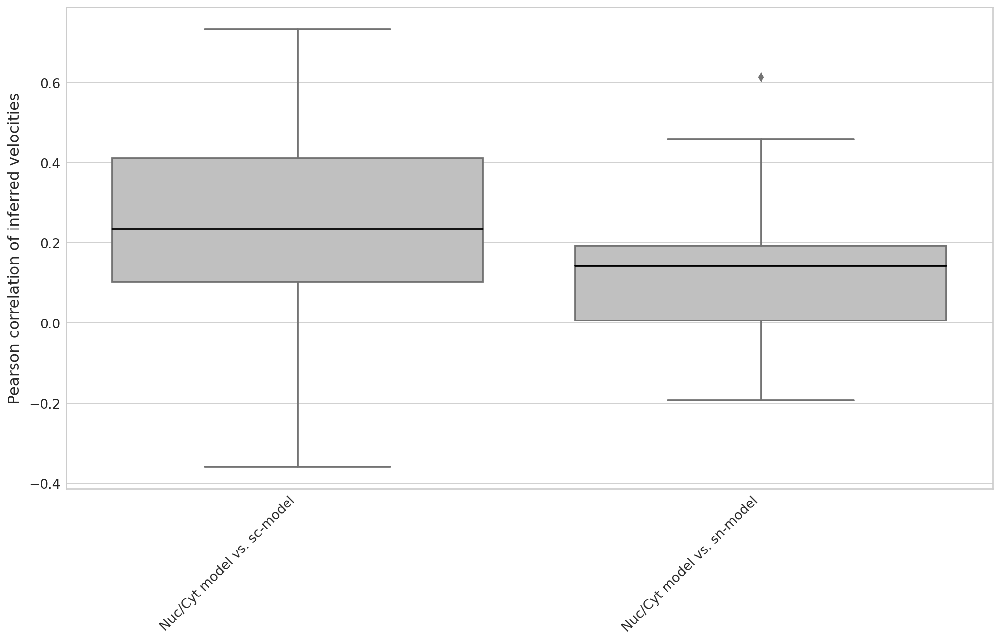

In [54]:
pearson_dfs = pd.DataFrame(columns=["Pearson correlation"])
pearson_coeffs_sc_nuc_cyt = []
pearson_coeffs_sn_nuc_cyt = []

for gene in s_genes_all + g2m_all:
    pearson_coeffs_sc_nuc_cyt.append(
        pearsonr(
            adata[sc_cells, gene].layers["velocities_velovi_s_sum"].squeeze(),
            adata_sc[sc_cells, gene].layers["velocities_velovi"].squeeze(),
        )[0]
    )

    pearson_coeffs_sn_nuc_cyt.append(
        pearsonr(
            adata[sn_cells, gene].layers["velocities_velovi_s_sum"].squeeze(),
            adata_sn[sn_cells, gene].layers["velocities_velovi"].squeeze(),
        )[0]
    )


pearson_df = pd.DataFrame()
pearson_df["Nuc/Cyt model vs. sc-model"] = pearson_coeffs_sc_nuc_cyt
pearson_df["Nuc/Cyt model vs. sn-model"] = pearson_coeffs_sn_nuc_cyt

with mplscience.style_context():
    sns.set_style(style="whitegrid")
    fig, ax = plt.subplots(figsize=(15, 8))
    sns.boxplot(
        data=pearson_df,
        color="silver",
        medianprops={"color": "black"},
    )
    ax.set_ylabel("Pearson correlation of inferred velocities")
    plt.xticks(rotation=45, ha="right")
    plt.show()
    if SAVE_FIGURES:
        path = FIG_DIR / "cell_cycle_analysis" / "correlation_cylce_genes"
        path.mkdir(parents=True, exist_ok=True)
        fig.savefig(path / "velo_correlation_cycle_s_nuc.svg", format="svg", transparent=True, bbox_inches="tight")